In [1]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.colors as mplc
from matplotlib.lines import Line2D
from matplotlib.colors import Normalize, LinearSegmentedColormap
from matplotlib.ticker import LogFormatter
from matplotlib.ticker import ScalarFormatter
import matplotlib.patches as mpatches
import matplotlib.colors as mcolors
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
%matplotlib inline
import seaborn as sns
import os
import random
import pyreadr
import csv


import matplotlib.patches as mpatches

from mpl_toolkits.basemap import Basemap

from scipy.stats import gaussian_kde, binned_statistic
from scipy.stats import skew, kurtosis


# import descartes
import geopandas as gpd
import geodatasets
from shapely.geometry import Point, Polygon
import shapely.geometry
from scipy.optimize import curve_fit
from sklearn.metrics import mean_absolute_error
import osmnx as ox
import pickle

import folium

from scipy.stats import gaussian_kde
from scipy.stats import binned_statistic
from sklearn.linear_model import LinearRegression
from scipy.optimize import curve_fit
from sklearn.metrics import r2_score, mean_squared_error
from scipy.integrate import simps
from scipy import interpolate
import statsmodels.api as sm
import scipy.stats as stats

from meteostat import Point, Daily


%matplotlib inline

import networkx as nx
import collections

import rioxarray

import warnings
warnings.filterwarnings('ignore')


import os


# Define the power-law function
def power_law(x, a, b):
    return a * np.power(x, b)

# Define the linear function
def linear(x, a, b):
    return a + b * x

In [2]:
#STEP RESOLUTION DEGREES TO meters

from math import radians, cos, sin, asin, sqrt

def haversine(lon1, lat1, lon2, lat2):

    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371000 # Radius of earth in meters
    return c * r 

haversine(1,1,1.01,1)

1111.779911186028

# INFORMATION

In [3]:
net_type = 'drive'

In [4]:
T_type = 'mean'
# T_type = 'max'
# T_type = 'max_LST'

In [55]:
POPULATION = 'no' # if 'yes' - we remove grid cells where there is 0 population values as well

In [56]:
PM = '25'

# CITIES

In [57]:
cities = [
    'Barcelona', 'Montpellier', 'Rome', 'Naples', 'Porto', 'Sevilla', 'Alicante', 'Valencia', 'Bologna', 'Padua', 'Turin',
    'Madrid', 'Murcia', 'Genoa', 'Milan', 'Lisbon', 'Palma_de_Mallorca', 'Split','Marseille', 'Palermo','Nice', 'Malaga', 'Bari', 

    'Antwerp', 'Amsterdam', 'Brussels', 'London', 'Paris', 'Luxembourg', 'Rotterdam', 'Lille', 'Basel', 'Birmingham', 'Nantes', 'Strasbourg',
    'Zurich', 'Frankfurt', 'Vienna', 'Munich', 'Bratislava', 'Prague', 'Geneva', 'Bordeaux', 'Utrecht', 
    'Liege', 'Bilbao', 'Charleroi', 'Wroclaw', 'Leipzig', 'Berlin', 'Hamburg', 'Lodz', 'Warsaw', 'Edinburgh', 
    'Glasgow', 'Cologne', 'Dusseldorf', 'Newcastle', 'Ghent', 'Dublin', 'Toulouse', 'Leeds', 'Lyon',

    'Tallinn','Reykjavik', 'Copenhagen', 'Goteborg', 'Helsinki', 'Stockholm', 'Oslo', 'Tartu', 'Riga', 'Klaipeda', 'Vilnius', 'Gdansk',

    'Sofia', 'Zagreb', 'Budapest', 'Szeged', 'Brasov', 'Bucharest', 'Ljubljana', 'Sarajevo', 'Gyor','Thessaloniki','Debrecen','Belgrado', 'Podgorica',
    'Trieste', 'Miskolc', 'Kosice', 'Krakow', 'Pecs', 'Varna', 'Skopje', 'Novi_Sad', 'Graz', 'Athens', 'Tirana', 'Cluj_Napoca', 
    
    'Accra', 'Addis_Abeba', 'Amman', 'Auckland', 'Bogota', 'Buenos_Aires', 'Cairo', 'Cape_Town', 'Chennai', 'Curitiba', 'Dakar', 'Dhaka', 'Dubai', 
    'Ho_Chi_Minh', 'Hong_Kong', 'Houston', 'Islamabad', 'Istanbul', 'Jakarta', 'Karachi', 'Lagos', 'Lima', 'Los_Angeles', 'Marrakesh', 'Medina', 
    'Melbourne', 'Mexico_City', 'Mogadishu', 'Moscow', 'Nairobi', 'Nanjing', 'New_York', 'Phoenix', 'Rabat', 'Salvador', 'Santiago', 'Singapore', 
    'Sydney', 'Teheran', 'Tokyo', 'Toronto', 'Tschwane']

In [58]:
len(cities)

142

# PLOT COLORS

In [59]:
colormap = plt.cm.Paired  
colors = [colormap(i) for i in np.linspace(0, 1,len(cities))]

# OPEN STREET NETWORK, POPULATION AND TEMPERATURE (binning)

In [60]:
size = '1000'
SIZE = 1000
cell_size_meters = 1000

In [61]:
# OPEN MERGE T AND POPULATION CSV FILES

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL\dataframes_2') 

pop_T_NETWORK_dic = {}

for city in cities:
    
    pop_T_NETWORK_dic[city] = pd.read_csv(city+'_pop_T'+T_type+'_PM'+PM+'_NETWORK_'+size+'.csv')

    if 'population' in pop_T_NETWORK_dic[city].columns:
            pop_T_NETWORK_dic[city].rename(columns={'population': 'popu'}, inplace=True)


In [62]:
for city in cities:

    pop_T_NETWORK_dic[city].replace([np.inf, -np.inf], np.nan, inplace=True)

    pop_T_NETWORK_dic[city] = pop_T_NETWORK_dic[city].dropna(subset=['T']).reset_index(drop=True) # specific column
    pop_T_NETWORK_dic[city] = pop_T_NETWORK_dic[city].dropna(subset=['node']).reset_index(drop=True)
    pop_T_NETWORK_dic[city] = pop_T_NETWORK_dic[city].dropna(subset=['PM'+PM]).reset_index(drop=True)


if POPULATION == 'yes':
    for city in cities:
        pop_T_NETWORK_dic[city] = pop_T_NETWORK_dic[city][pop_T_NETWORK_dic[city]['popu'] > 0] # avoid prblems when applying logn and logp --> represent 2-3% of the data points

# RESCALED DISTANCE

# OPEN RURAL TEMPERATURE and PM

In [63]:
# OPEN MERGE T AND POPULATION CSV FILES

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL\dataframes_2') 

OUTSIDE_TEMP_dic = {}

for city in cities:

    OUTSIDE_TEMP_dic[city] = pd.read_csv(city+'_pop_T'+T_type+'_PM'+PM+'_NETWORK_1000.csv')

    OUTSIDE_TEMP_dic[city].replace([np.inf, -np.inf], np.nan, inplace=True)
    OUTSIDE_TEMP_dic[city] = OUTSIDE_TEMP_dic[city].dropna(subset=['T']).reset_index(drop=True)
    OUTSIDE_TEMP_dic[city] = OUTSIDE_TEMP_dic[city][OUTSIDE_TEMP_dic[city]['node'] == 1]
    

In [64]:
# OPEN MERGE T AND POPULATION CSV FILES

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL\dataframes_2') 

OUTSIDE_PM_dic = {}

for city in cities:

    OUTSIDE_PM_dic[city] = pd.read_csv(city+'_pop_T'+T_type+'_PM'+PM+'_NETWORK_1000.csv')

    OUTSIDE_PM_dic[city].replace([np.inf, -np.inf], np.nan, inplace=True)
    OUTSIDE_PM_dic[city] = OUTSIDE_PM_dic[city].dropna(subset=['PM'+PM]).reset_index(drop=True)
    OUTSIDE_PM_dic[city] = OUTSIDE_PM_dic[city][OUTSIDE_PM_dic[city]['node'].isna()]

# deltaT and deltaPM CALCULATION

In [65]:
for city in cities:
    pop_T_NETWORK_dic[city]['deltaT'] = pop_T_NETWORK_dic[city]['T'] - OUTSIDE_TEMP_dic[city]['T'].mean()

In [66]:
for city in cities:
    pop_T_NETWORK_dic[city]['deltaPM'+PM] = pop_T_NETWORK_dic[city]['PM'+PM] - OUTSIDE_PM_dic[city]['PM'+PM].mean()

# LOG LINEAR FIT MODEL

In [67]:
# REAL DATA

for city in cities:

    pop_T_NETWORK_dic[city]['logpopu'] = np.log(pop_T_NETWORK_dic[city]['popu']) 
    pop_T_NETWORK_dic[city]['lognode'] = np.log(pop_T_NETWORK_dic[city]['node']) 

## PM

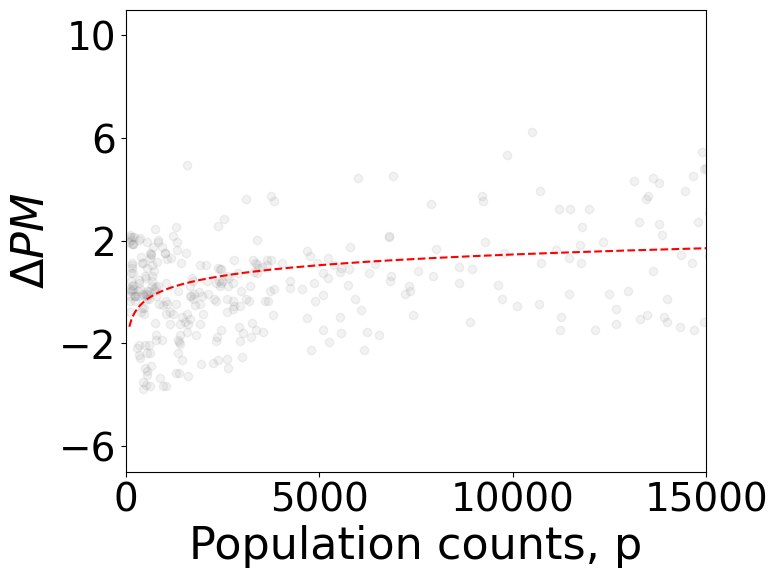

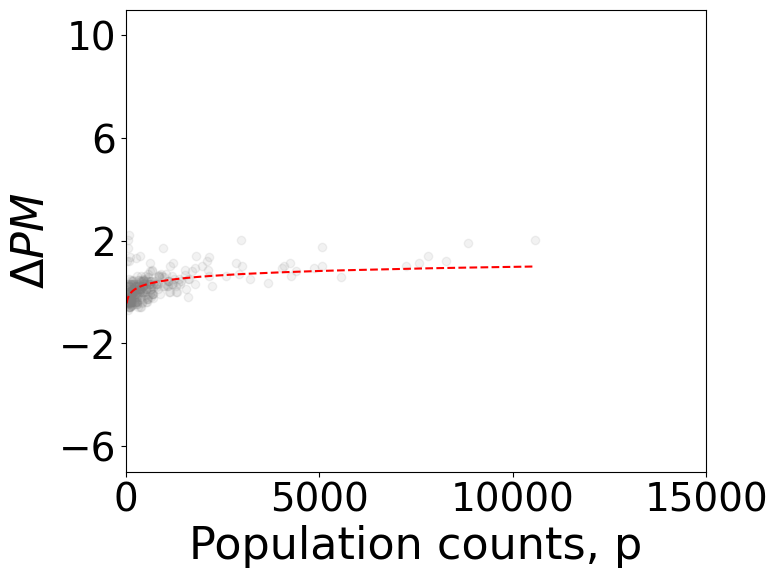

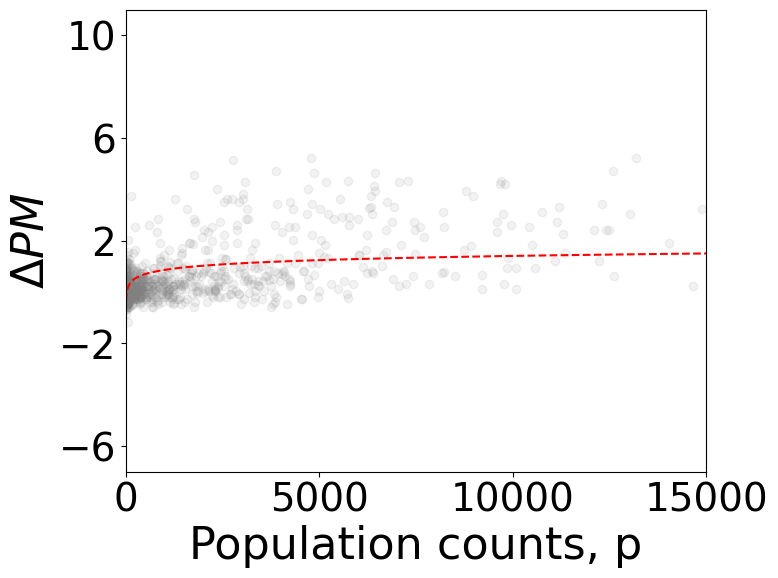

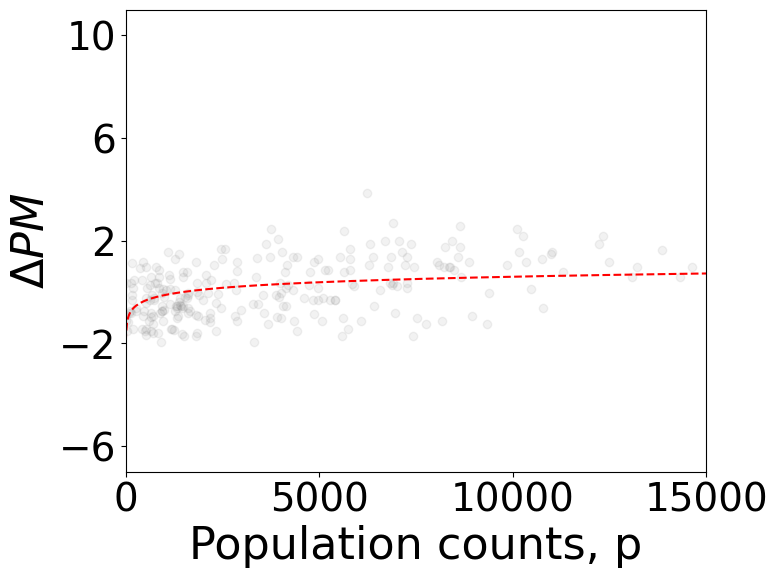

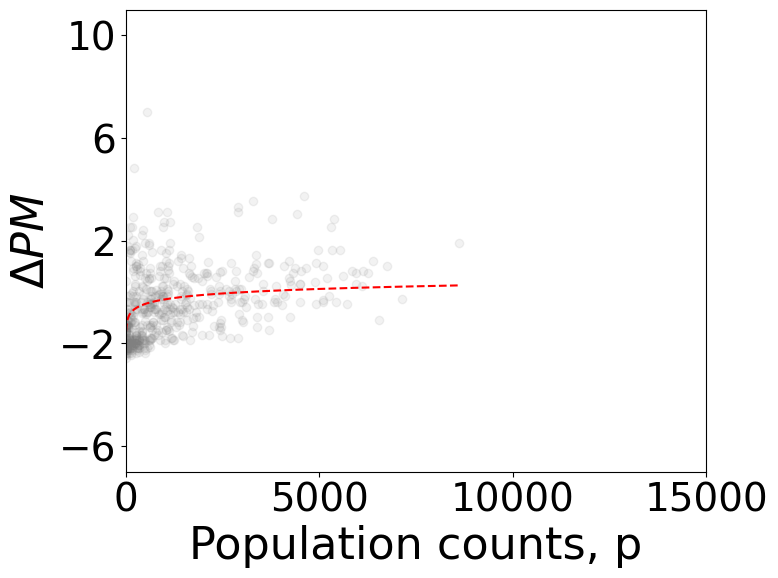

...

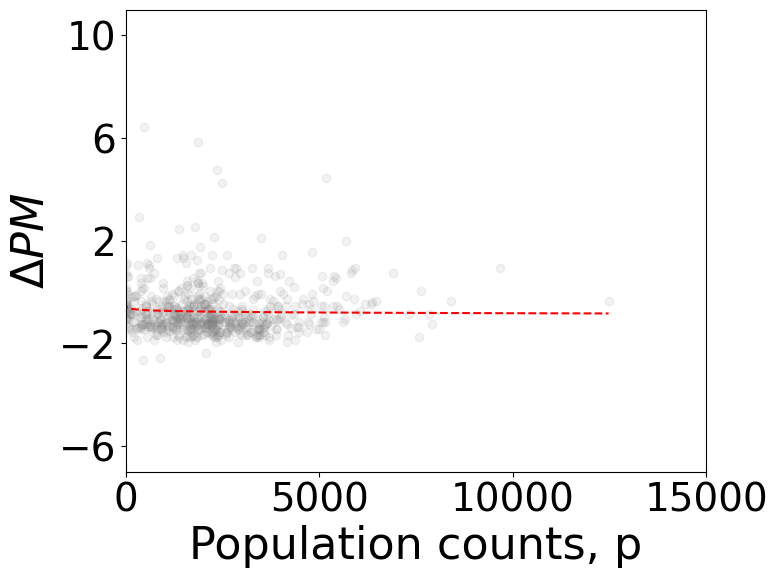

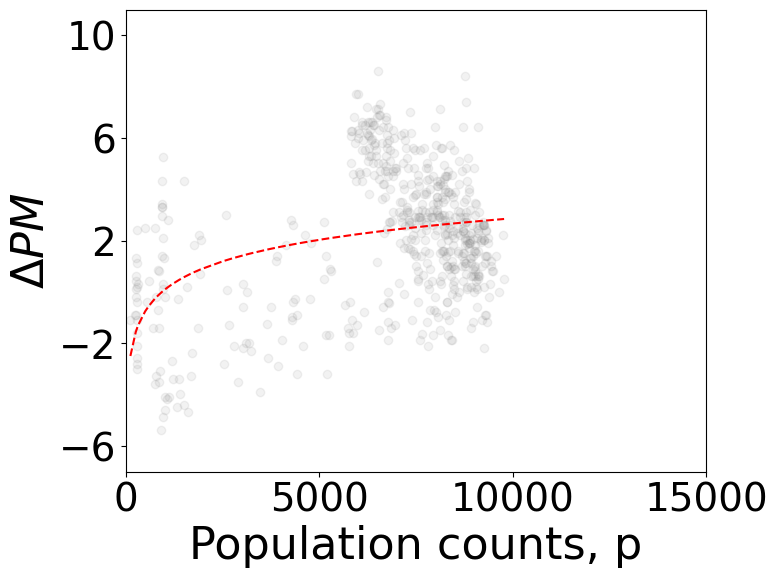

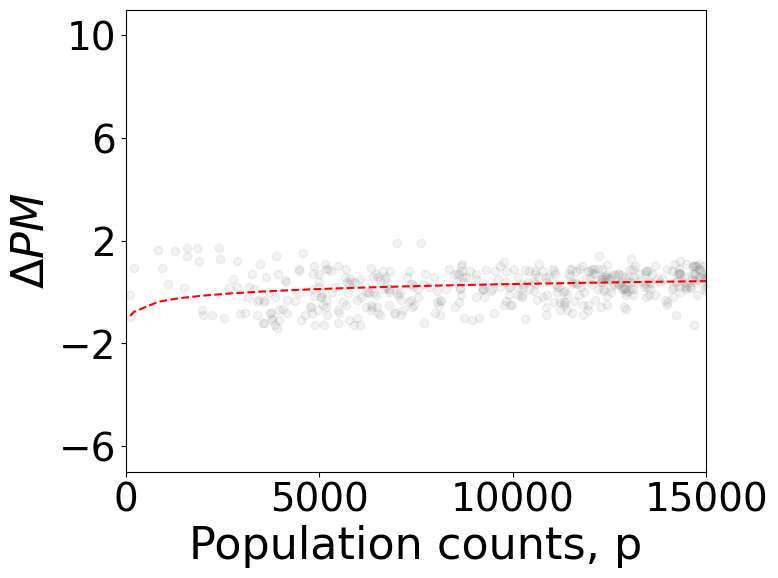

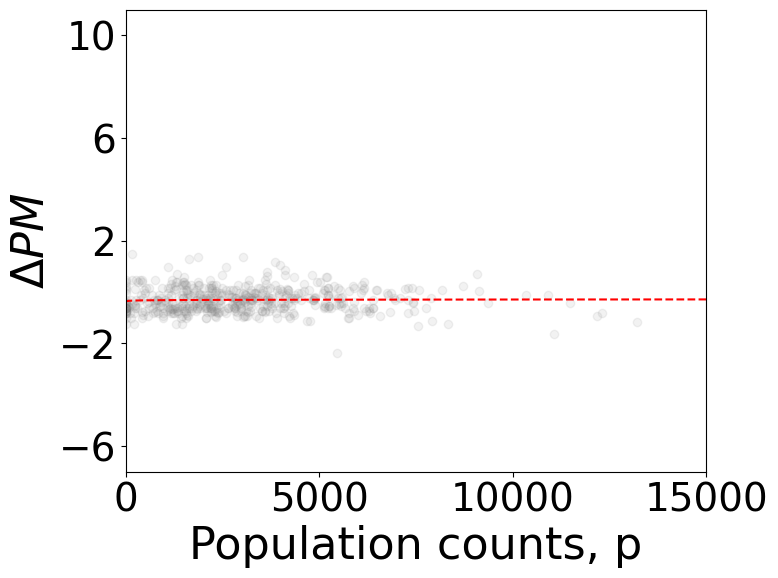

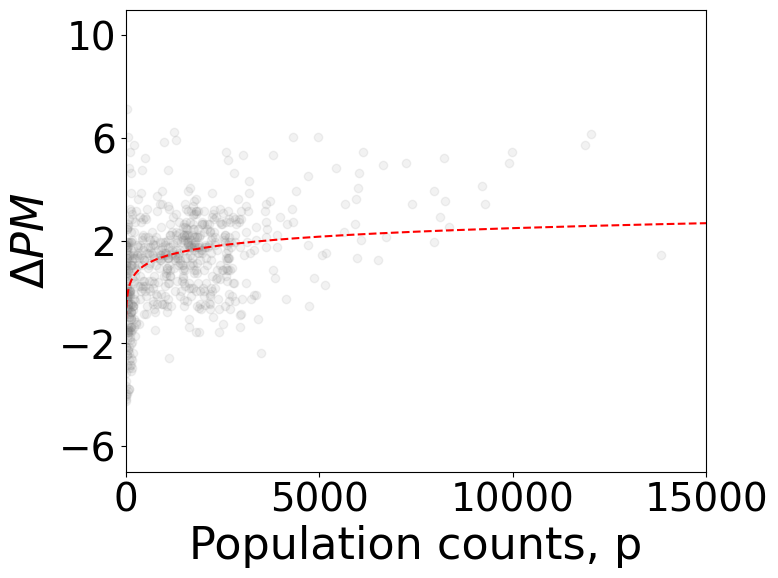

0.21685113132111322
1.334908307431788
City: Barcelona
  Linear Fit -> a: -4.07, b: 0.60, R^2: 0.17
City: Montpellier
  Linear Fit -> a: -1.17, b: 0.23, R^2: 0.29
City: Rome
  Linear Fit -> a: -0.77, b: 0.24, R^2: 0.22
City: Naples
  Linear Fit -> a: -2.27, b: 0.31, R^2: 0.16
City: Porto
  Linear Fit -> a: -2.04, b: 0.25, R^2: 0.15
City: Sevilla
  Linear Fit -> a: -1.54, b: 0.35, R^2: 0.37
City: Alicante
  Linear Fit -> a: -3.37, b: 0.49, R^2: 0.30
City: Valencia
  Linear Fit -> a: -3.72, b: 0.54, R^2: 0.41
City: Bologna
  Linear Fit -> a: -0.13, b: 0.29, R^2: 0.11
City: Padua
  Linear Fit -> a: -0.02, b: 0.03, R^2: 0.01
City: Turin
  Linear Fit -> a: 2.02, b: 0.08, R^2: 0.03
City: Madrid
  Linear Fit -> a: -2.32, b: 0.40, R^2: 0.34
City: Murcia
  Linear Fit -> a: -2.67, b: 0.43, R^2: 0.24
City: Genoa
  Linear Fit -> a: -1.26, b: 0.36, R^2: 0.32
City: Milan
  Linear Fit -> a: -0.22, b: -0.14, R^2: 0.07
City: Lisbon
  Linear Fit -> a: -0.12, b: 0.10, R^2: 0.08
City: Palma_de_Mallorca
  L

In [68]:
# NORMAL FIT WITHOUT WEIGHT

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')

def linear(x, a, b):
    return a + b * x

R_linear = []
RMSEs_linear = []

coefficients_PM = {}
coefficients_show = {}

percentage = 0

if POPULATION == 'yes':

    for city in cities:
    
        # print(city)
        logpopulation = np.array(pop_T_NETWORK_dic[city]['logpopu'])
        population = np.array(pop_T_NETWORK_dic[city]['popu'])
        temperature = np.array(pop_T_NETWORK_dic[city]['deltaPM'+PM])
        
        # Fit linear model
        reg = LinearRegression().fit(logpopulation.reshape(-1, 1), temperature)
        a_linear, b_linear = reg.intercept_, reg.coef_[0]
        temperature_pred_linear = reg.predict(logpopulation.reshape(-1, 1))
        
        # Calculate residuals and metrics
        residuals_linear = temperature - temperature_pred_linear
        r2_linear = r2_score(temperature, temperature_pred_linear)
        rmse_linear = np.sqrt(mean_squared_error(temperature, temperature_pred_linear))
        R_linear.append(r2_linear)
        RMSEs_linear.append(rmse_linear)
        
        # Store coefficients
        coefficients_PM[city] = [a_linear, b_linear, r2_linear]
        coefficients_show[city] = {
            'linear': [a_linear, b_linear, r2_linear]
        }
    
        fig, ax = plt.subplots(figsize=(8, 6))
    
        ax.scatter(population, temperature, alpha=0.1, color='grey', edgecolor='grey')
        ax.plot(np.sort(population), linear(np.sort(logpopulation), a_linear, b_linear), color='red', linestyle='--', label='Log Linear Fit')
        ax.set_xlabel(r'Population counts, p', size=32)
        ax.set_ylabel(r'$\Delta PM$', size=32)
        ax.set_ylim(-7, 11)  
        ax.set_xlim(0, 15000)
        # ax.set_xlim(-2, 300)
        # plt.xticks([0,50,100])
        plt.yticks([-6,-2,2,6,10])
        plt.tick_params(axis='y', labelsize=28) 
        plt.xticks([0,5000,10000,15000])
        plt.tick_params(axis='x', labelsize=28)
        
        plt.tight_layout(pad=1.5)
        plt.show()
    
    print(np.mean(R_linear))
    print(np.mean(RMSEs_linear))
    
    cluster_colors = {1:'red', 2:'green', 3:'#0077b6', 4:'purple'}      
    
    for city, coeffs in coefficients_show.items():
        print(f"City: {city}")
        print(f"  Linear Fit -> a: {coeffs['linear'][0]:.2f}, b: {coeffs['linear'][1]:.2f}, R^2: {coeffs['linear'][2]:.2f}")


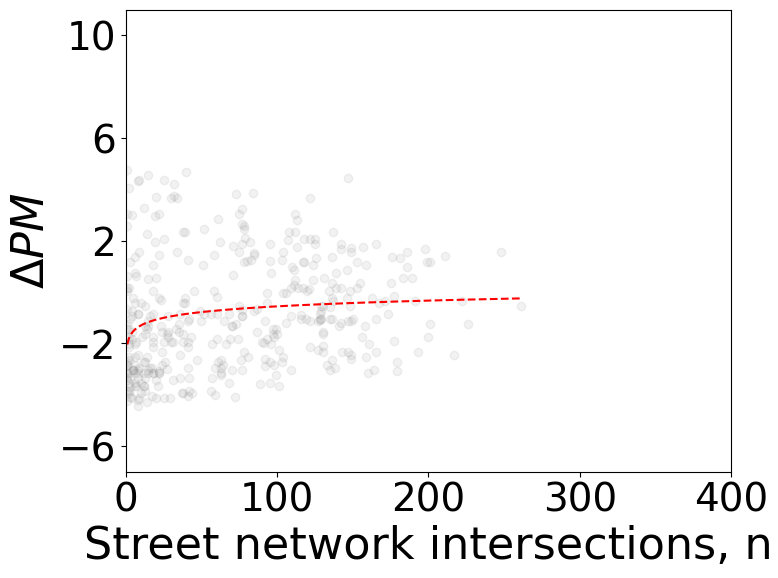

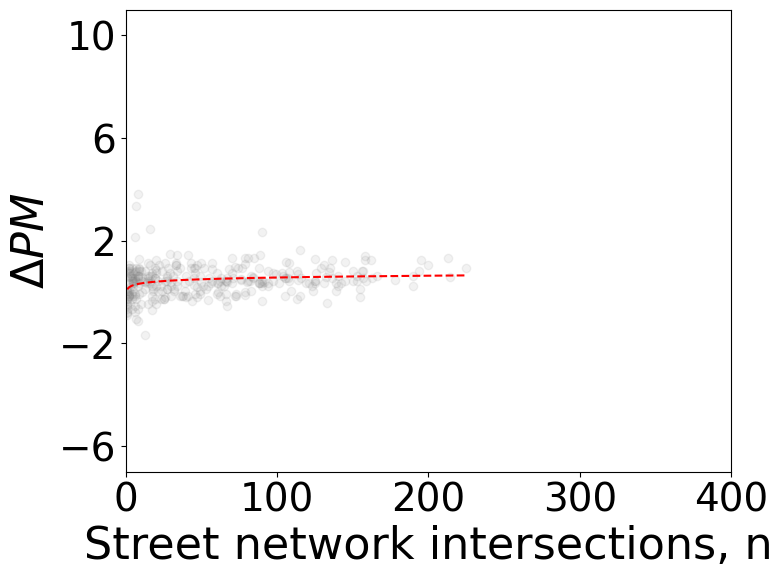

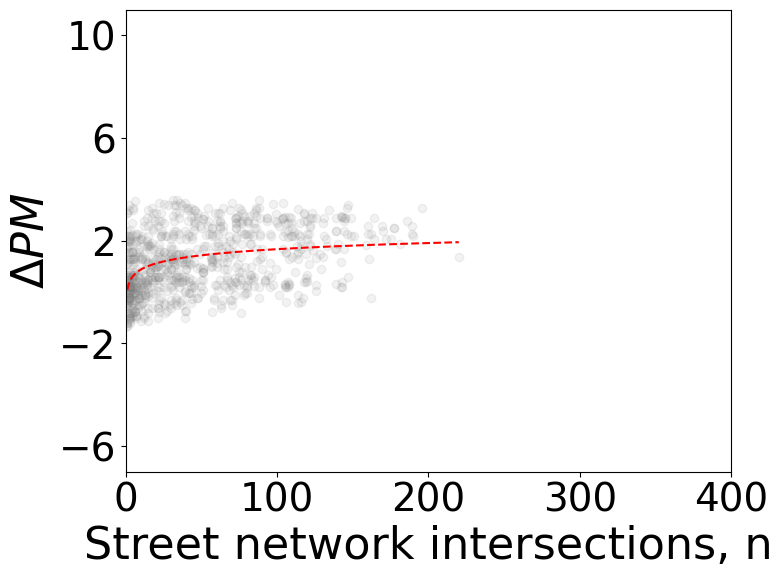

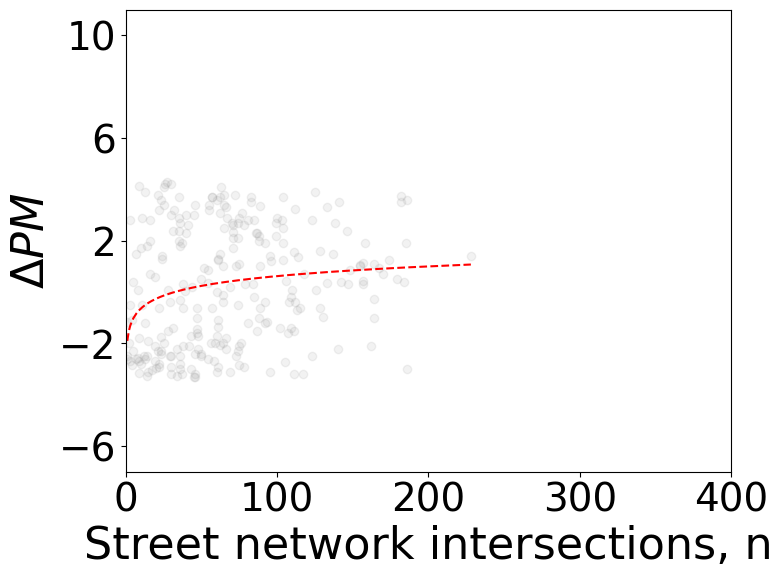

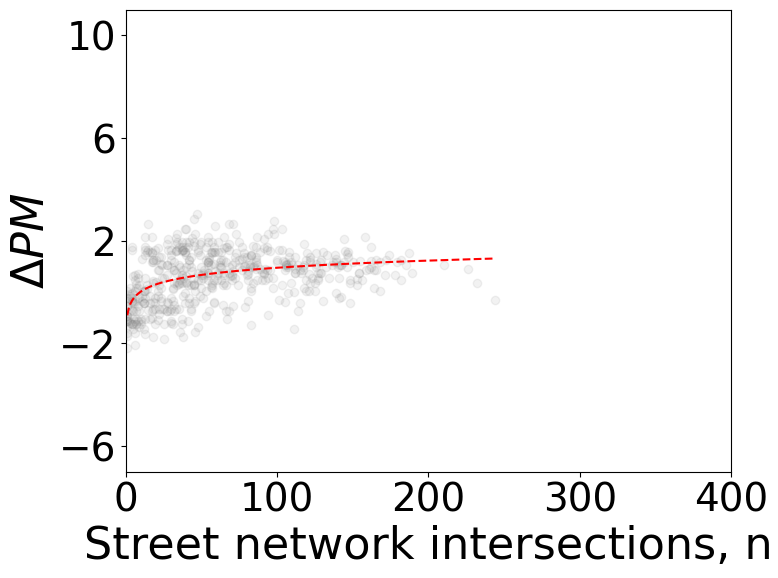

...

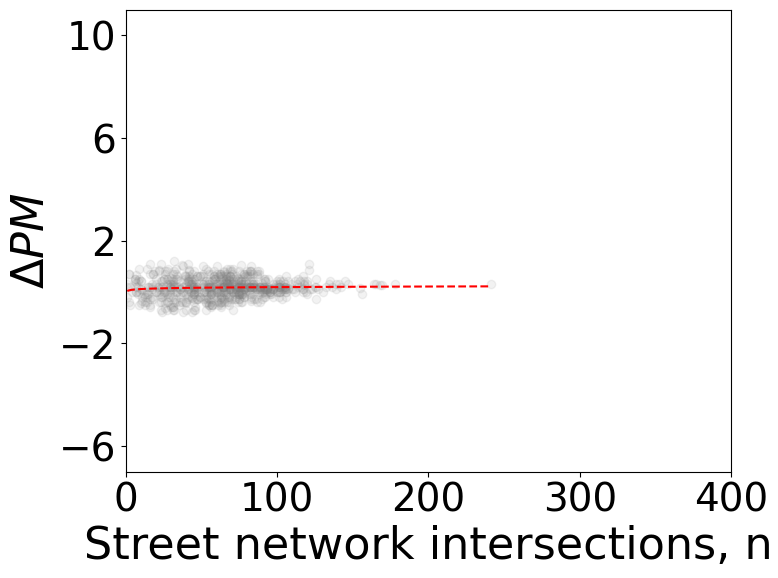

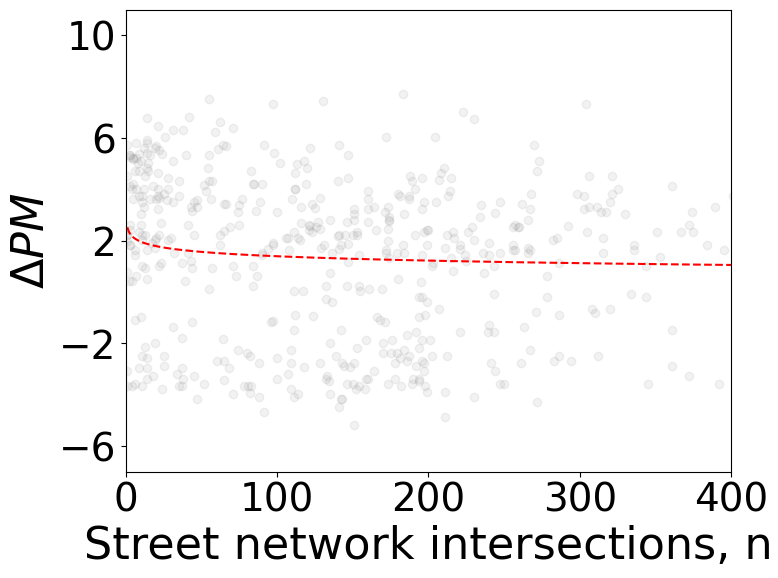

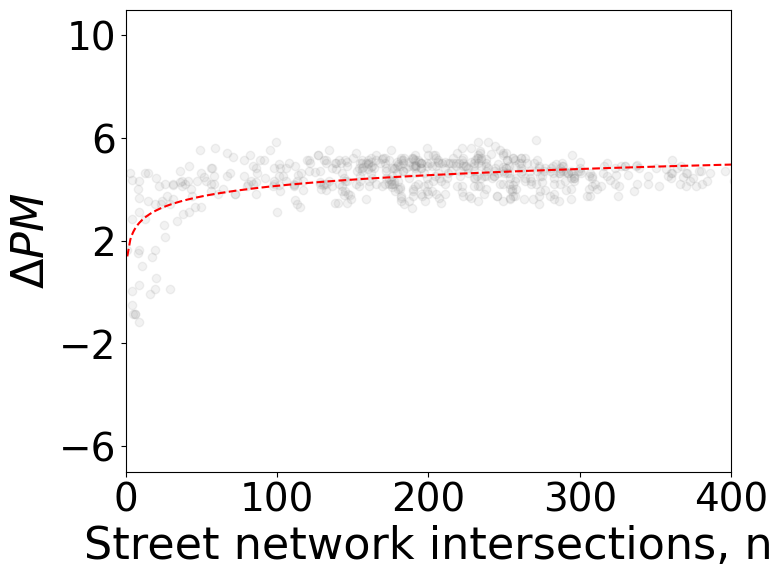

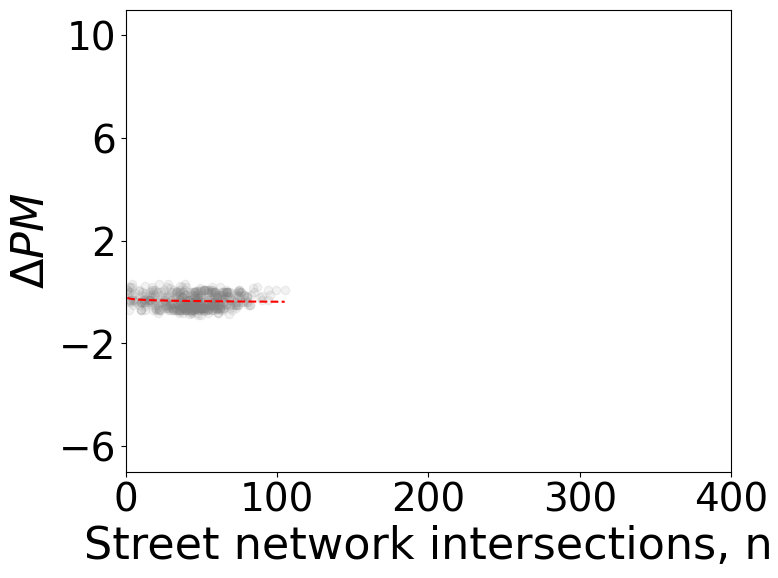

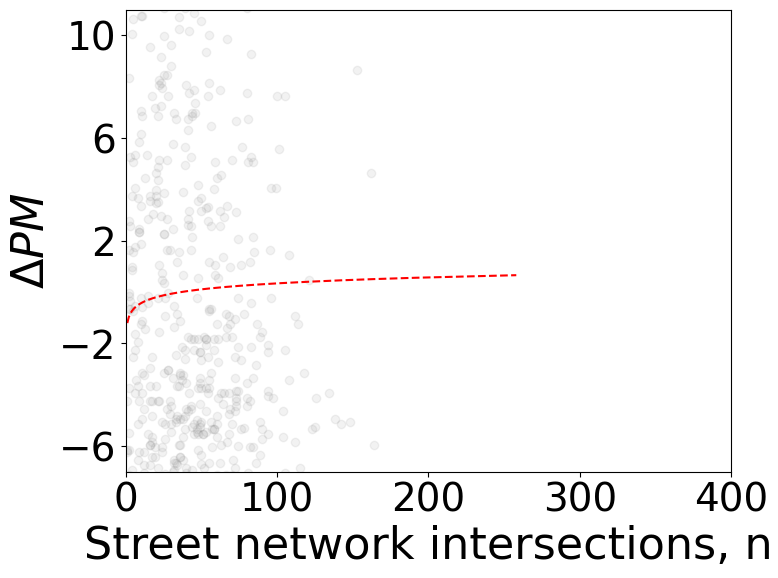

0.07827975361221154
1.0748231274311777
City: Barcelona
  Linear Fit -> a: -2.04, b: 0.32, R^2: 0.05
City: Montpellier
  Linear Fit -> a: 0.11, b: 0.10, R^2: 0.05
City: Rome
  Linear Fit -> a: 0.08, b: 0.34, R^2: 0.16
City: Naples
  Linear Fit -> a: -1.90, b: 0.55, R^2: 0.06
City: Porto
  Linear Fit -> a: -0.91, b: 0.40, R^2: 0.22
City: Sevilla
  Linear Fit -> a: 0.28, b: 0.26, R^2: 0.20
City: Alicante
  Linear Fit -> a: -1.55, b: 0.11, R^2: 0.02
City: Valencia
  Linear Fit -> a: -0.84, b: 0.08, R^2: 0.01
City: Bologna
  Linear Fit -> a: -0.67, b: 0.37, R^2: 0.10
City: Padua
  Linear Fit -> a: 0.60, b: 0.07, R^2: 0.01
City: Turin
  Linear Fit -> a: -0.22, b: 0.27, R^2: 0.19
City: Madrid
  Linear Fit -> a: 0.54, b: -0.01, R^2: 0.00
City: Murcia
  Linear Fit -> a: 0.69, b: 0.19, R^2: 0.19
City: Genoa
  Linear Fit -> a: -0.70, b: 0.12, R^2: 0.11
City: Milan
  Linear Fit -> a: 0.12, b: 0.46, R^2: 0.18
City: Lisbon
  Linear Fit -> a: -0.74, b: 0.08, R^2: 0.03
City: Palma_de_Mallorca
  Linear

In [77]:
# NORMAL FIT WITHOUT WEIGHT

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')
              

def linear(x, a, b):
    return a + b * x

R_linear = []
RMSEs_linear = []

coefficients_PM = {}
coefficients_show = {}

percentage = 0

for city in cities:

    # print(city)
    logpopulation = np.array(pop_T_NETWORK_dic[city]['lognode'])
    population = np.array(pop_T_NETWORK_dic[city]['node'])
    temperature = np.array(pop_T_NETWORK_dic[city]['deltaPM'+PM])
    
    # Fit linear model
    reg = LinearRegression().fit(logpopulation.reshape(-1, 1), temperature)
    a_linear, b_linear = reg.intercept_, reg.coef_[0]
    temperature_pred_linear = reg.predict(logpopulation.reshape(-1, 1))
    
    # Calculate residuals and metrics
    residuals_linear = temperature - temperature_pred_linear
    r2_linear = r2_score(temperature, temperature_pred_linear)
    rmse_linear = np.sqrt(mean_squared_error(temperature, temperature_pred_linear))
    R_linear.append(r2_linear)
    RMSEs_linear.append(rmse_linear)
    
    # Store coefficients
    coefficients_PM[city] = [a_linear, b_linear, r2_linear]
    coefficients_show[city] = {
        'linear': [a_linear, b_linear, r2_linear]
    }

    fig, ax = plt.subplots(figsize=(8, 6))


    ax.scatter(population, temperature, alpha=0.1, color='grey', edgecolor='grey')
    ax.plot(np.sort(population), linear(np.sort(logpopulation), a_linear, b_linear), color='red', linestyle='--', label='Log Linear Fit')
    # ax.set_xscale('log')
    # ax.set_yscale('log')
    ax.set_xlabel(r'Street network intersections, n', size=32)
    ax.set_ylabel(r'$\Delta PM$', size=32)
    ax.set_ylim(-7, 11)  
    # ax.set_xlim(0, 3500)
    ax.set_xlim(0, 400)
    # plt.xticks([5000,15000,25000])
    plt.yticks([-6,-2,2,6,10])
    plt.tick_params(axis='y', labelsize=28) 
    plt.tick_params(axis='x', labelsize=28)

    plt.tight_layout(pad=1.5)
    plt.show()

print(np.mean(R_linear))
print(np.mean(RMSEs_linear))

cluster_colors = {1:'red', 2:'green', 3:'#0077b6', 4:'purple'}      

for city, coeffs in coefficients_show.items():
    print(f"City: {city}")
    print(f"  Linear Fit -> a: {coeffs['linear'][0]:.2f}, b: {coeffs['linear'][1]:.2f}, R^2: {coeffs['linear'][2]:.2f}")


In [78]:
# GENERATE COEFFICIENTS vs grid cell size l

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')

coefficients = [coefficients_PM]#1,coefficients2,coefficients3,coefficients4
sizes = [1000] #,1000,1500,2000

coefficients_dic_combined = {}

for coeffs, s in zip(coefficients,sizes):
    for city, values in coeffs.items():
        if city not in coefficients_dic_combined:
            coefficients_dic_combined[city] = []
        
        # Append values with grid cell size
        coefficients_dic_combined[city].append(values + [s])

coefficients_dic = {}

for city, values in coefficients_dic_combined.items():
    # Create a DataFrame for the current city and store it in the dictionary
    coefficients_dic[city] = pd.DataFrame(values, columns=['intersection', 'slope', 'R2', 'l'])

for city in cities:
    coefficients_dic[city].to_csv(city+'_coefficients_logn_PM'+PM+'_'+size+'.csv', index=False) 

## TEMPERATURE

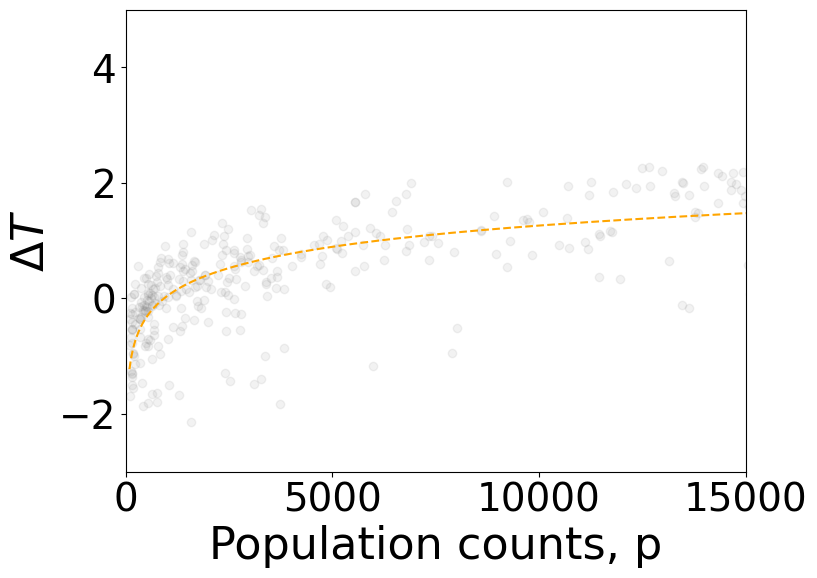

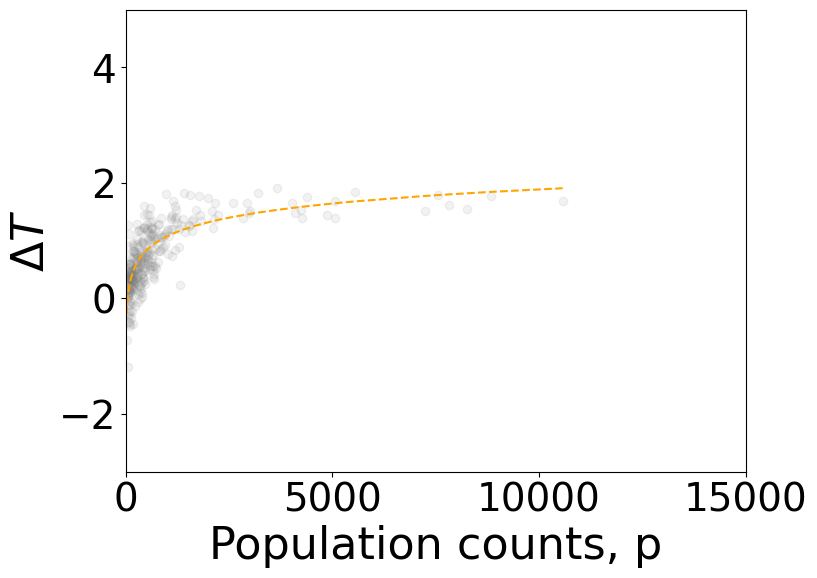

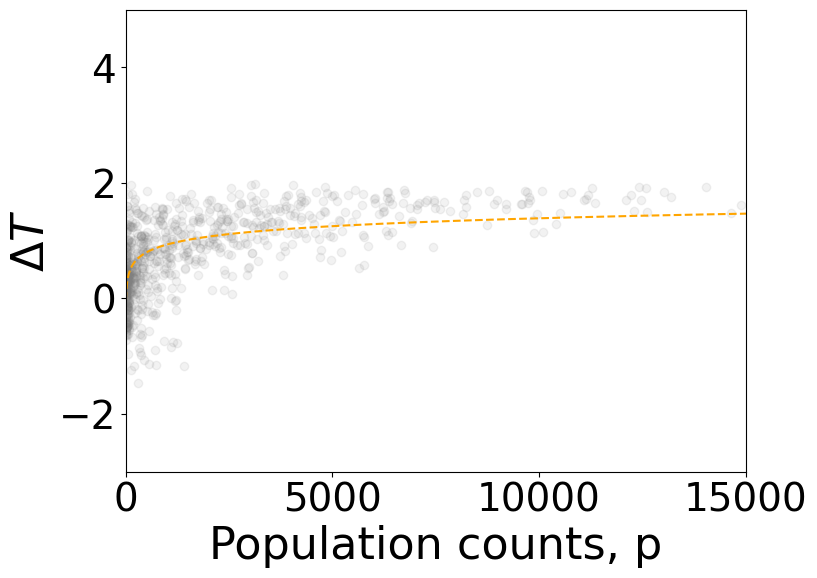

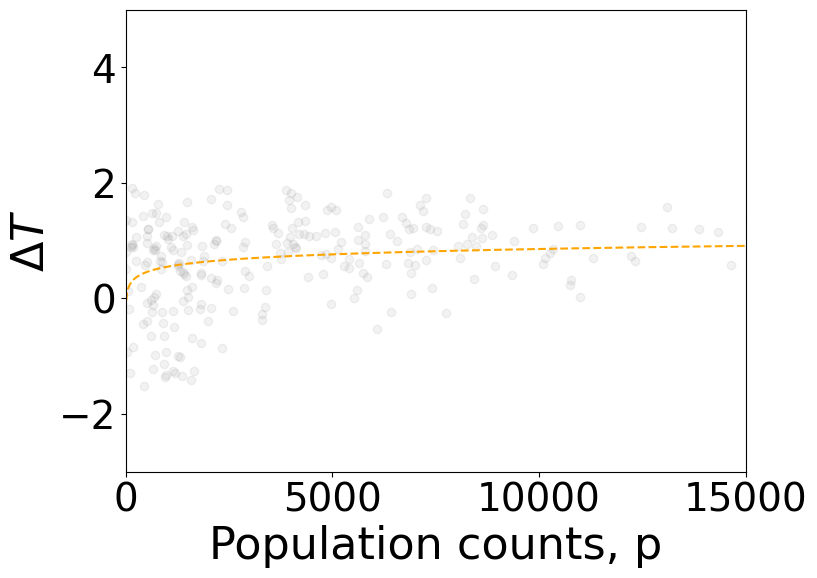

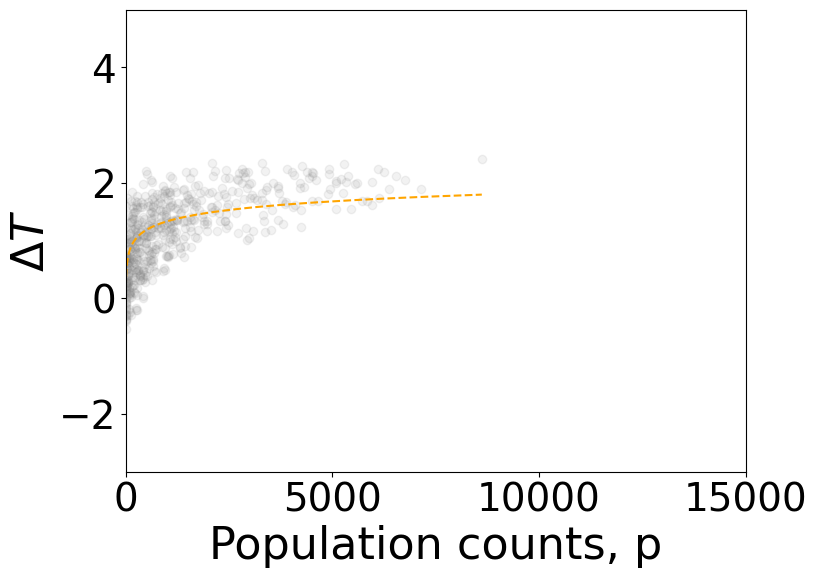

...

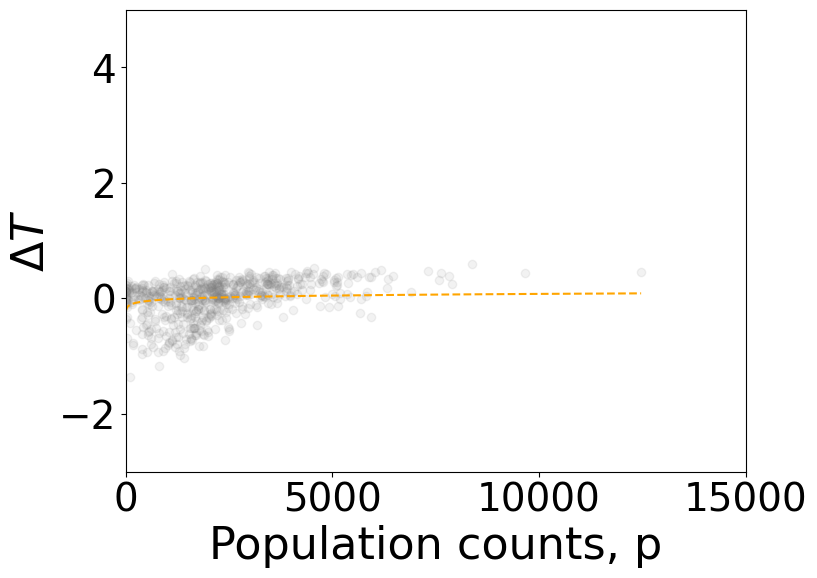

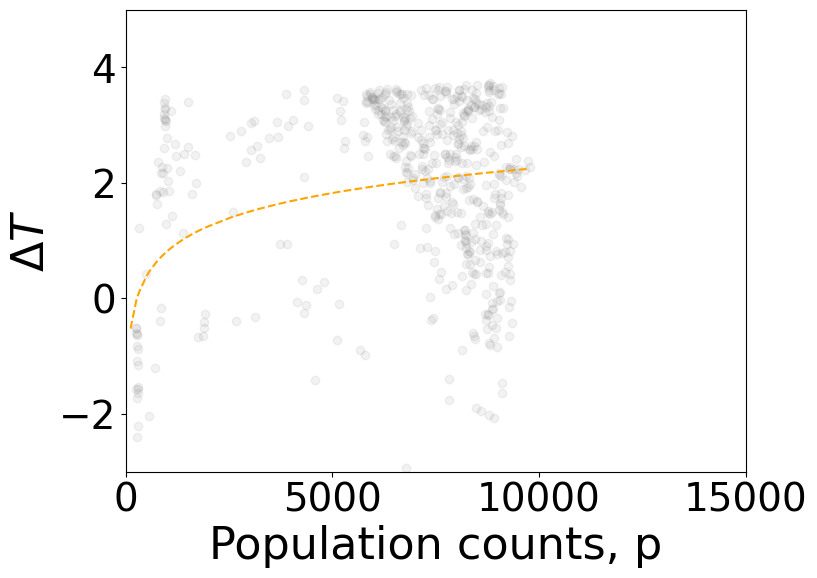

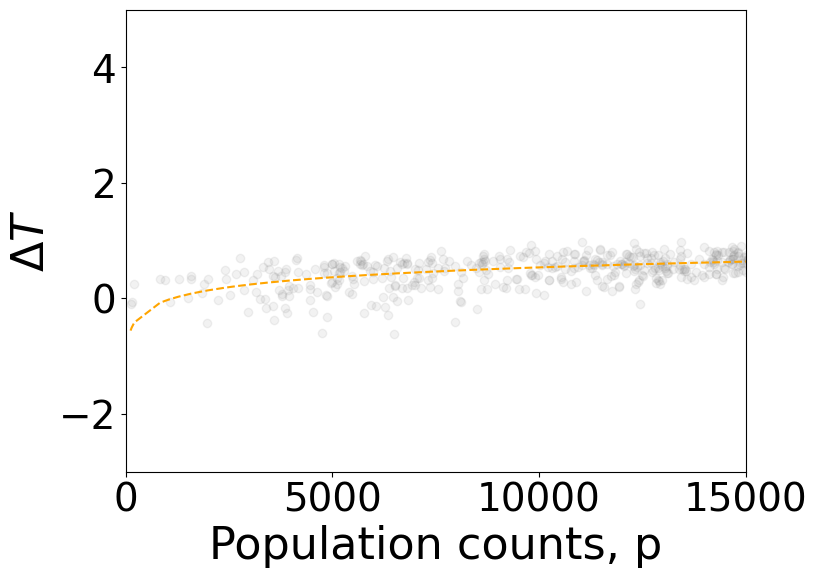

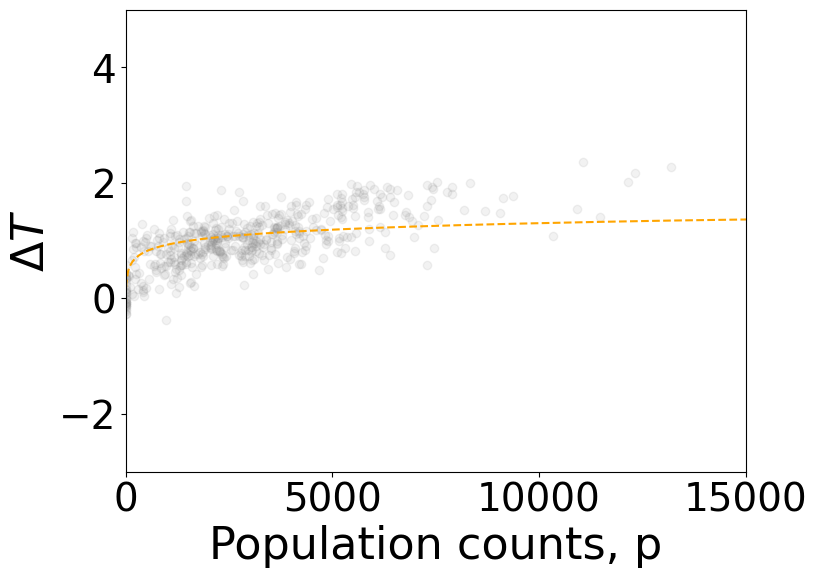

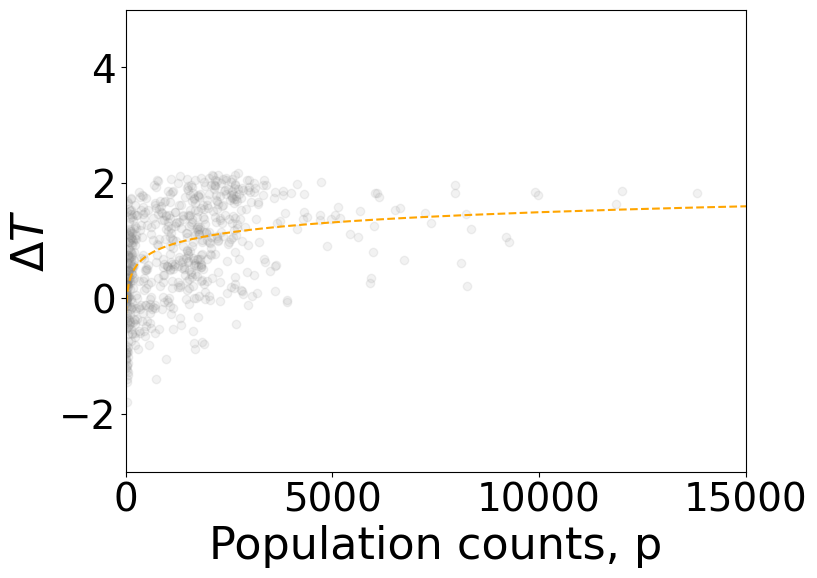

0.47610954210377227
0.47001845141681114
City: Barcelona
  Linear Fit -> a: -3.62, b: 0.53, R^2: 0.58
City: Montpellier
  Linear Fit -> a: -1.37, b: 0.35, R^2: 0.61
City: Rome
  Linear Fit -> a: -0.43, b: 0.20, R^2: 0.40
City: Naples
  Linear Fit -> a: -0.38, b: 0.13, R^2: 0.06
City: Porto
  Linear Fit -> a: -0.15, b: 0.21, R^2: 0.47
City: Sevilla
  Linear Fit -> a: -2.16, b: 0.39, R^2: 0.63
City: Alicante
  Linear Fit -> a: -1.77, b: 0.31, R^2: 0.74
City: Valencia
  Linear Fit -> a: -1.88, b: 0.32, R^2: 0.56
City: Bologna
  Linear Fit -> a: -0.59, b: 0.25, R^2: 0.43
City: Padua
  Linear Fit -> a: -1.13, b: 0.31, R^2: 0.31
City: Turin
  Linear Fit -> a: -1.19, b: 0.29, R^2: 0.41
City: Madrid
  Linear Fit -> a: -2.52, b: 0.42, R^2: 0.49
City: Murcia
  Linear Fit -> a: -1.35, b: 0.32, R^2: 0.66
City: Genoa
  Linear Fit -> a: -0.84, b: 0.40, R^2: 0.55
City: Milan
  Linear Fit -> a: -0.31, b: 0.18, R^2: 0.43
City: Lisbon
  Linear Fit -> a: -0.19, b: 0.07, R^2: 0.07
City: Palma_de_Mallorca
 

In [32]:
# NORMAL FIT WITHOUT WEIGHT

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')

def linear(x, a, b):
    return a + b * x

R_linear = []
RMSEs_linear = []

coefficients_T = {}
coefficients_show = {}

percentage = 0

if POPULATION == 'yes': 

    for city in cities:
        
        logpopulation = np.array(pop_T_NETWORK_dic[city]['logpopu'])
        population = np.array(pop_T_NETWORK_dic[city]['popu'])
        temperature = np.array(pop_T_NETWORK_dic[city]['deltaT'])
        
        # Fit linear model
        reg = LinearRegression().fit(logpopulation.reshape(-1, 1), temperature)
        a_linear, b_linear = reg.intercept_, reg.coef_[0]
        temperature_pred_linear = reg.predict(logpopulation.reshape(-1, 1))
        
        # Calculate residuals and metrics
        residuals_linear = temperature - temperature_pred_linear
        r2_linear = r2_score(temperature, temperature_pred_linear)
        rmse_linear = np.sqrt(mean_squared_error(temperature, temperature_pred_linear))
        R_linear.append(r2_linear)
        RMSEs_linear.append(rmse_linear)
        
        # Store coefficients
        coefficients_T[city] = [a_linear, b_linear, r2_linear]
        coefficients_show[city] = {
            'linear': [a_linear, b_linear, r2_linear]
        }
    
        fig, ax = plt.subplots(figsize=(8, 6))
    
        ax.scatter(population, temperature, alpha=0.1, color='grey', edgecolor='grey')
        ax.plot(np.sort(population), linear(np.sort(logpopulation), a_linear, b_linear), color='orange', linestyle='--', label='Log Linear Fit')
        # ax1.set_xscale('log')
        # ax1.set_yscale('log')
        ax.set_xlabel(r'Population counts, p', size=32)
        ax.set_ylabel(r'$\Delta T$', size=32)
        ax.set_ylim(-3, 5)  
        ax.set_xlim(0, 15000)
        # ax.set_xlim(-2, 300)
        # plt.xticks([0,50,100])
        plt.yticks([-2,0,2,4])
        plt.tick_params(axis='y', labelsize=28) 
        plt.xticks([0,5000,10000,15000])
        plt.tick_params(axis='x', labelsize=28)
        
        plt.show()
    
    print(np.mean(R_linear))
    print(np.mean(RMSEs_linear))
    
    cluster_colors = {1:'red', 2:'green', 3:'#0077b6', 4:'purple'}      
    
    for city, coeffs in coefficients_show.items():
        print(f"City: {city}")
        print(f"  Linear Fit -> a: {coeffs['linear'][0]:.2f}, b: {coeffs['linear'][1]:.2f}, R^2: {coeffs['linear'][2]:.2f}")

Barcelona


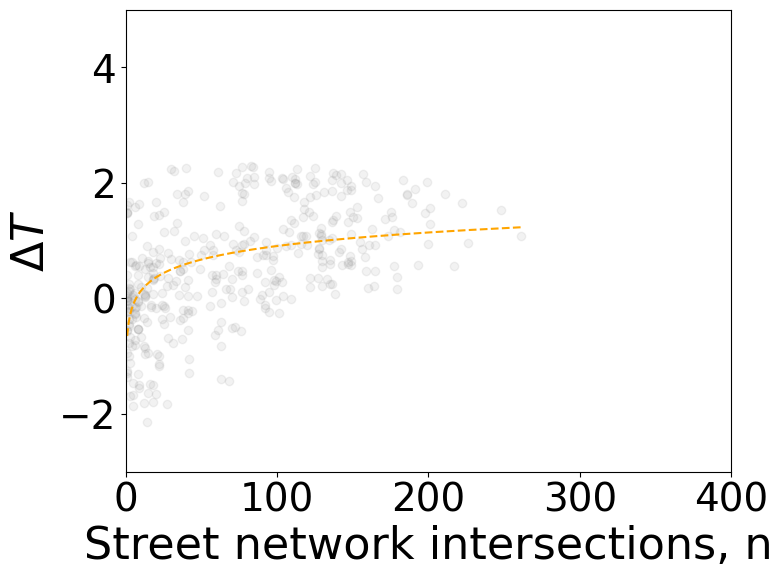

Montpellier


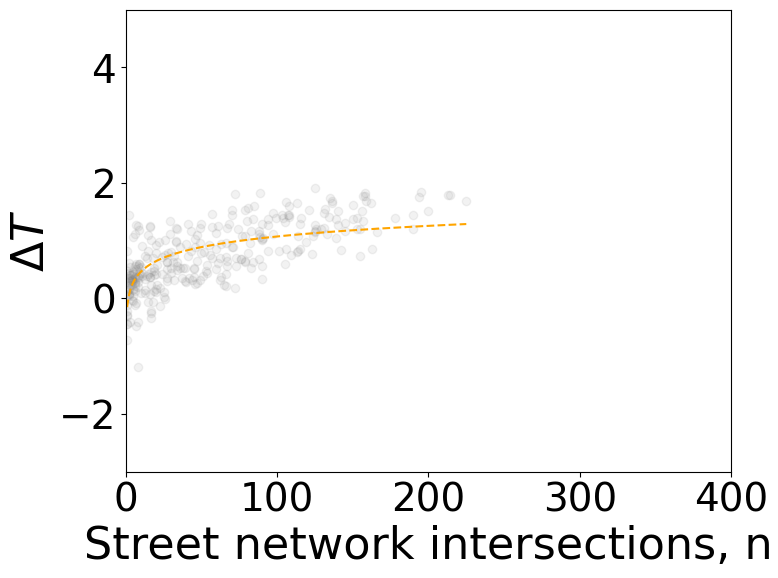

Rome


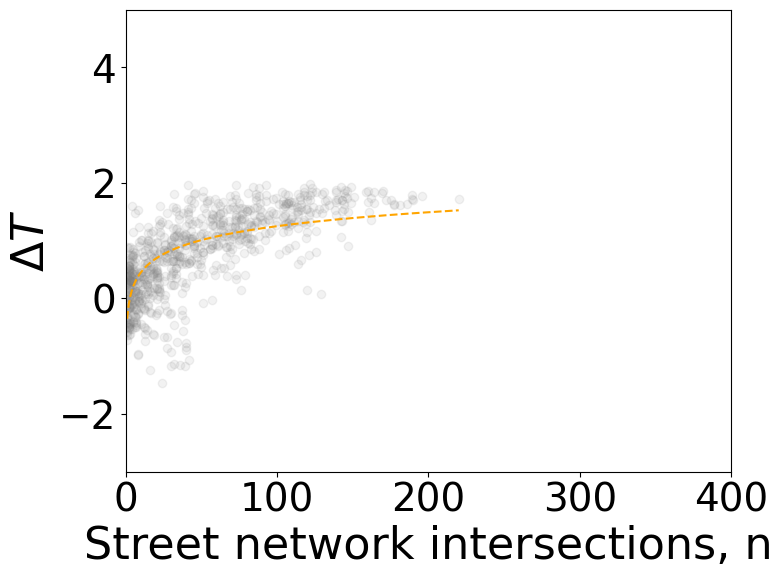

Naples


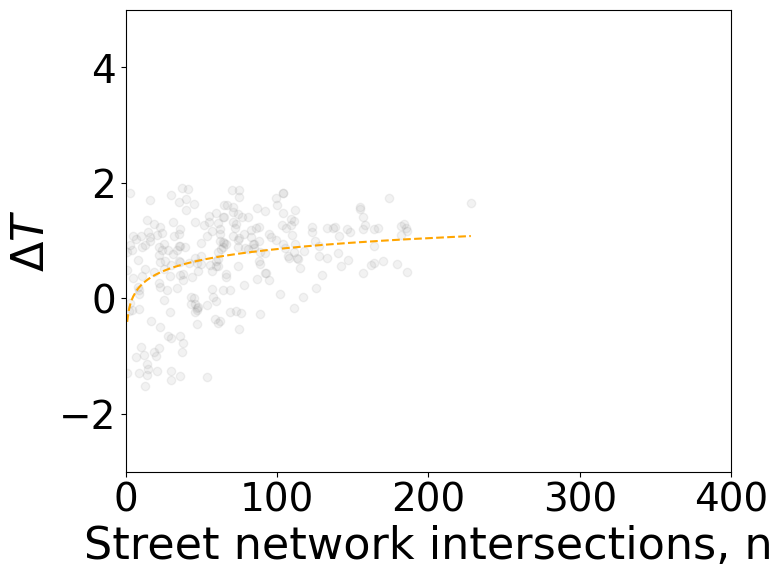

Porto


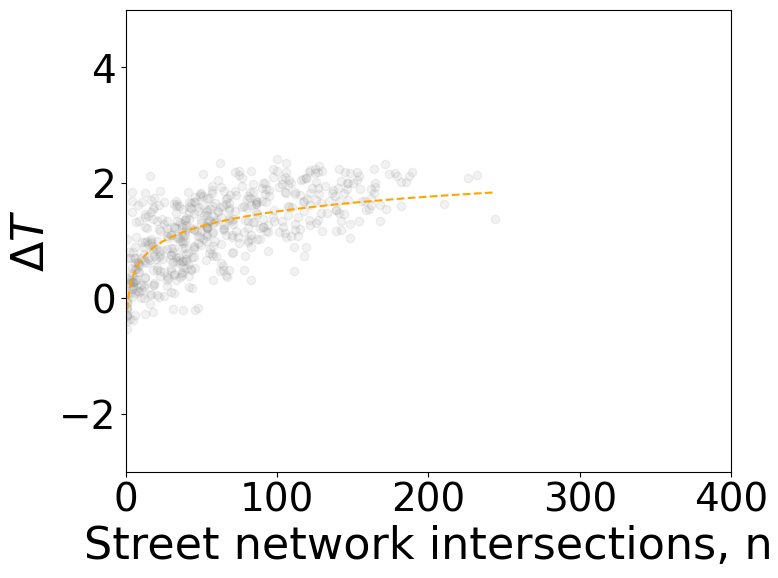

Sevilla


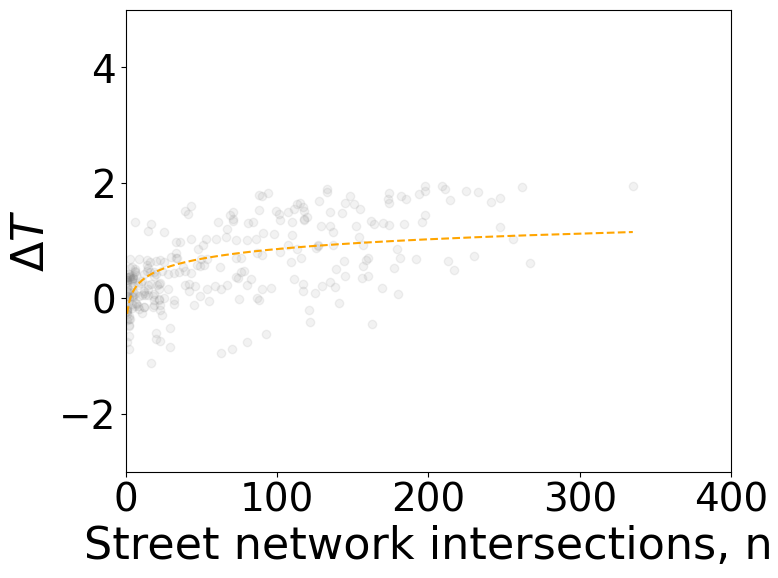

Alicante


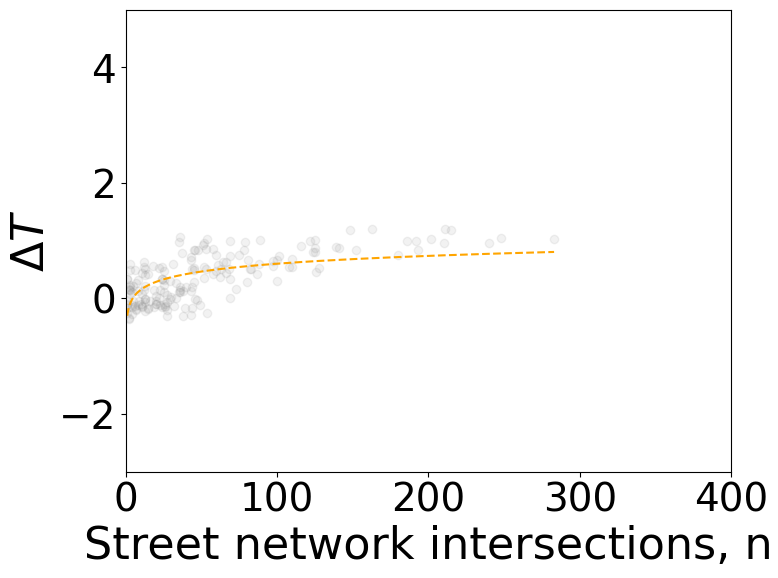

Valencia


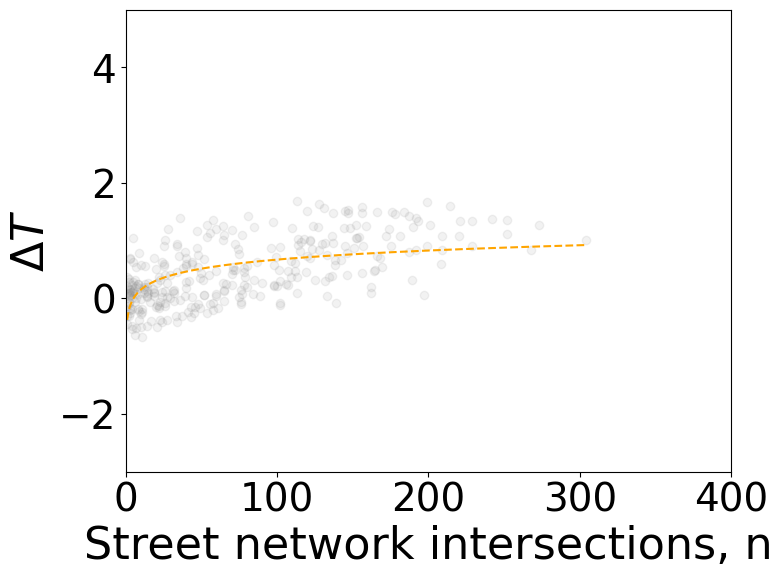

Bologna


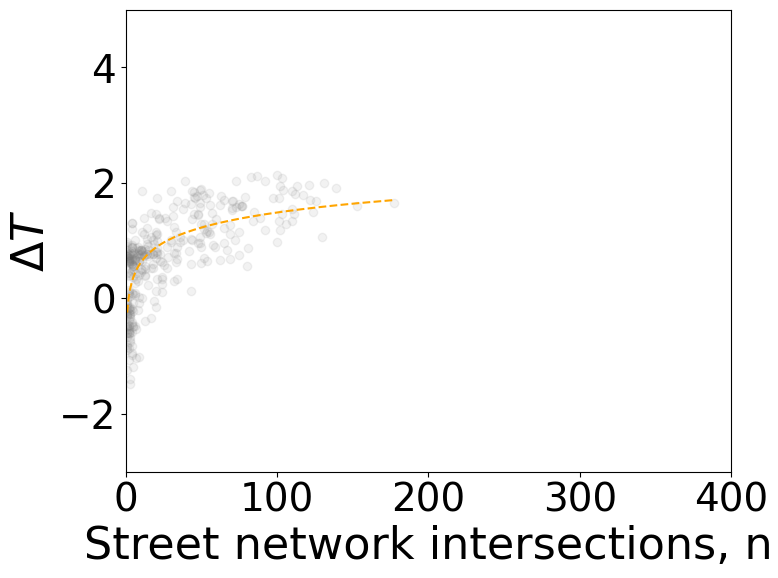

Padua


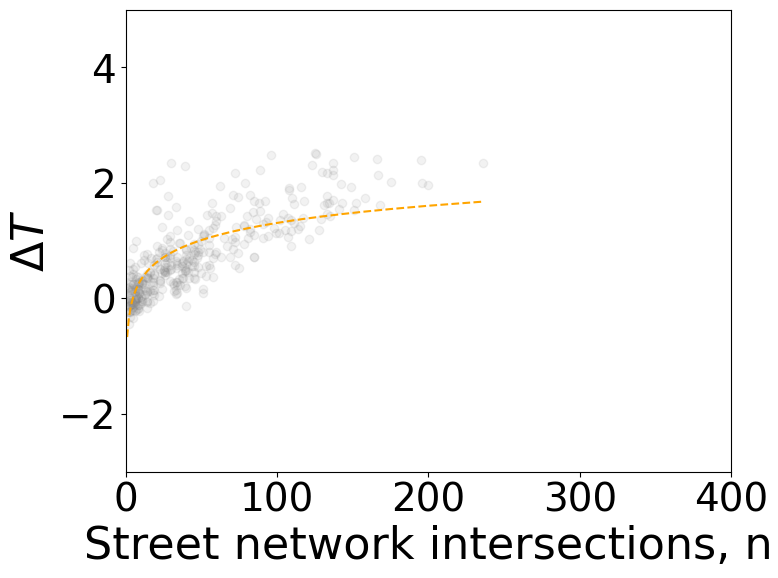

Turin


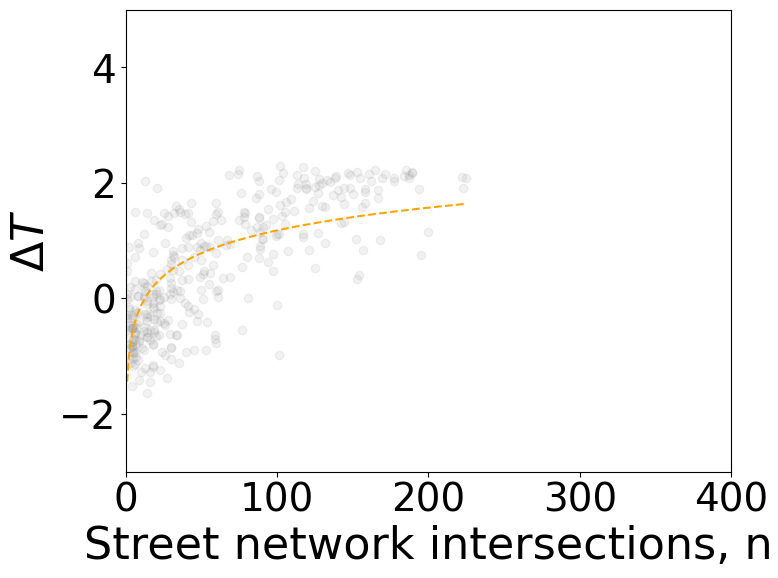

Madrid


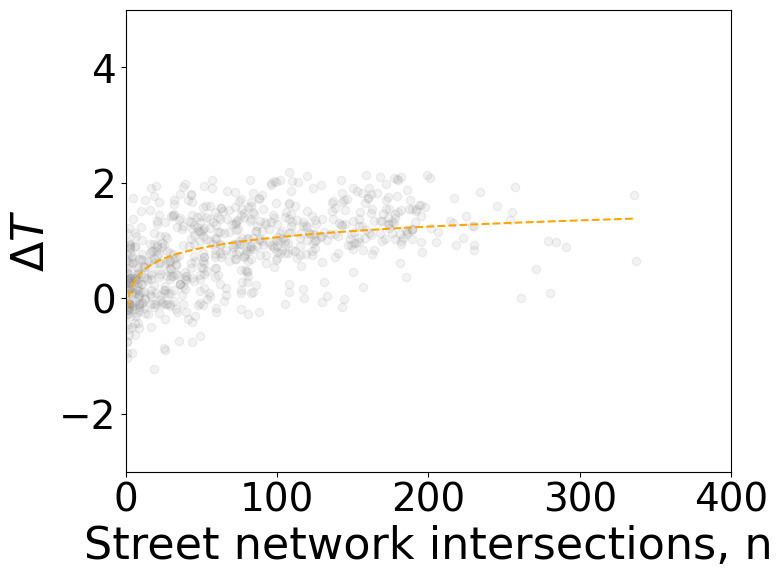

Murcia


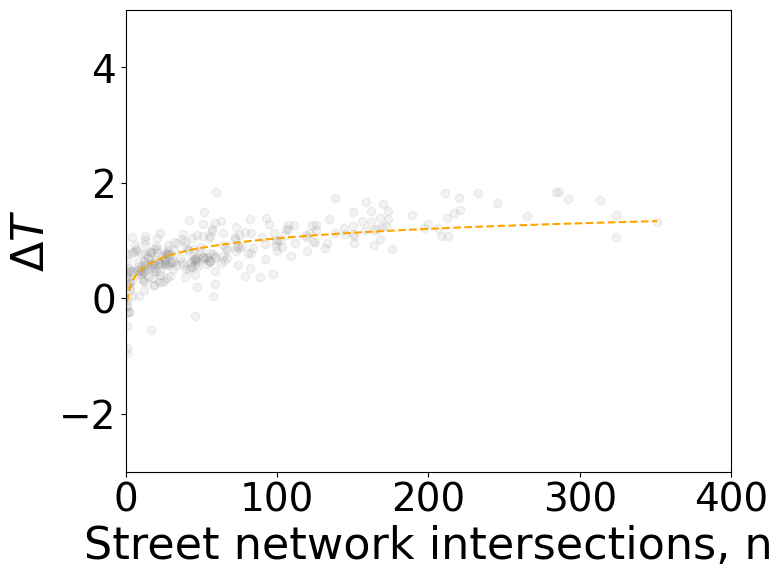

Genoa


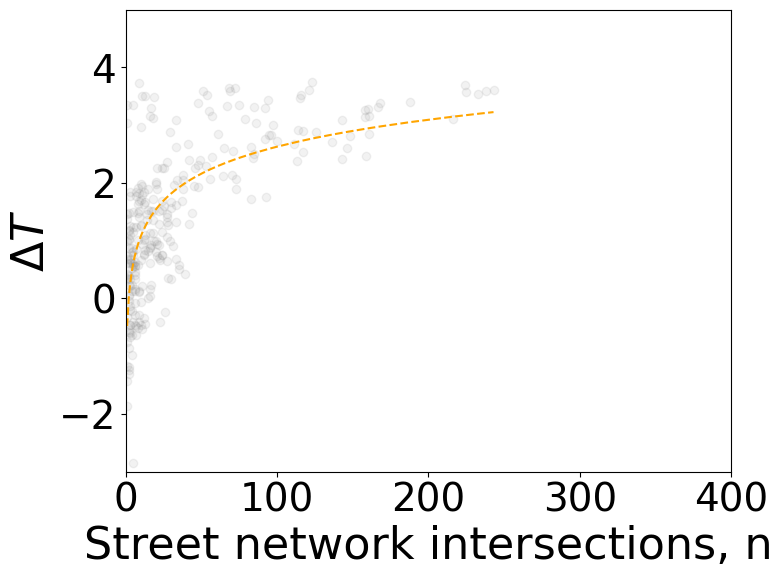

Milan


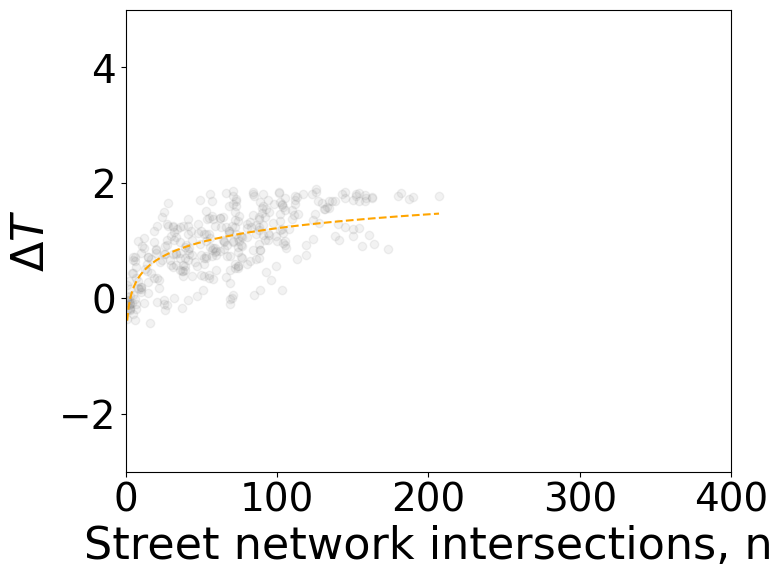

Lisbon


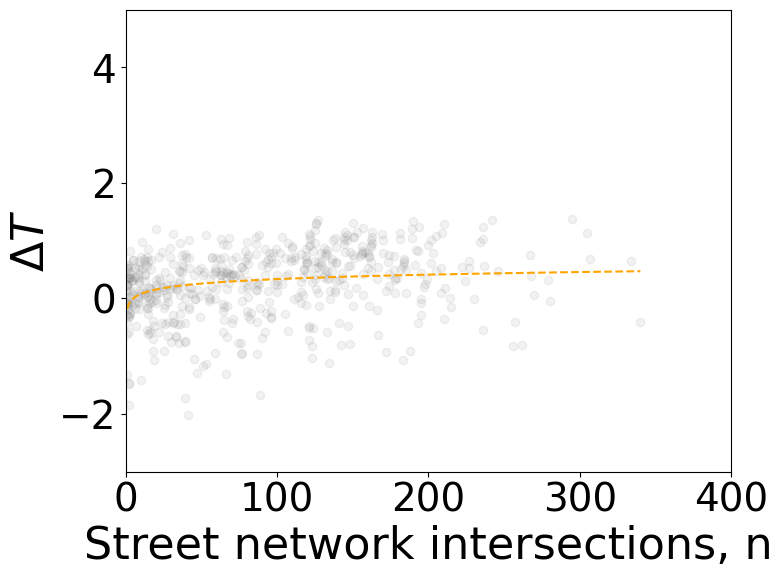

Palma_de_Mallorca


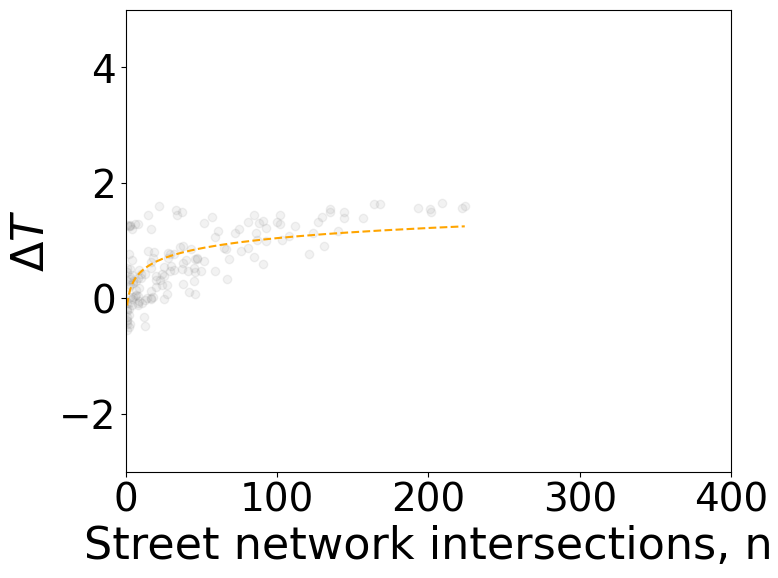

Split


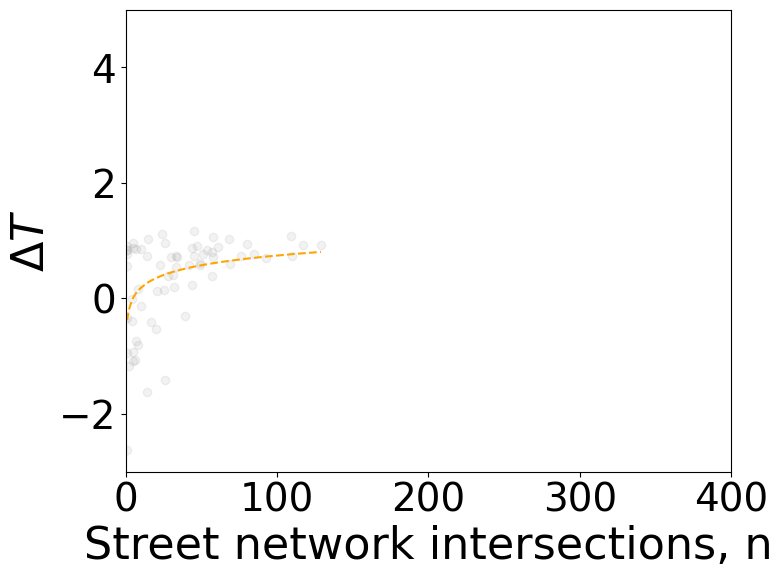

Marseille


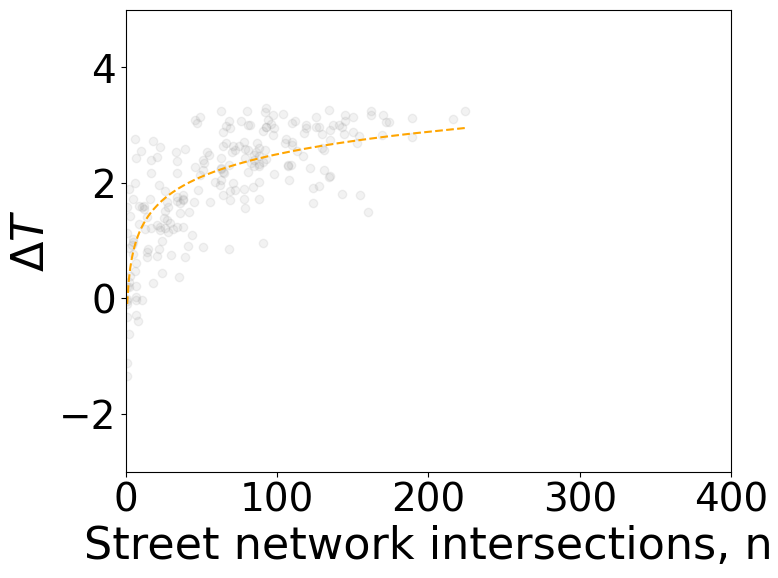

Palermo


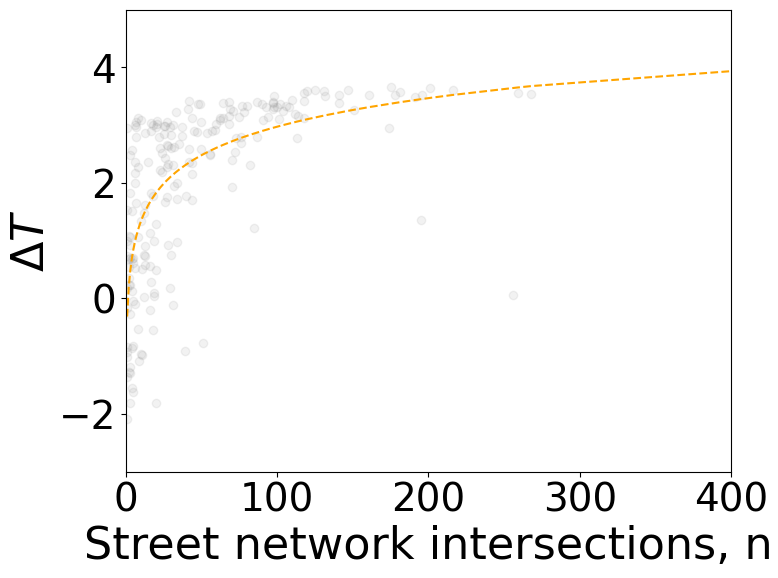

Nice


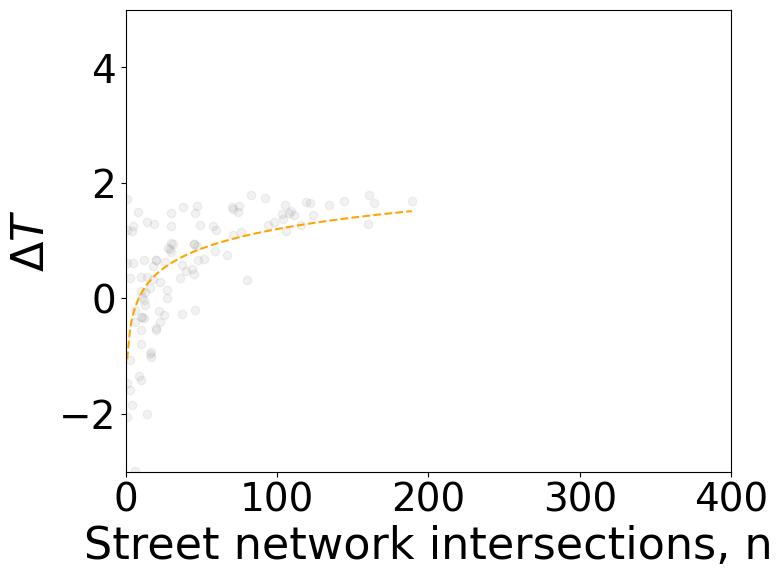

Malaga


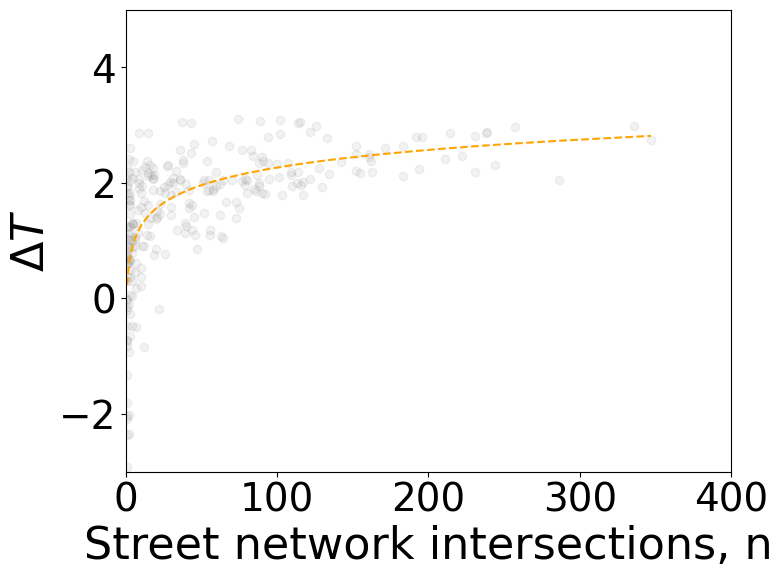

Bari


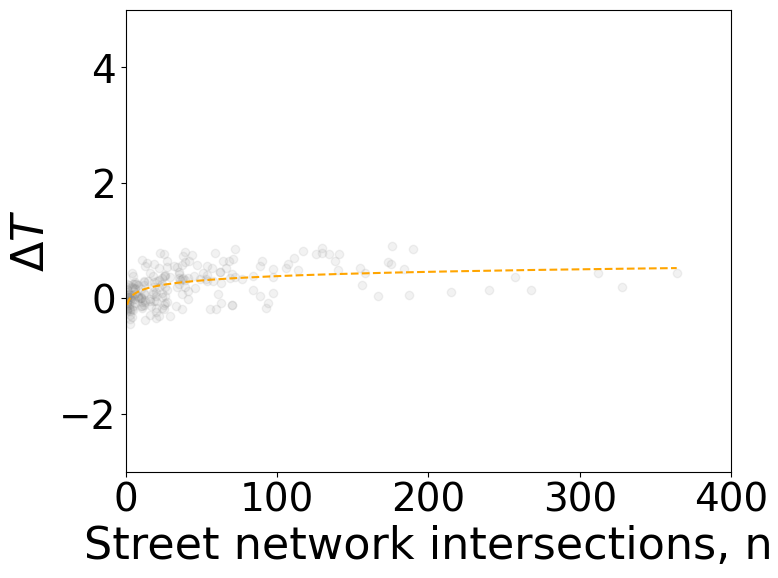

Antwerp


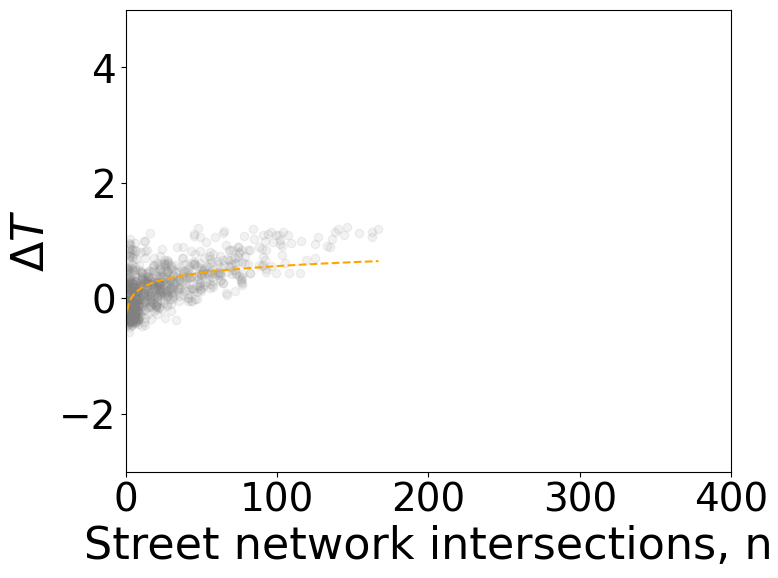

Amsterdam


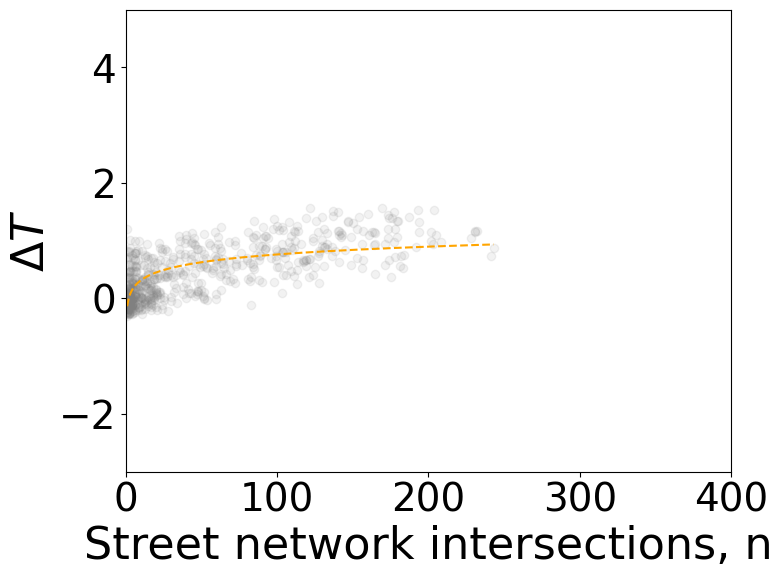

Brussels


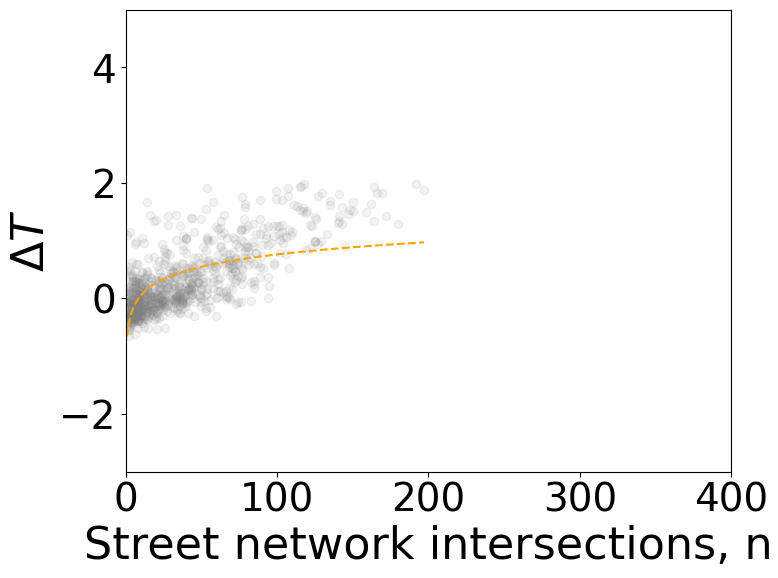

London


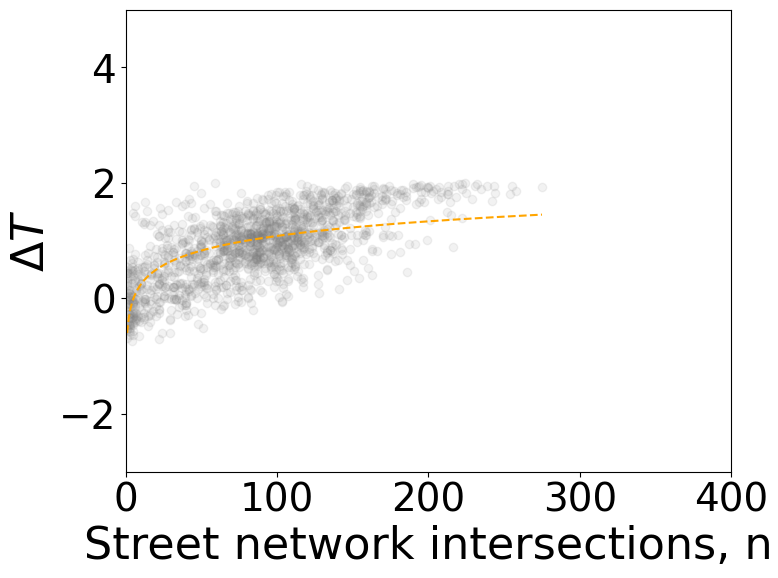

Paris


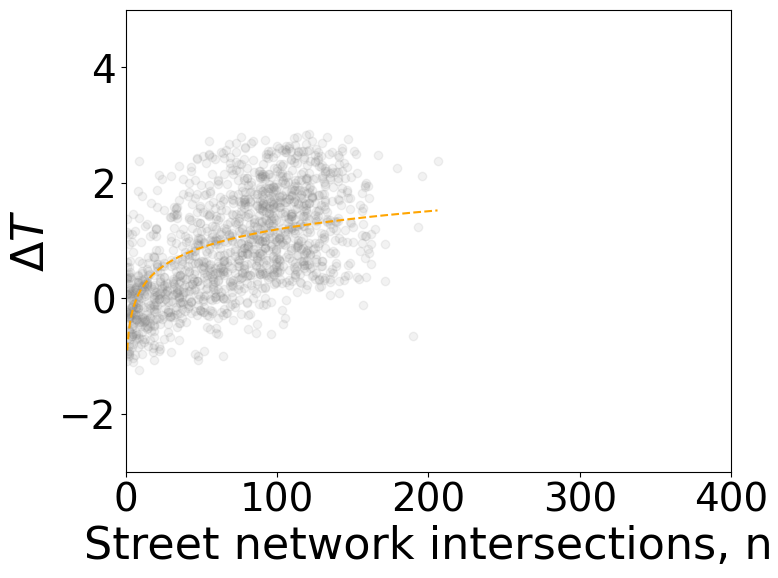

Luxembourg


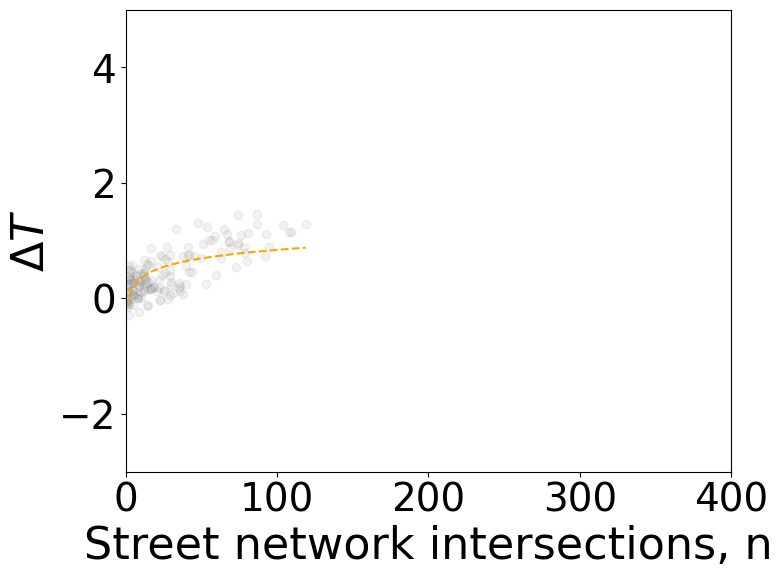

Rotterdam


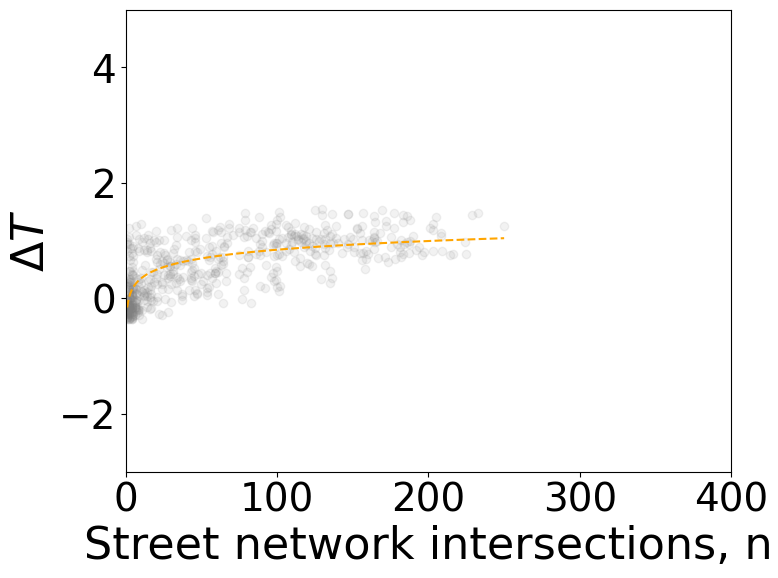

Lille


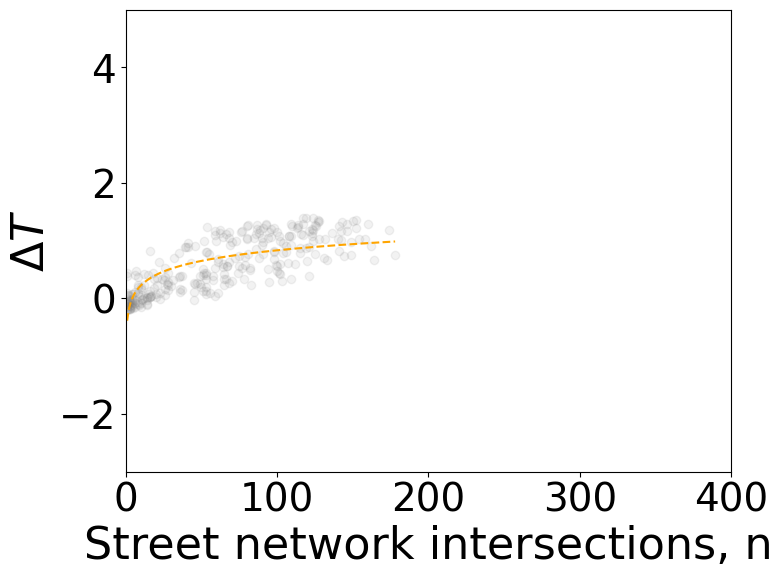

Basel


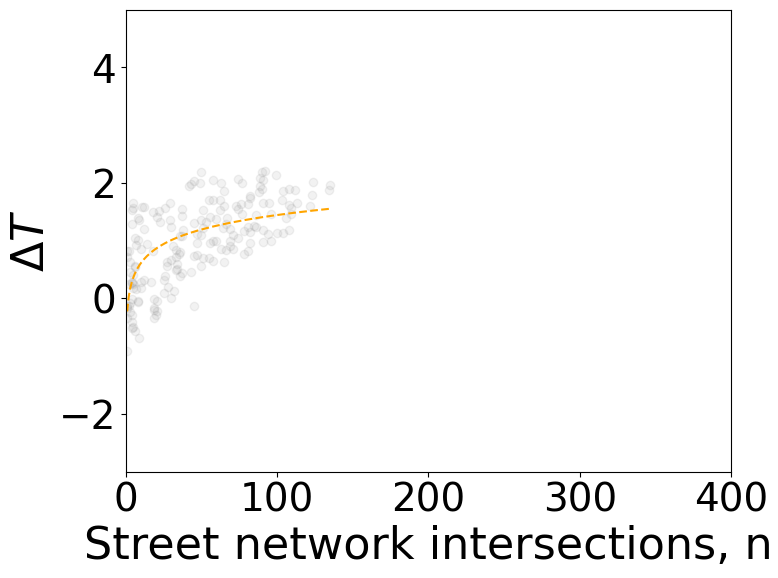

Birmingham


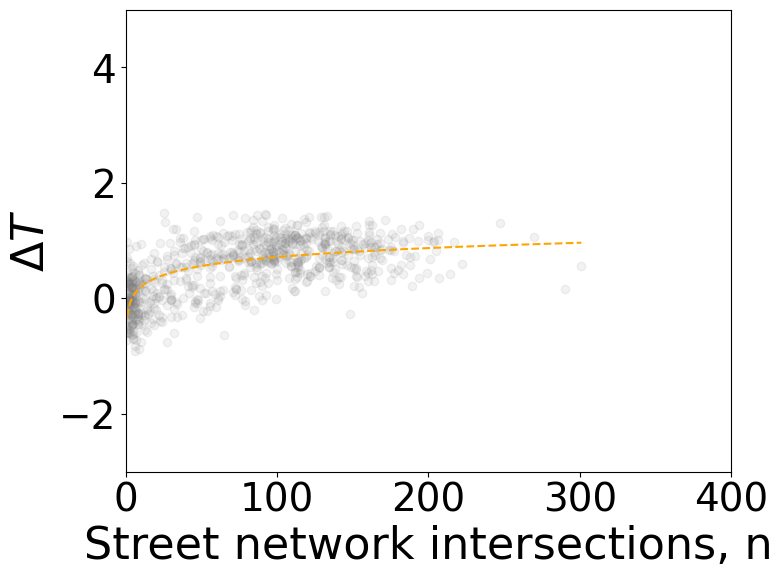

Nantes


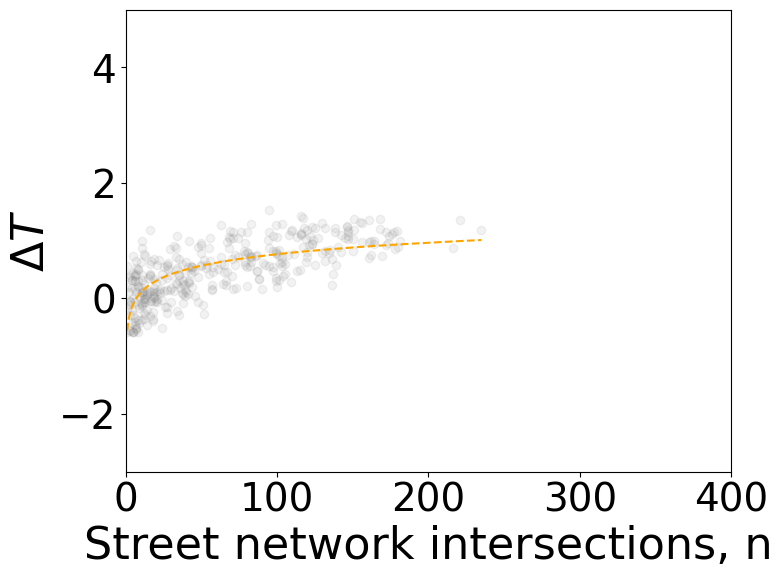

Strasbourg


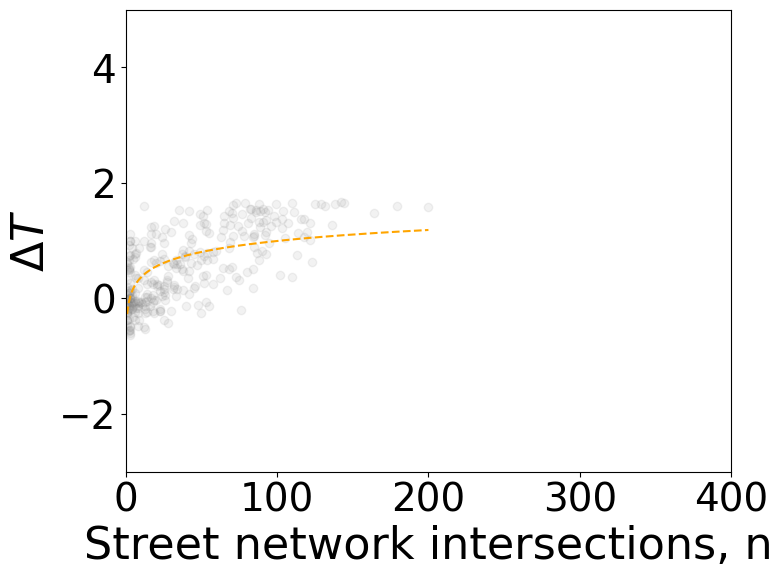

Zurich


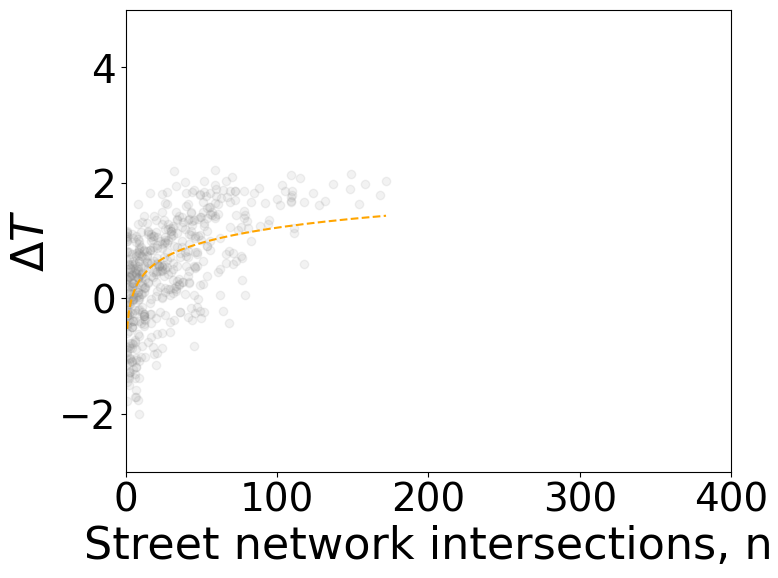

Frankfurt


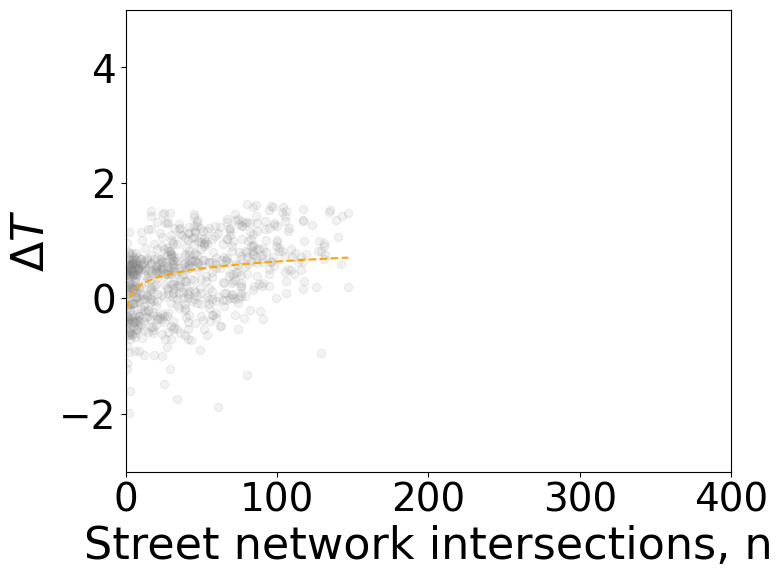

Vienna


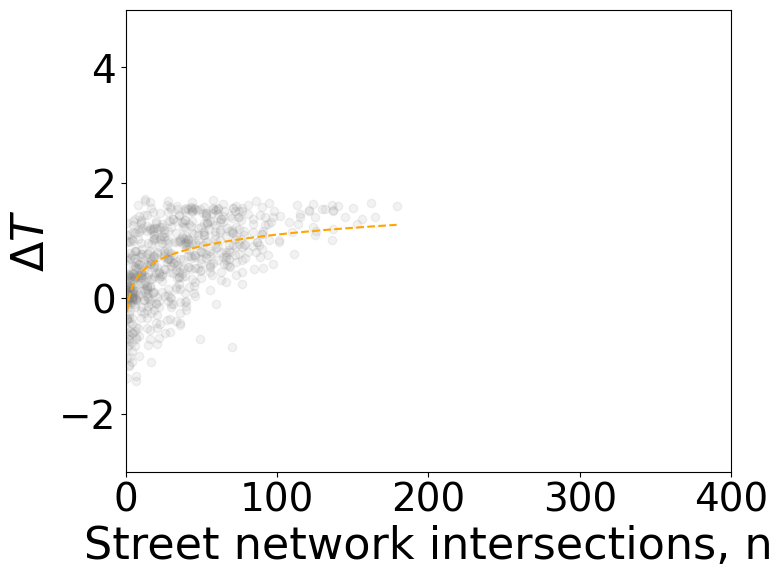

Munich


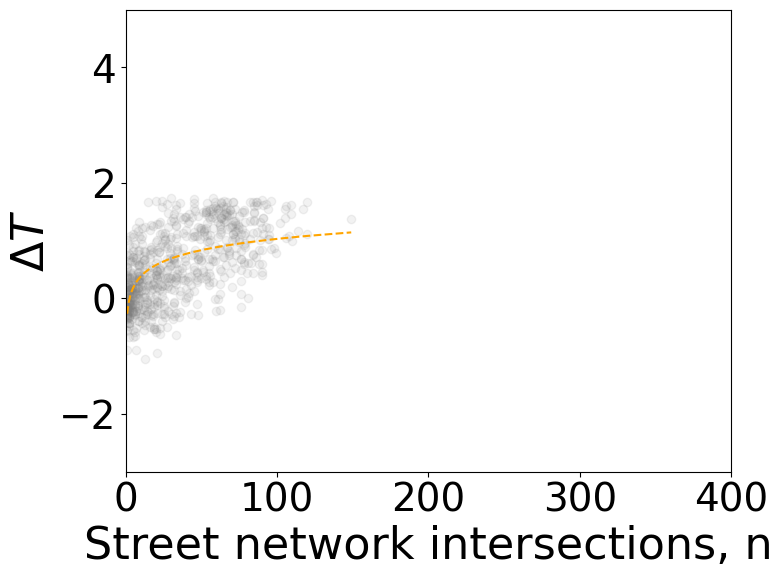

Bratislava


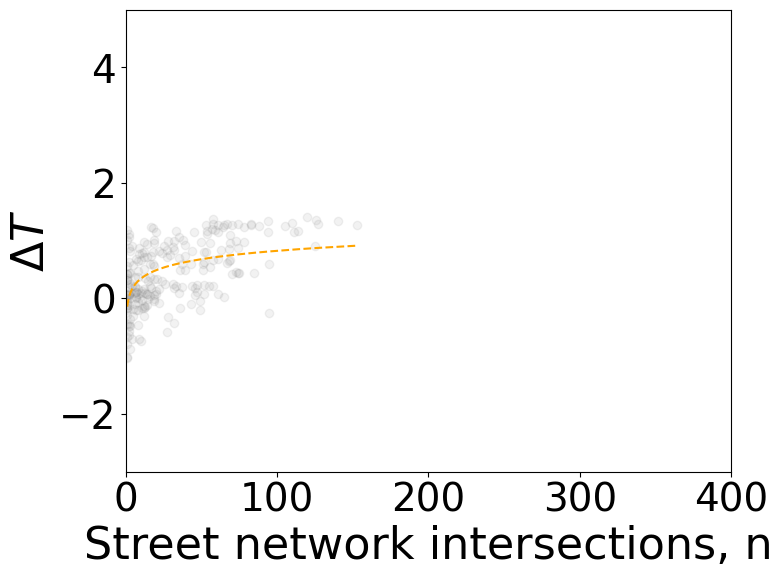

Prague


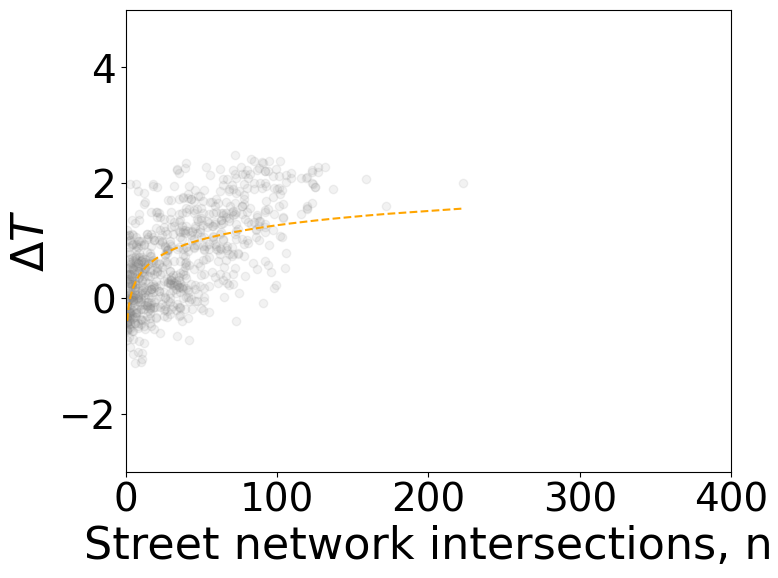

Geneva


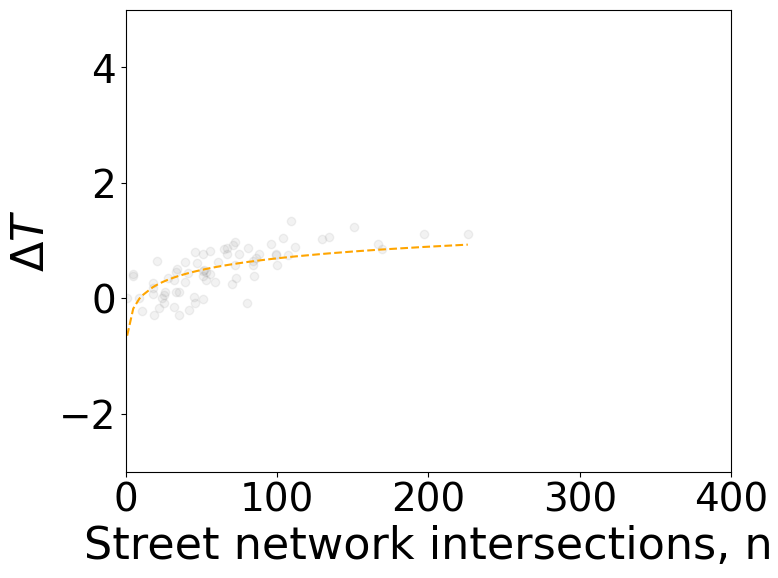

Bordeaux


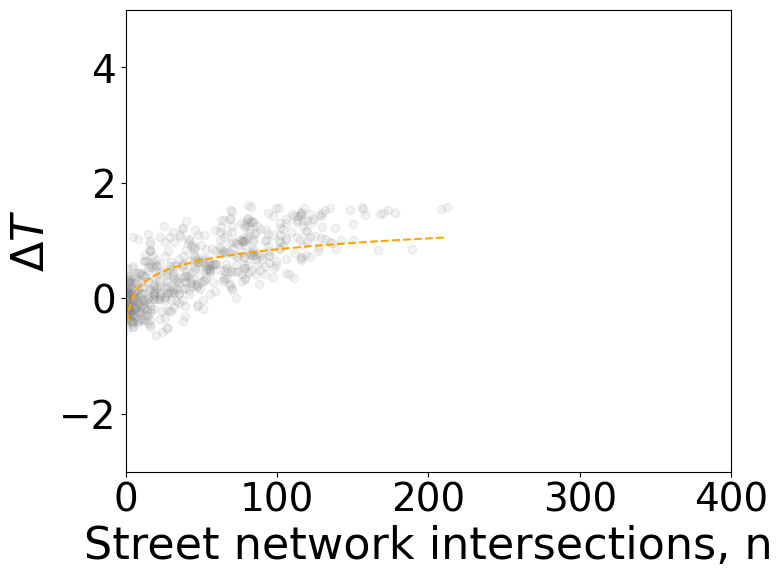

Utrecht


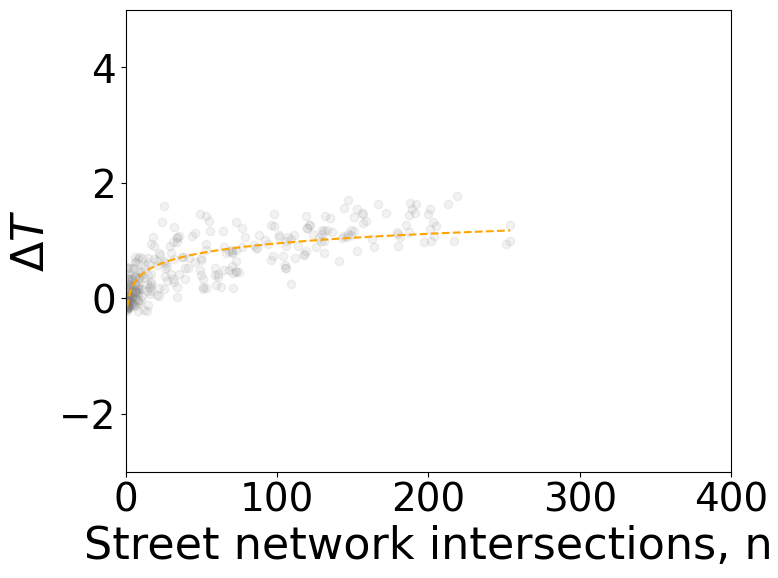

Liege


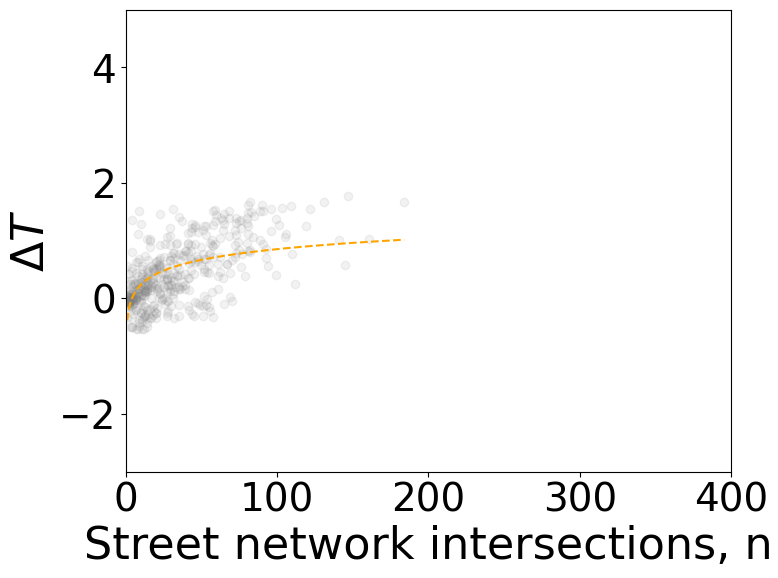

Bilbao


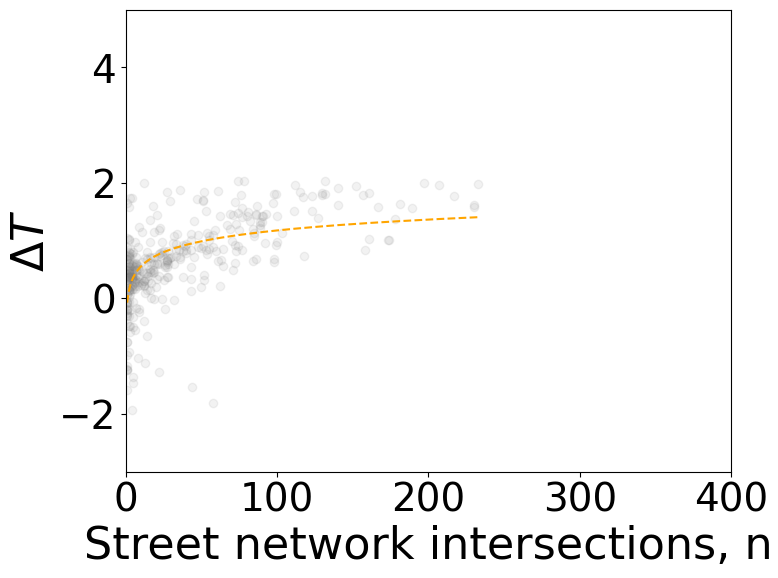

Charleroi


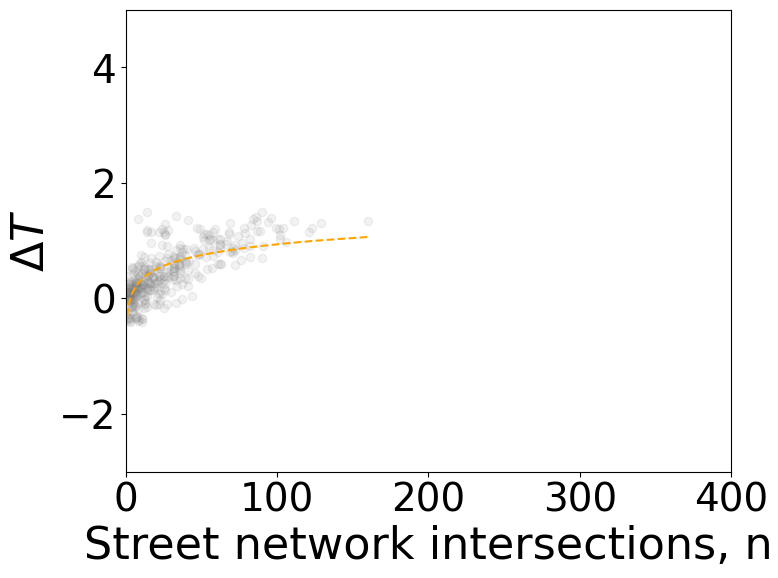

Wroclaw


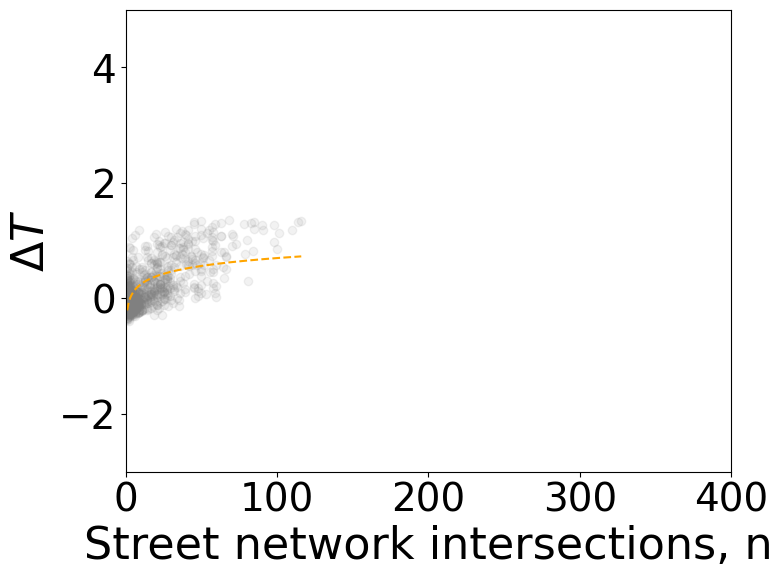

Leipzig


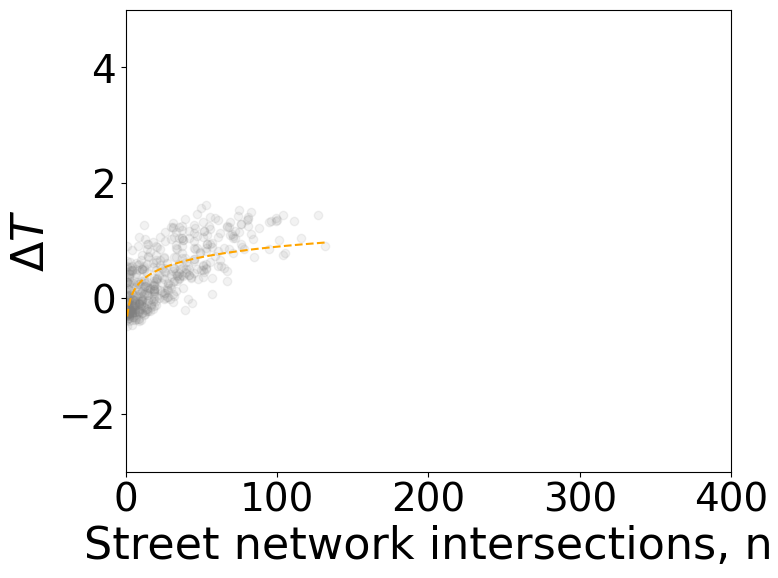

Berlin


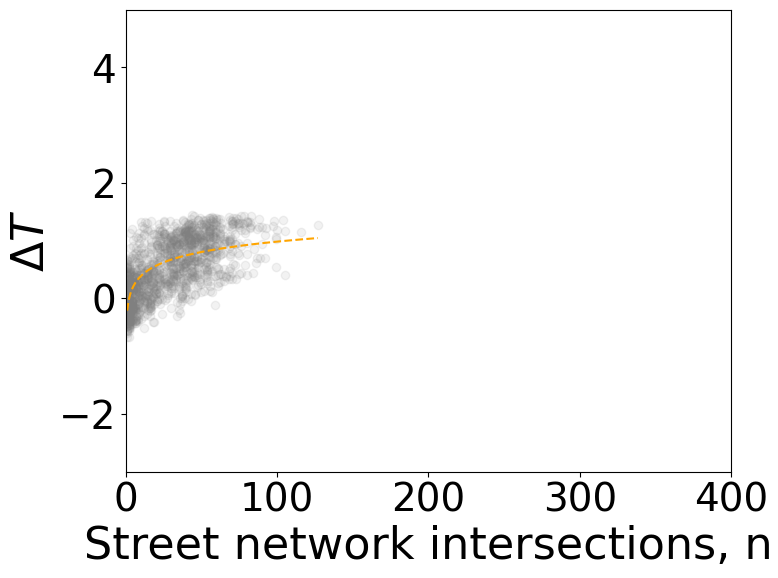

Hamburg


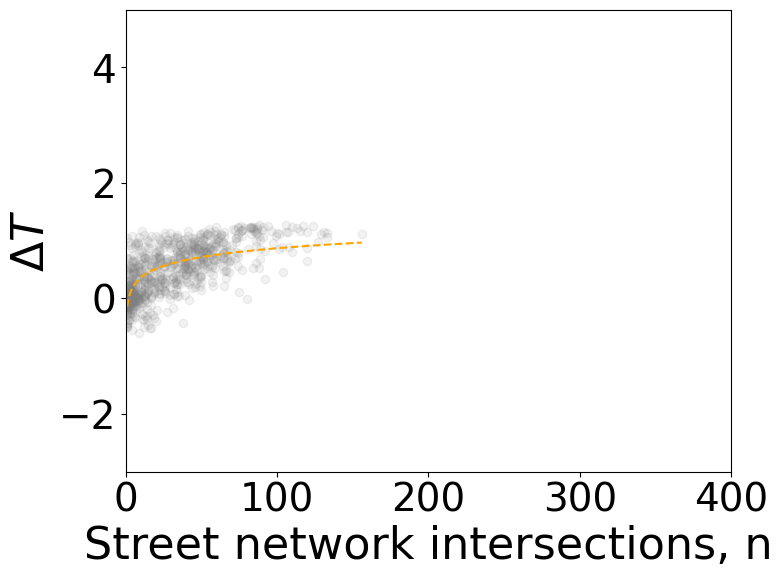

Lodz


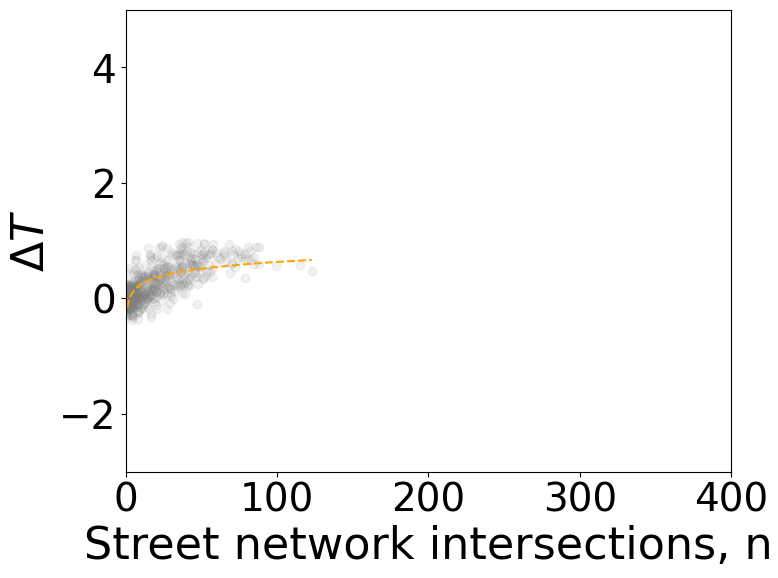

Warsaw


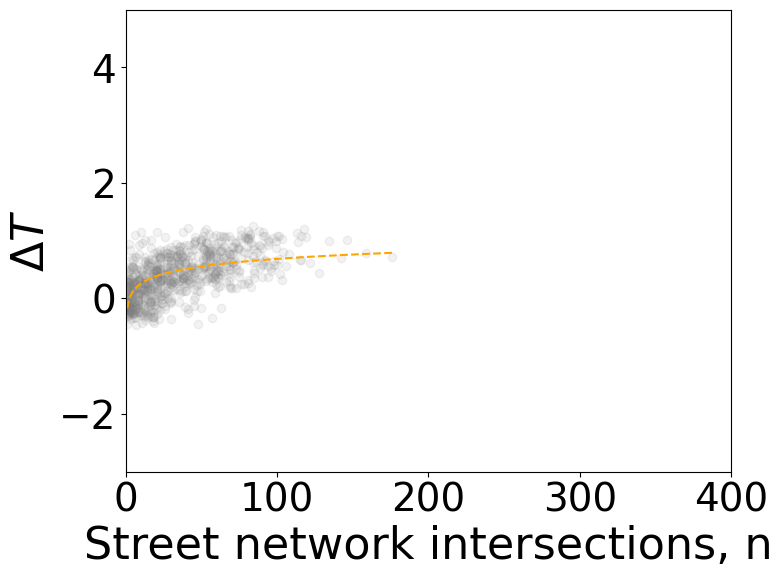

Edinburgh


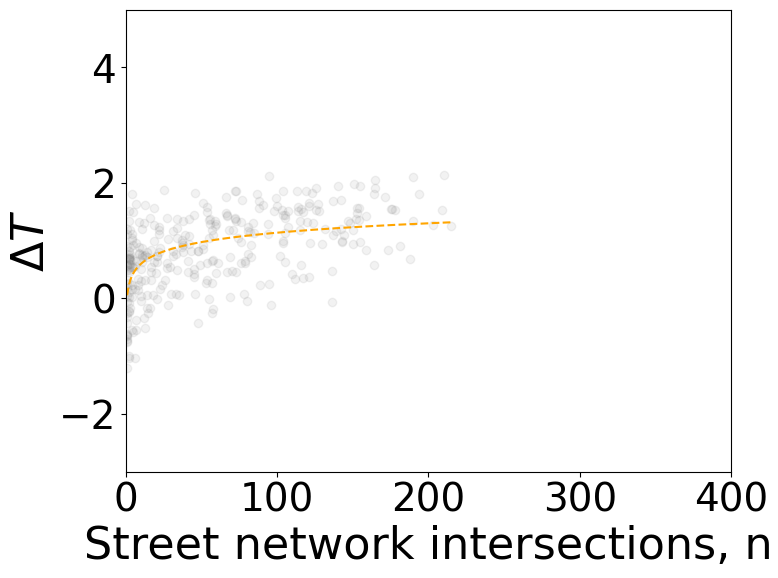

Glasgow


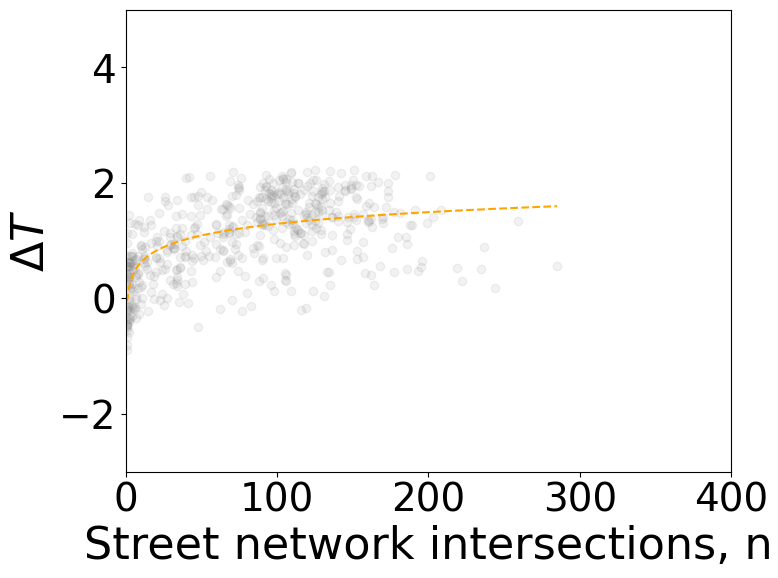

Cologne


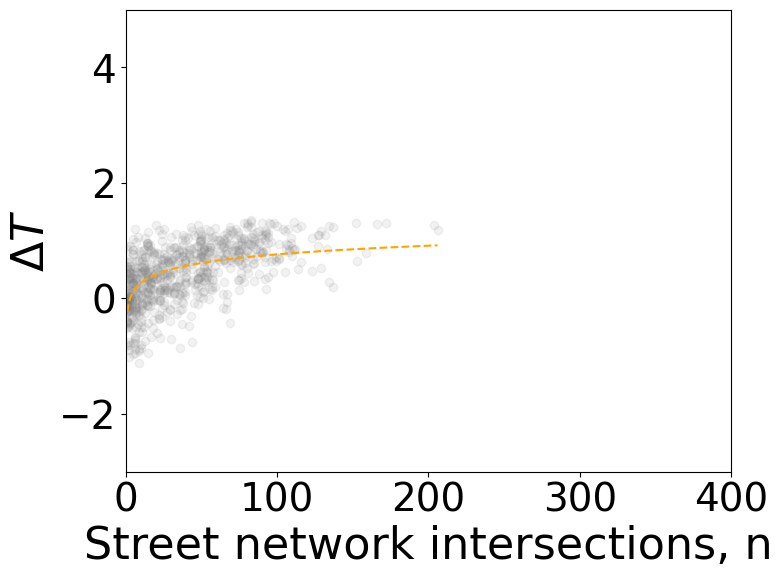

Dusseldorf


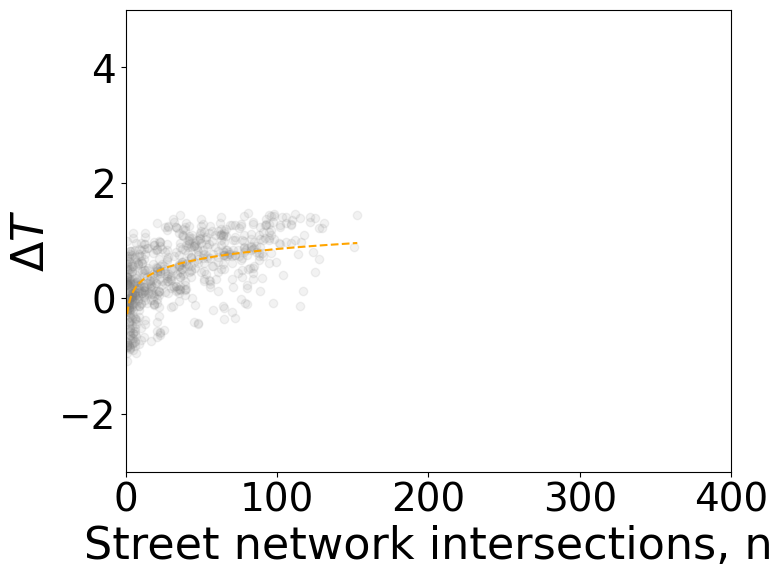

Newcastle


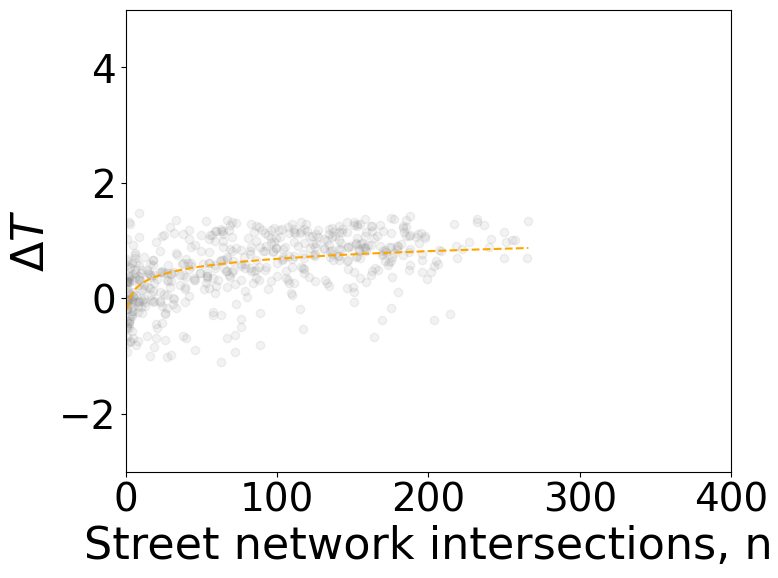

Ghent


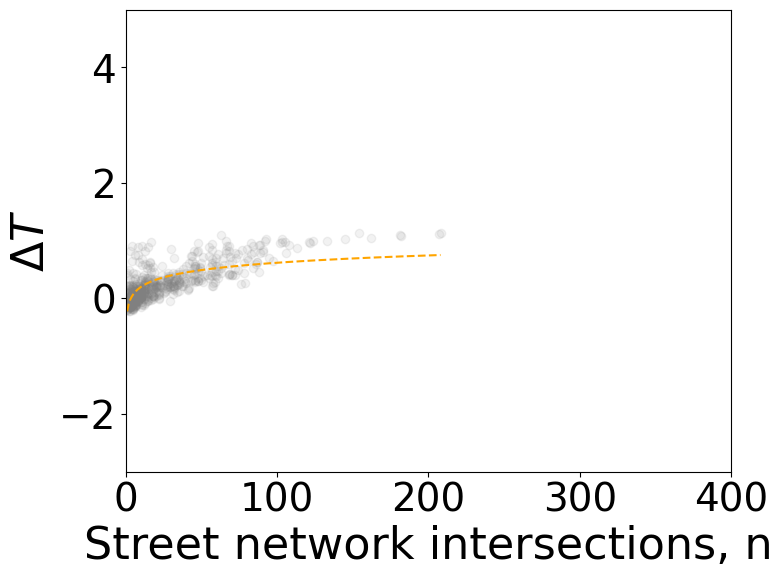

Dublin


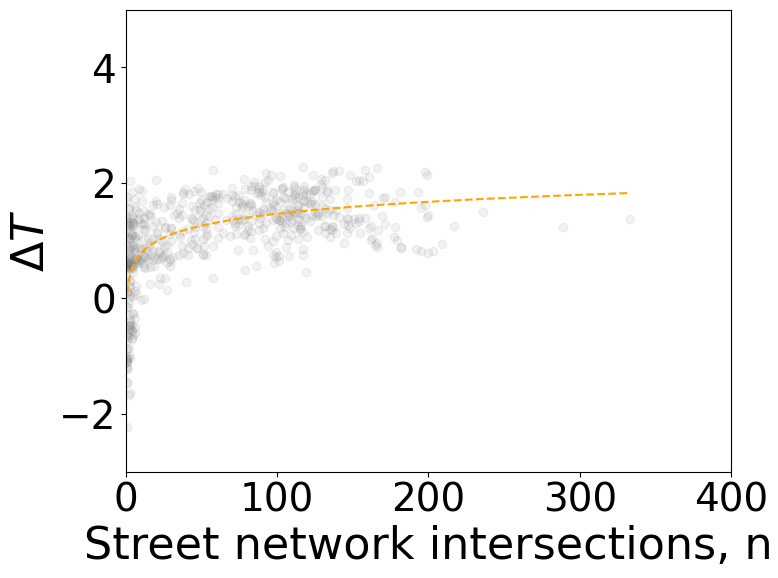

Toulouse


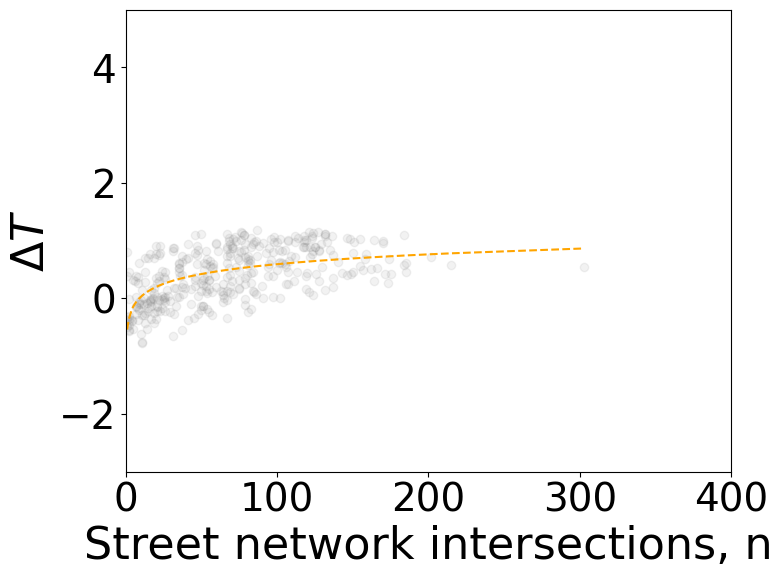

Leeds


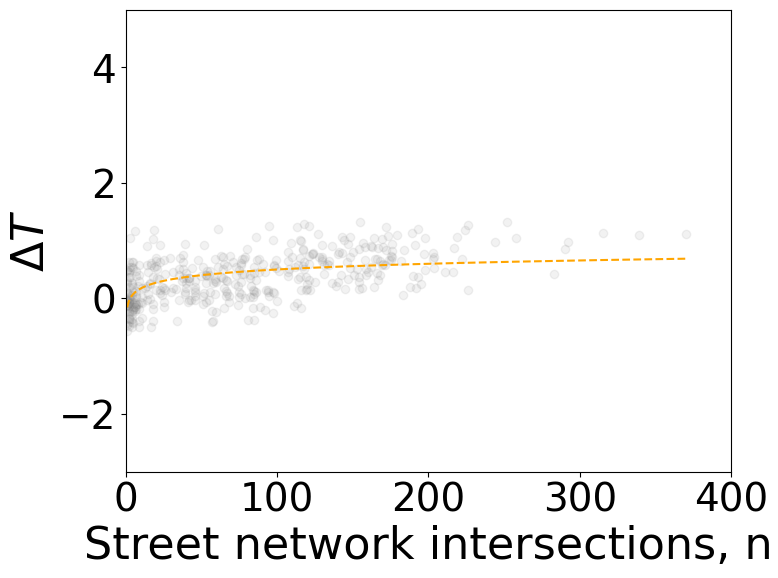

Lyon


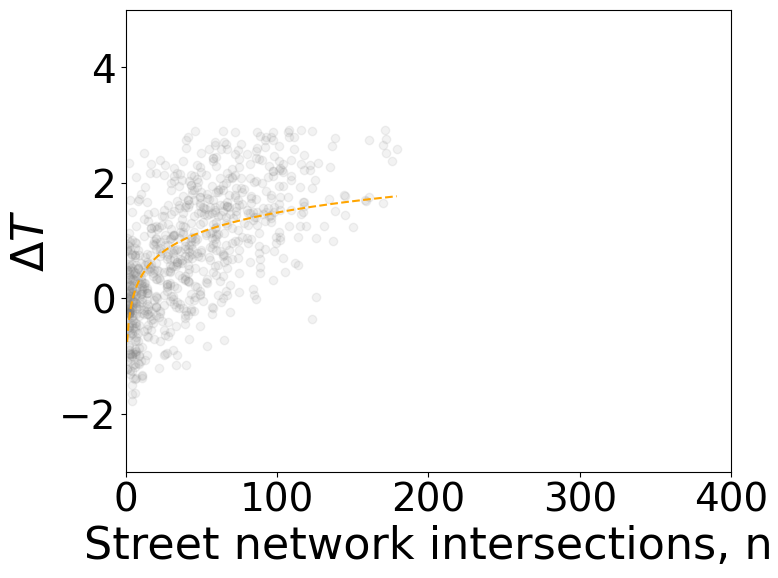

Tallinn


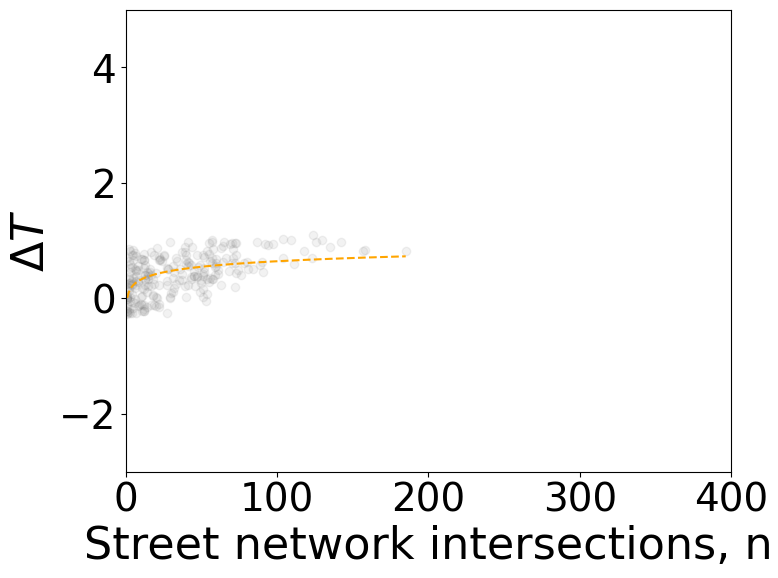

Reykjavik


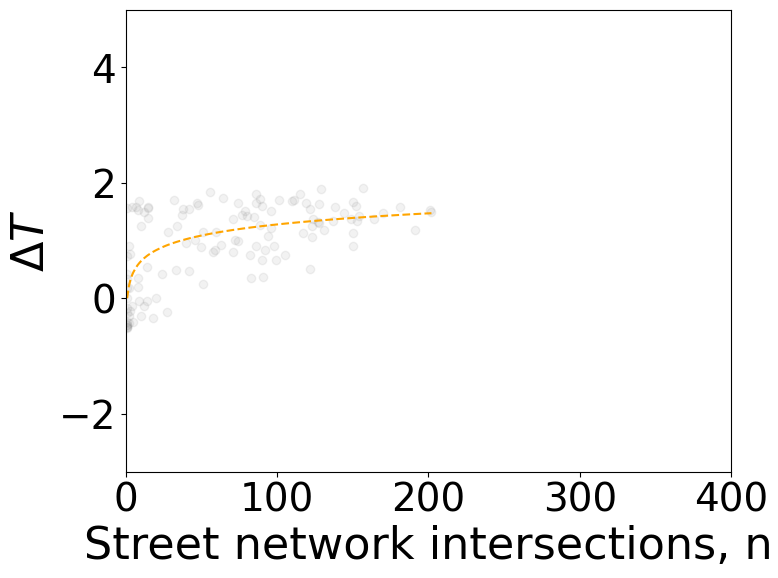

Copenhagen


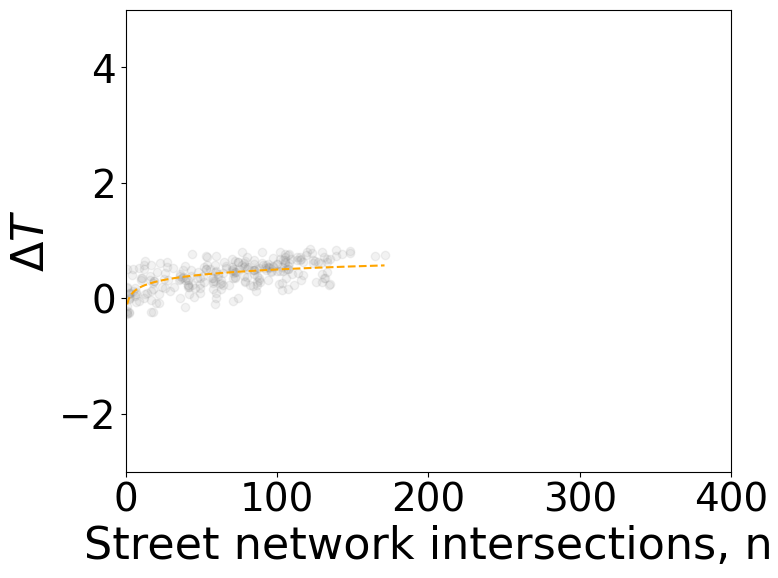

Goteborg


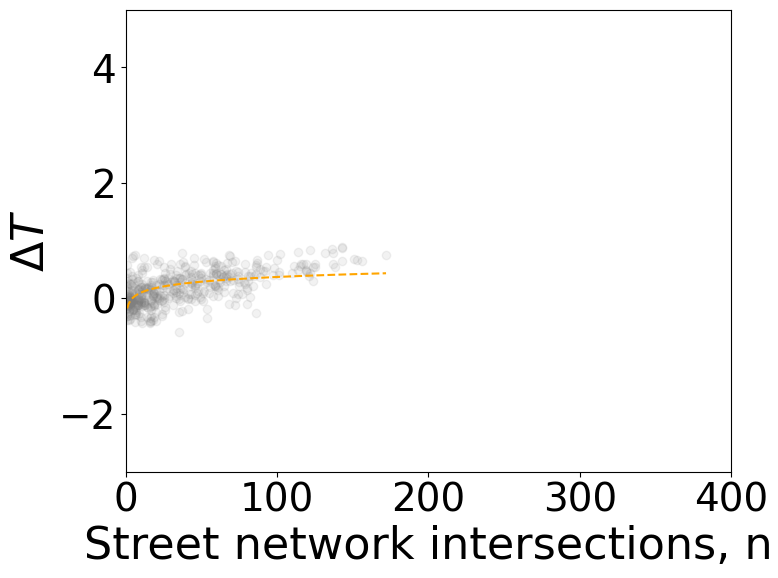

Helsinki


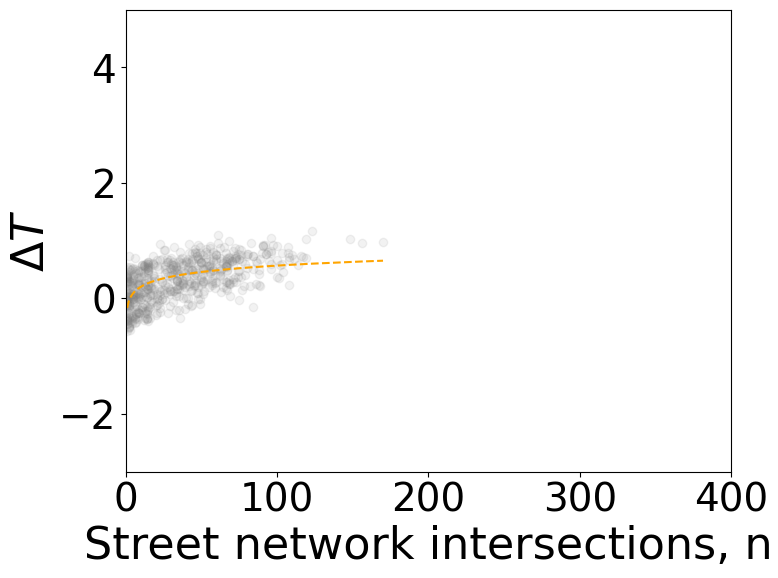

Stockholm


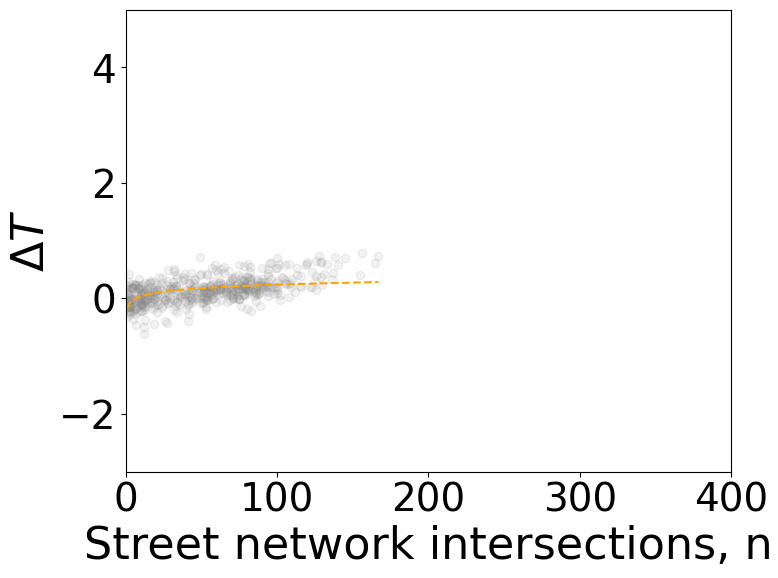

Oslo


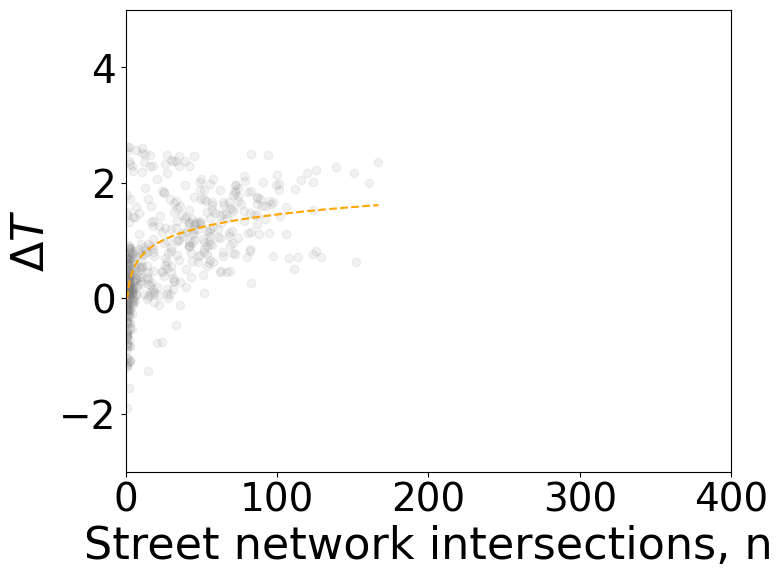

Tartu


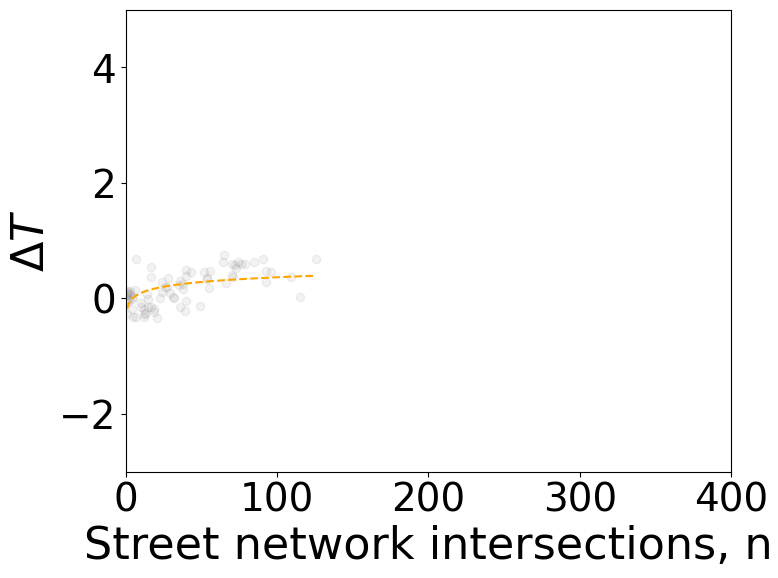

Riga


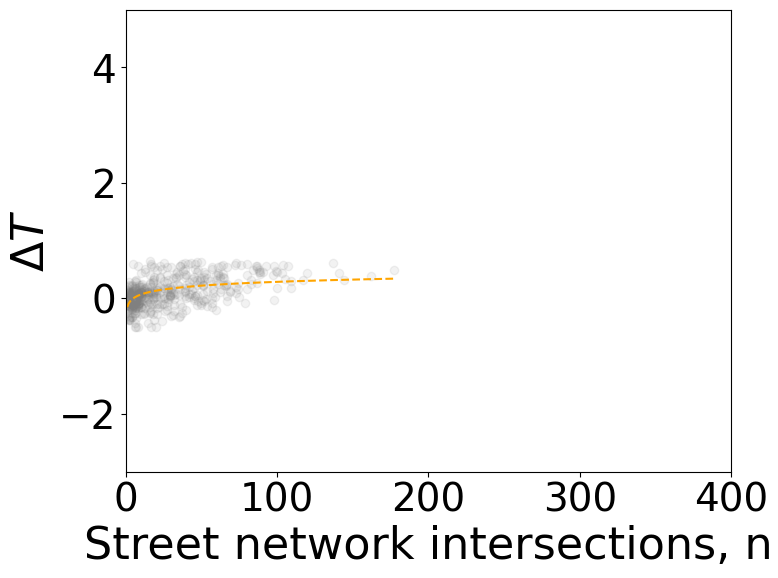

Klaipeda


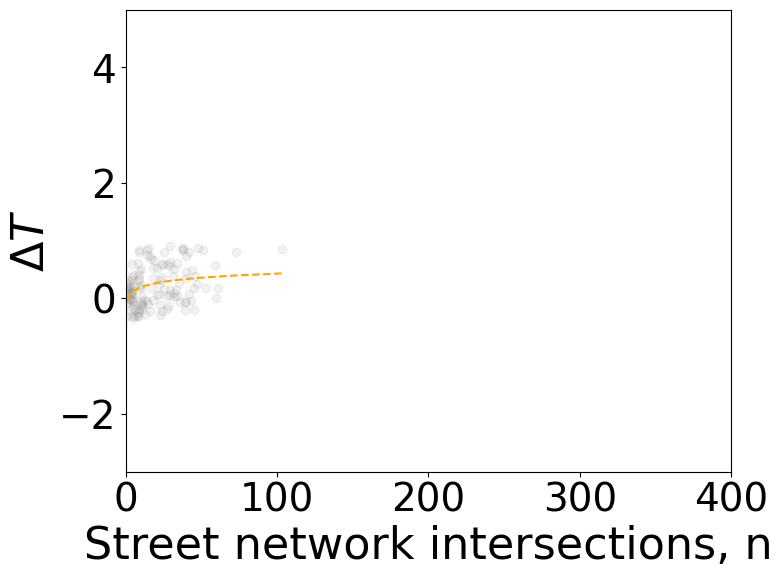

Vilnius


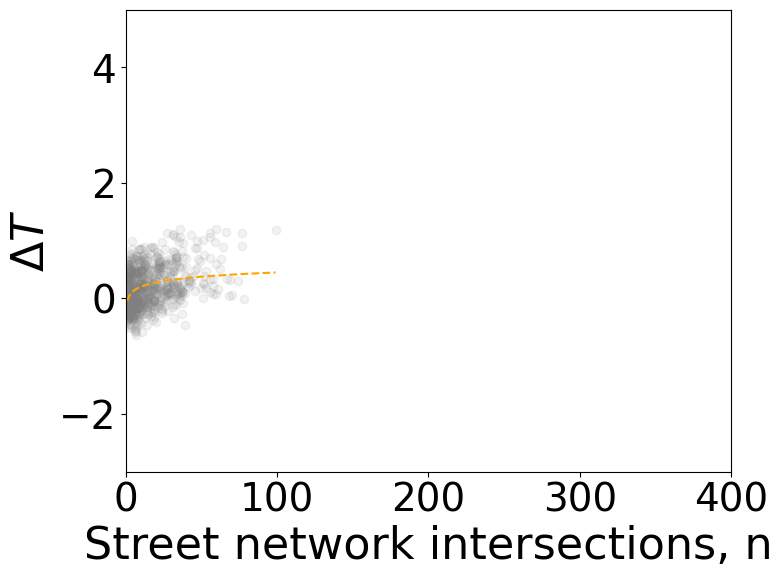

Gdansk


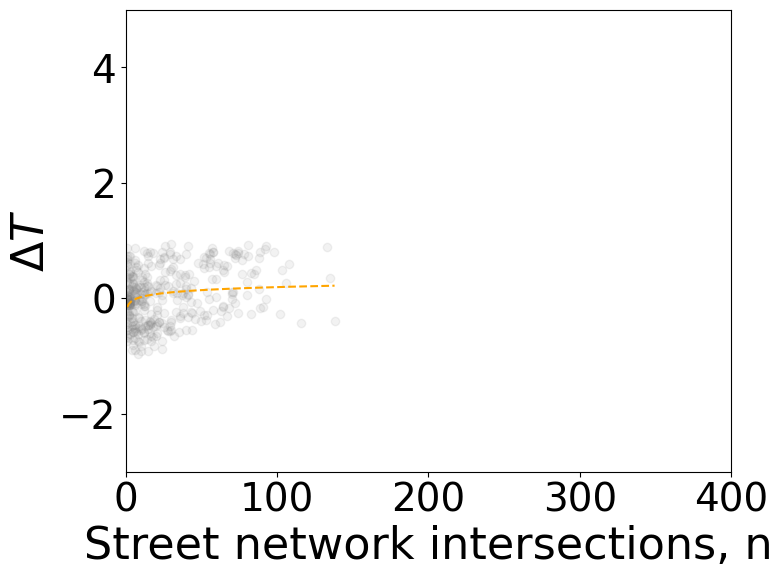

Sofia


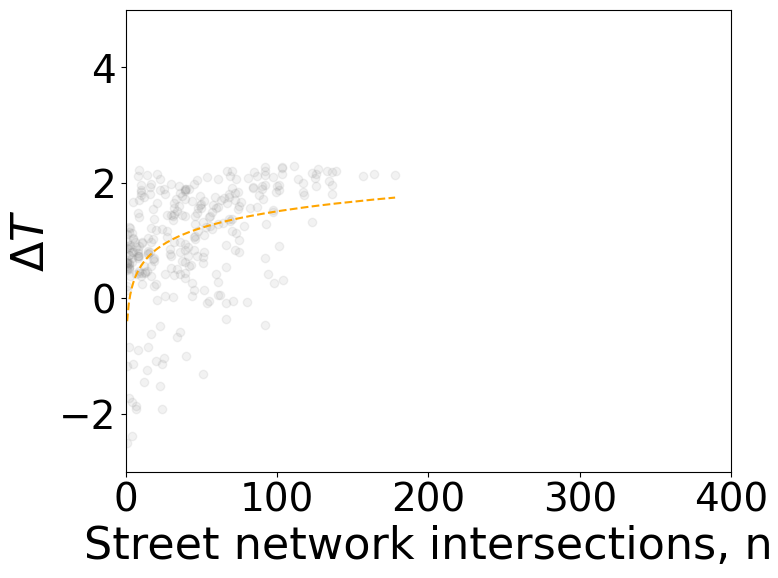

Zagreb


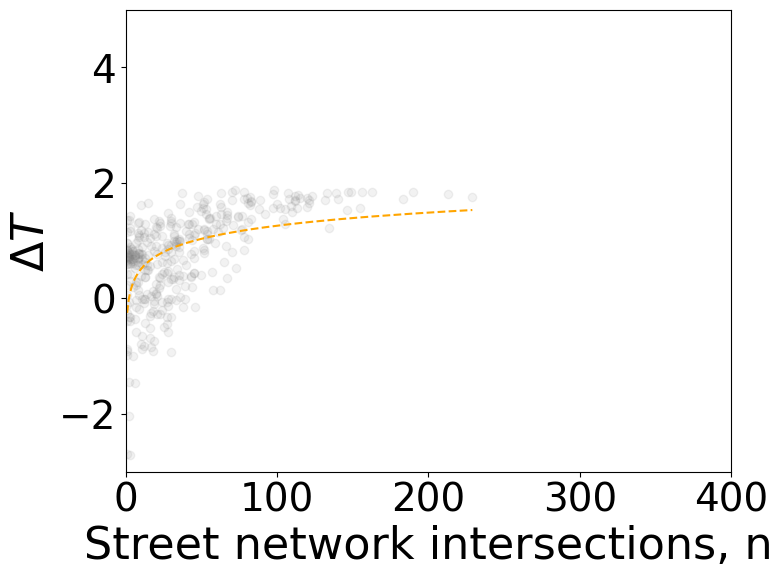

Budapest


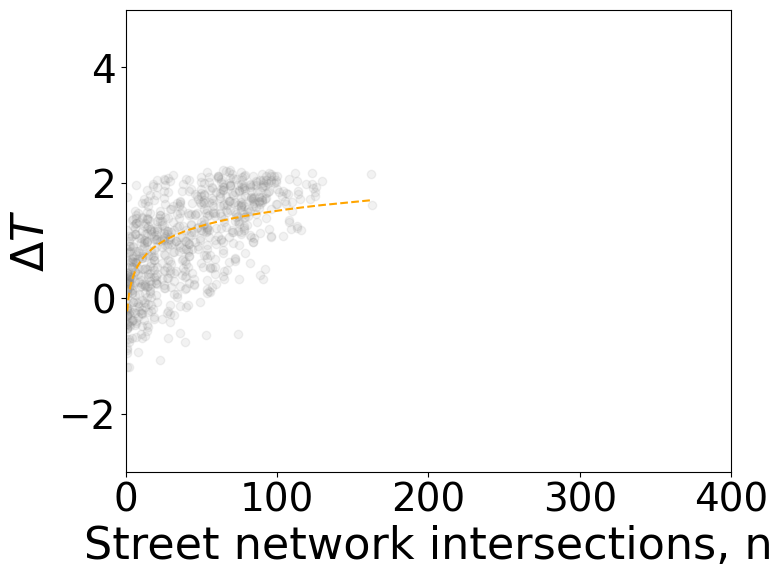

Szeged


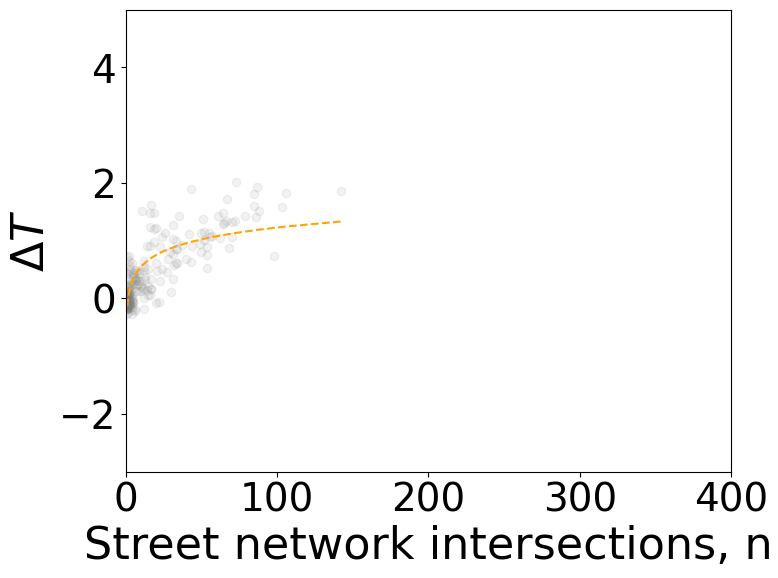

Brasov


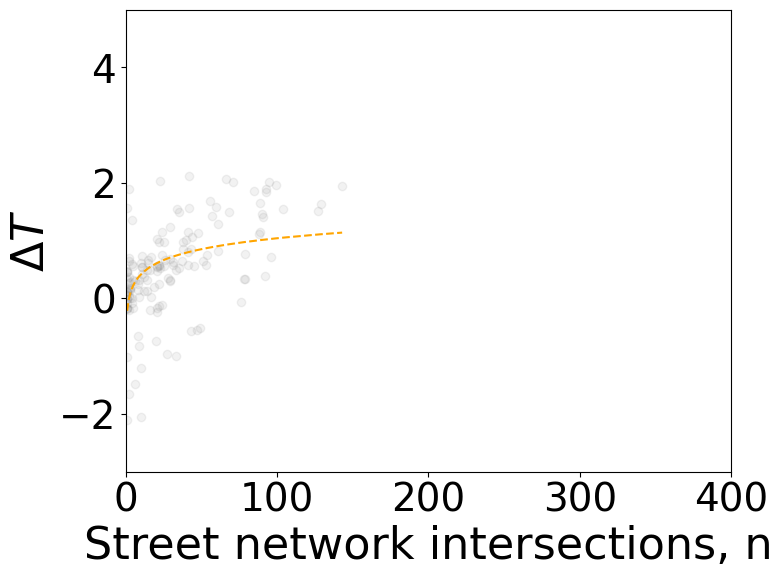

Bucharest


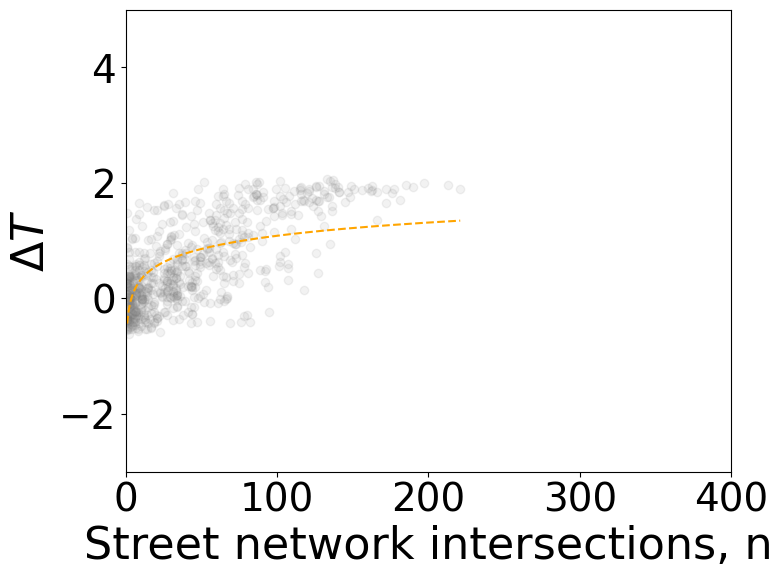

Ljubljana


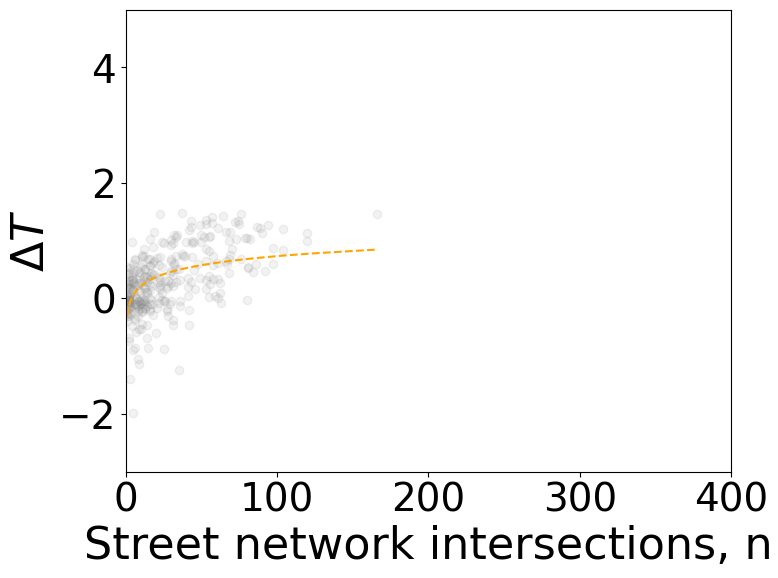

Sarajevo


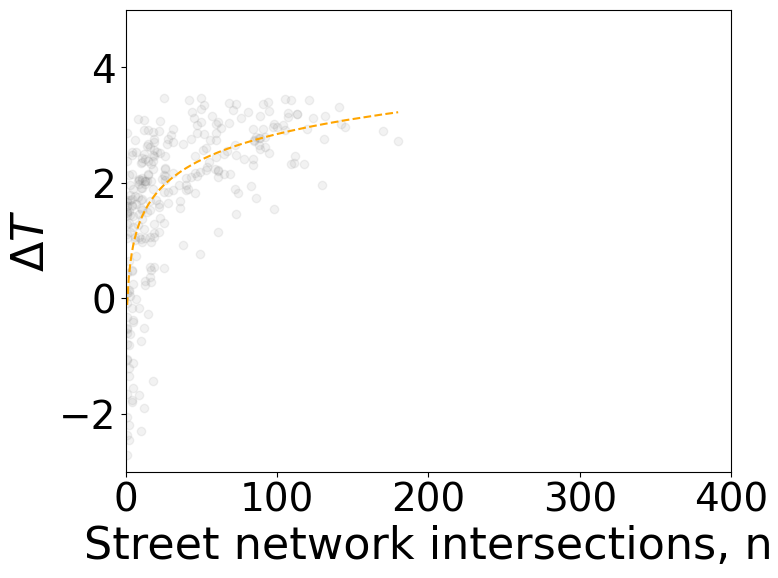

Gyor


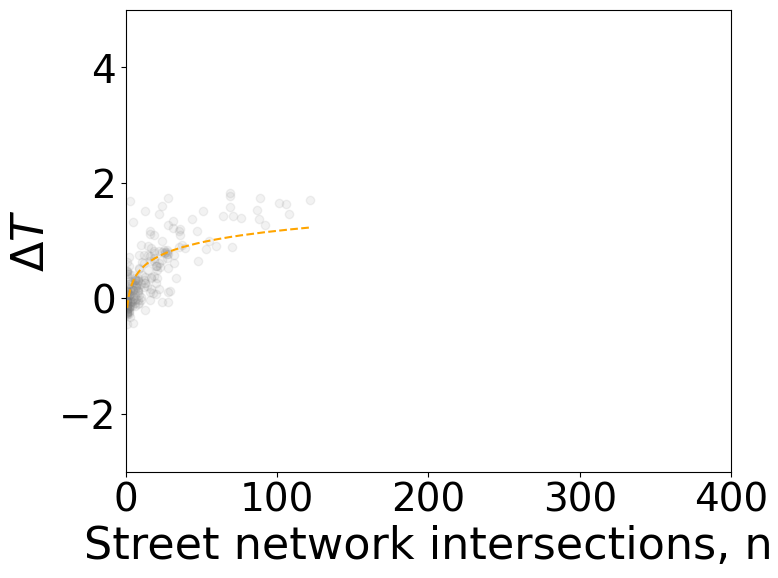

Thessaloniki


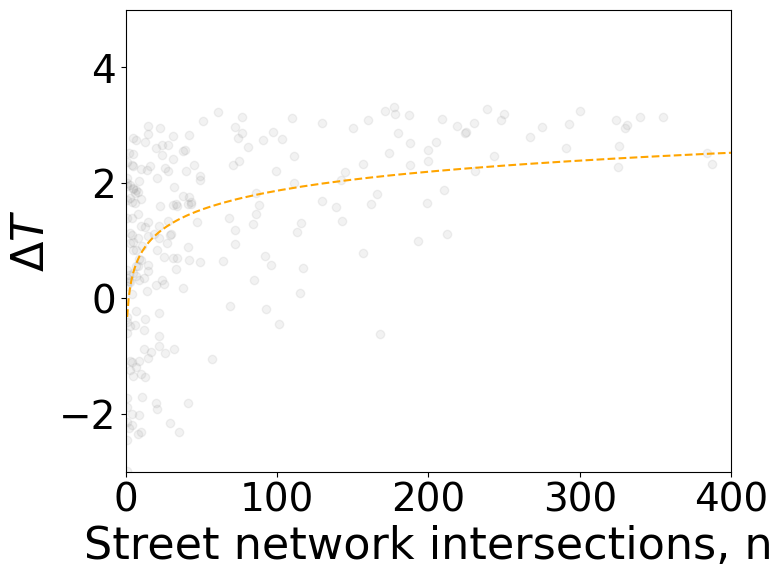

Debrecen


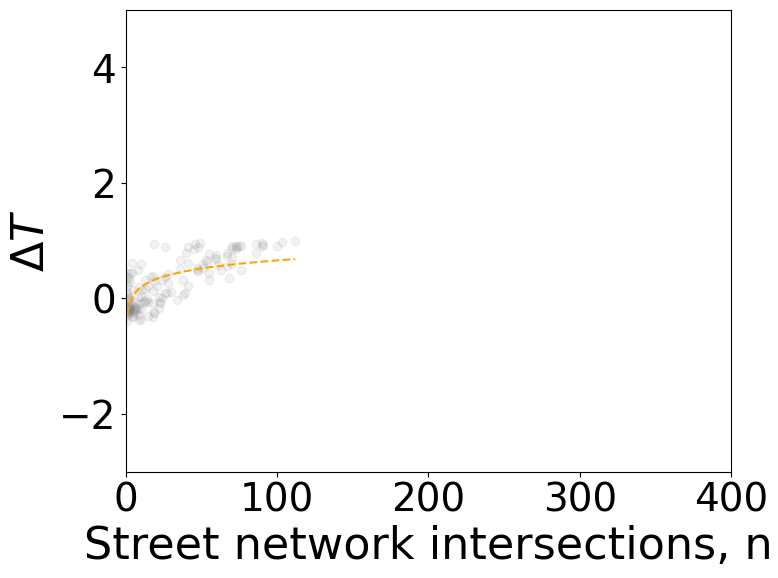

Belgrado


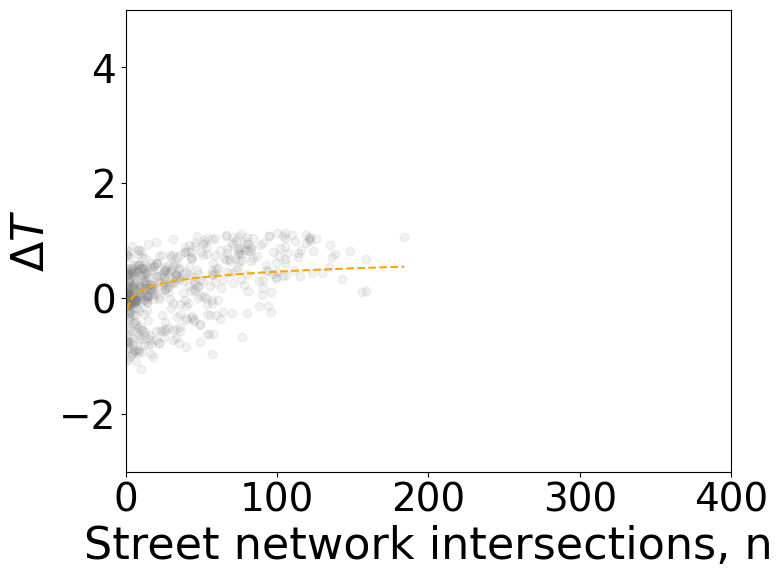

Podgorica


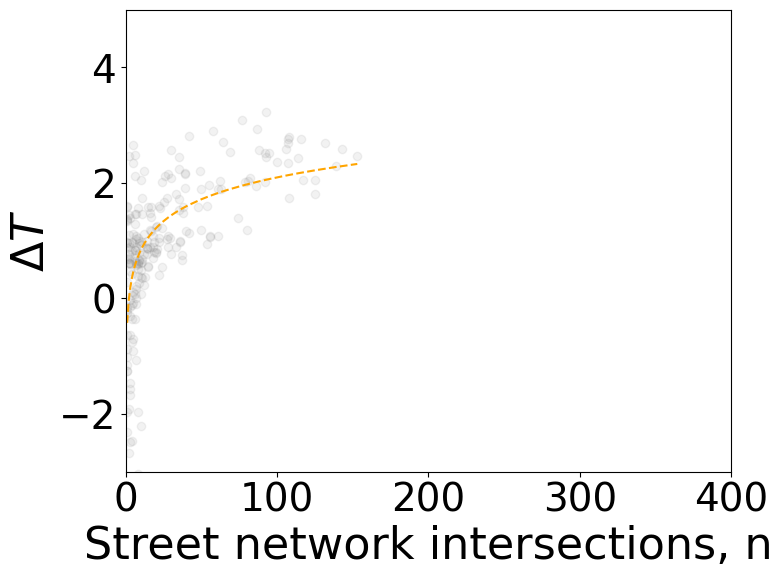

Trieste


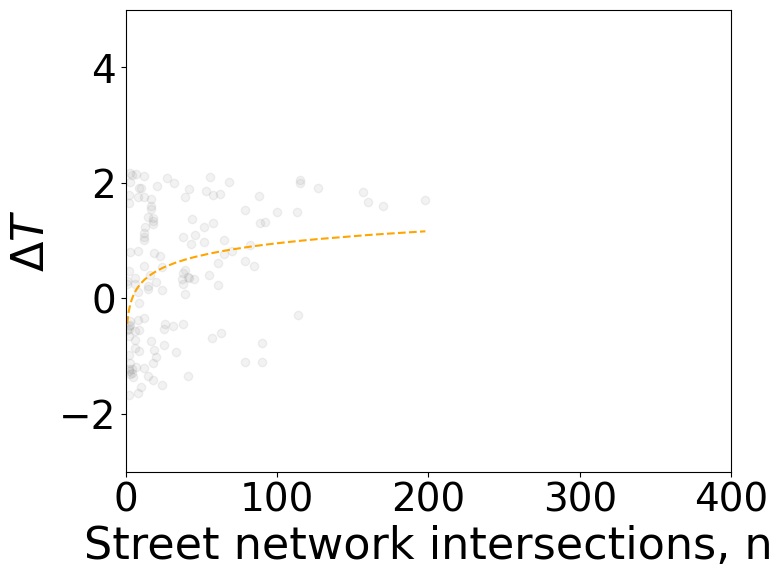

Miskolc


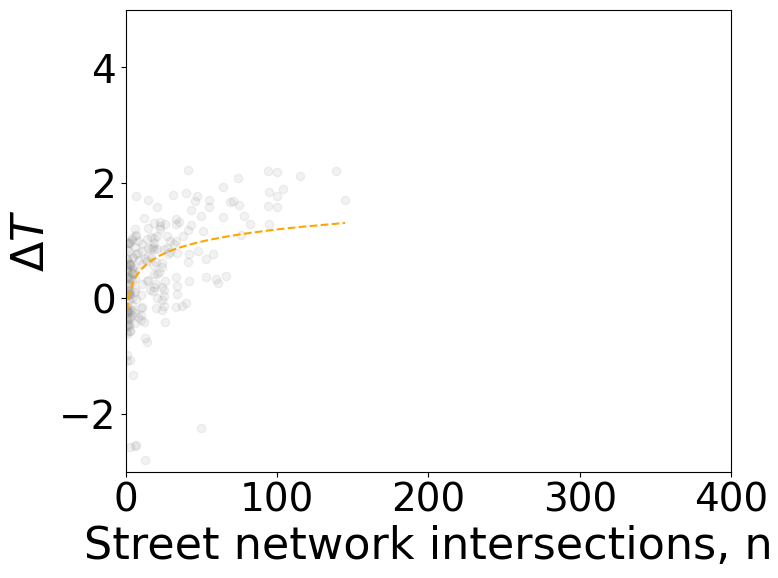

Kosice


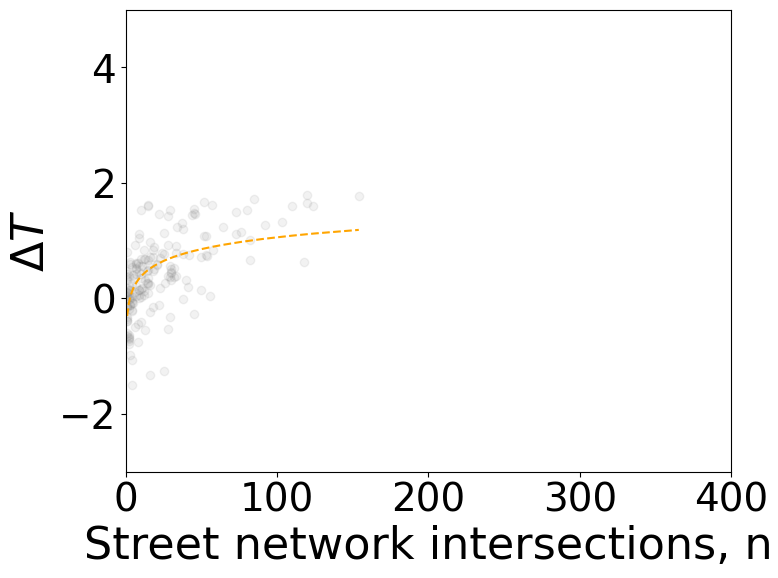

Krakow


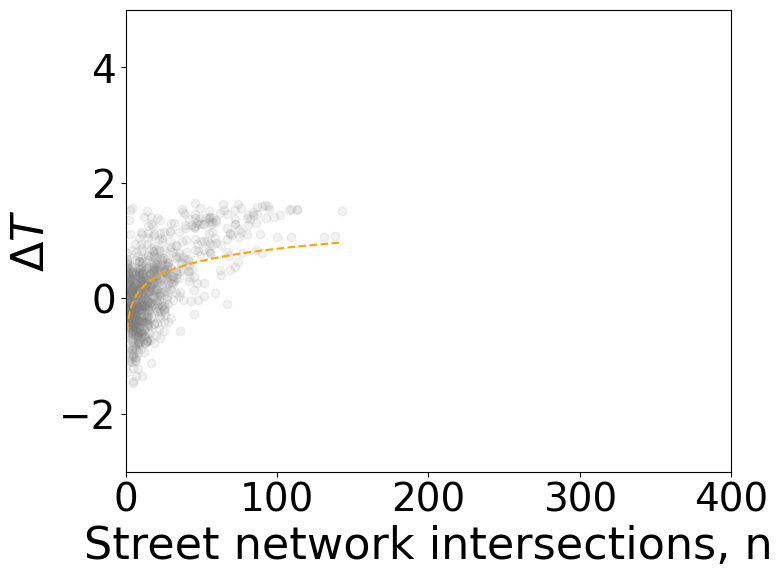

Pecs


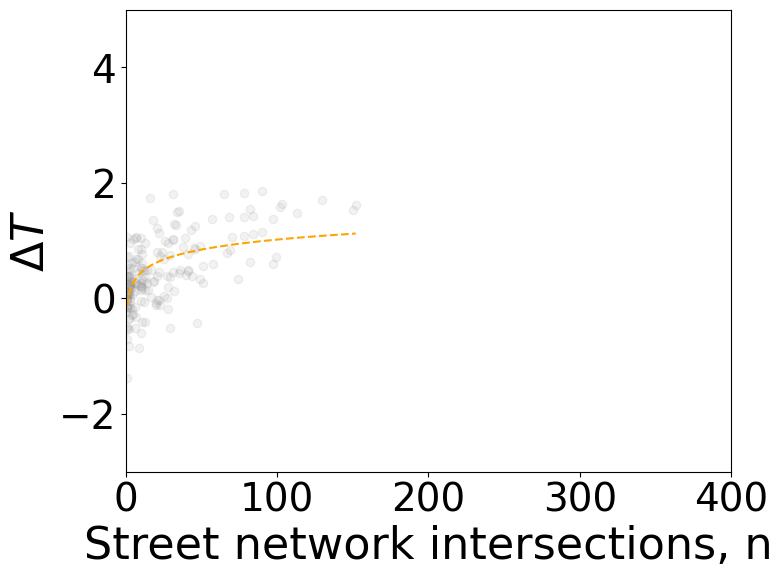

Varna


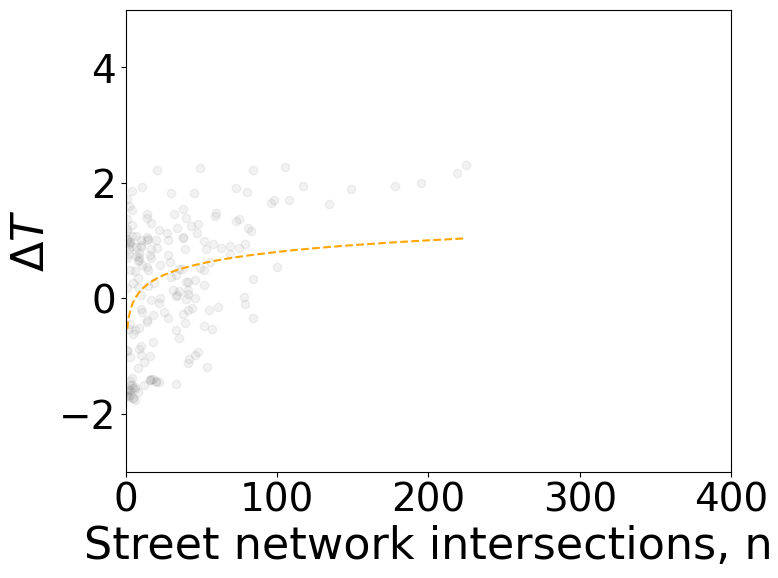

Skopje


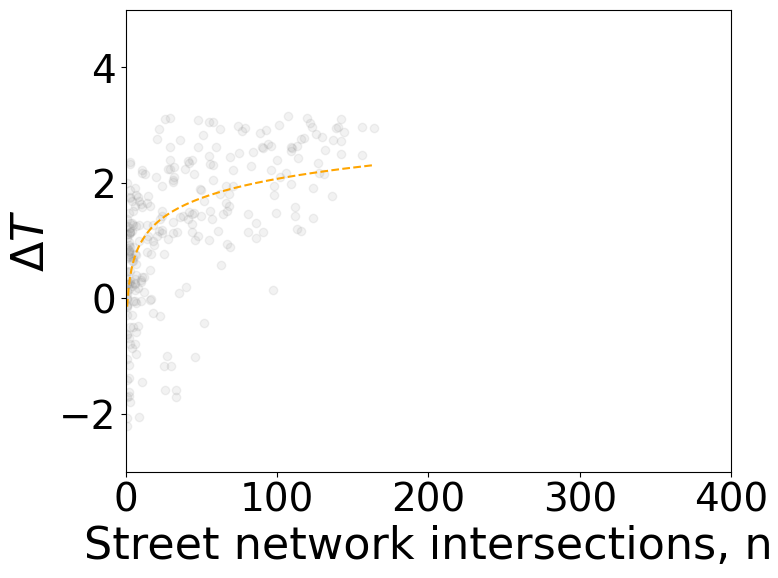

Novi_Sad


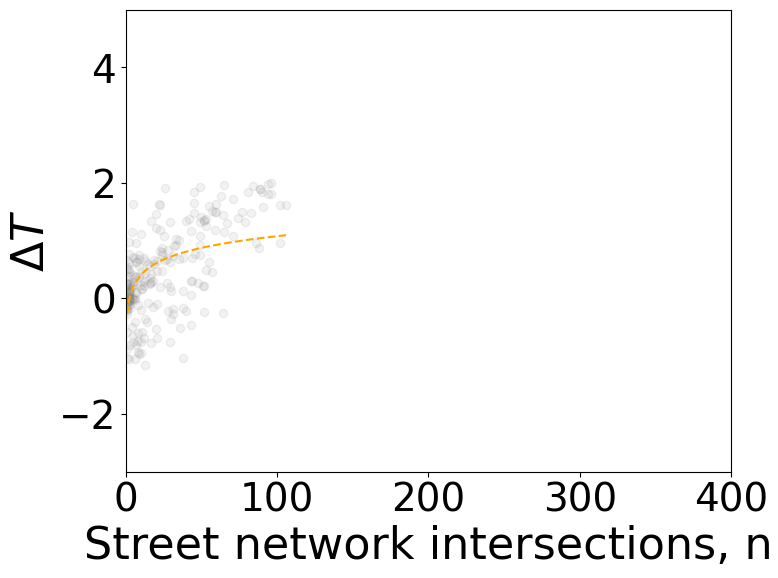

Graz


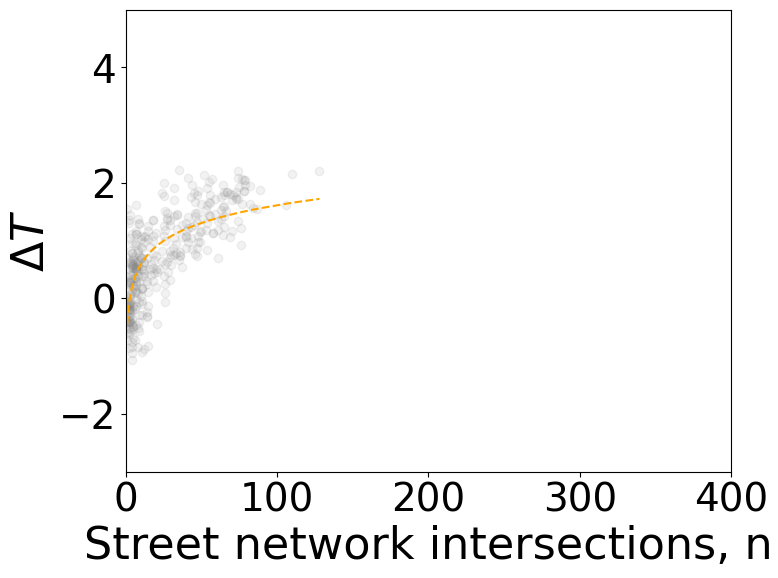

Athens


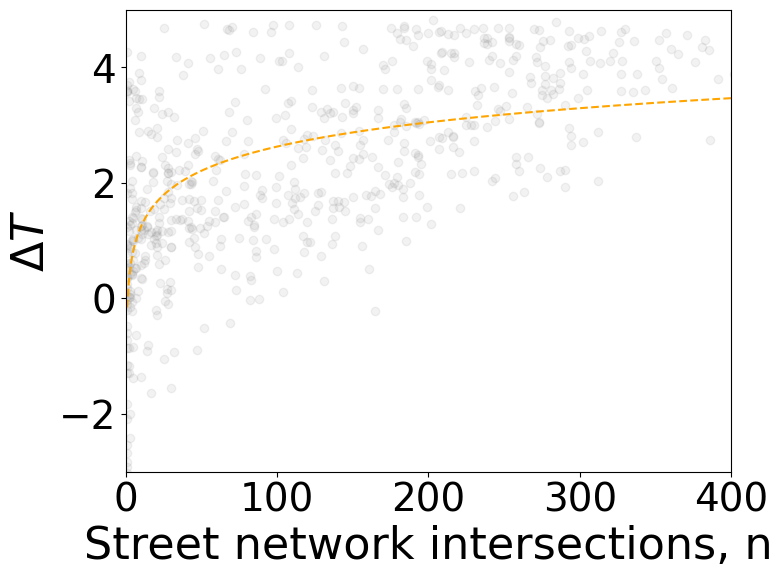

Tirana


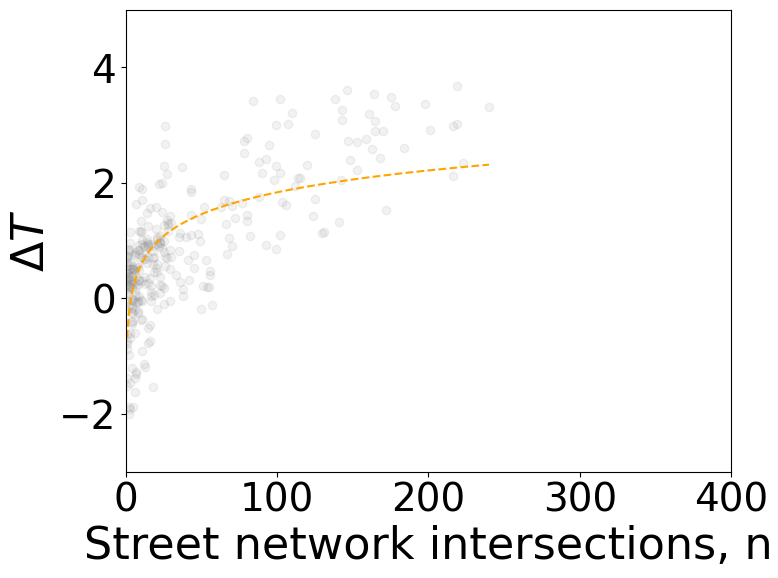

Cluj_Napoca


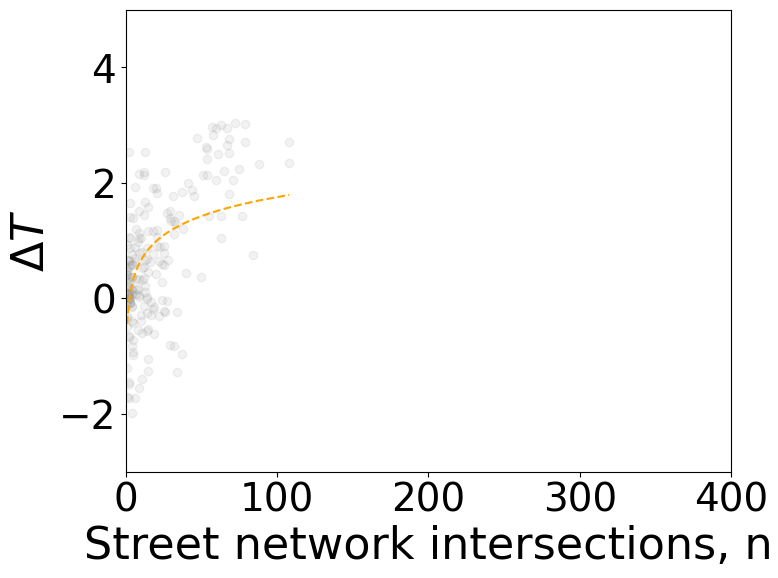

Accra


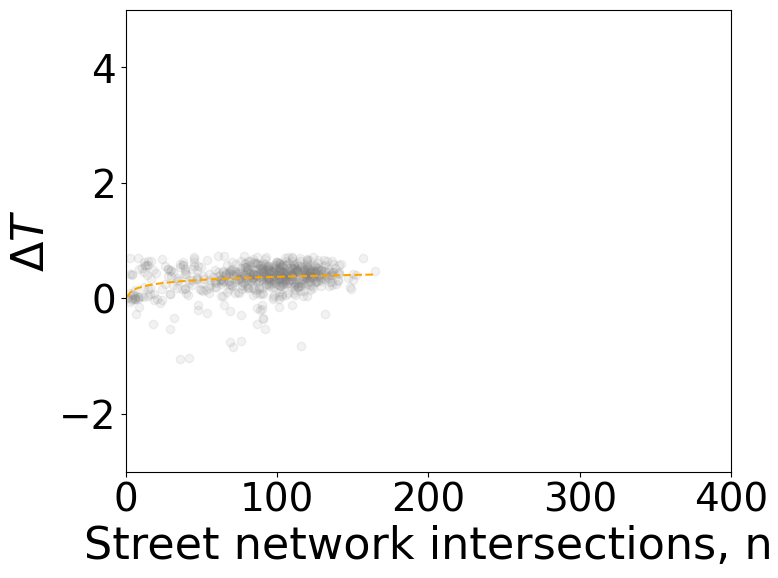

Addis_Abeba


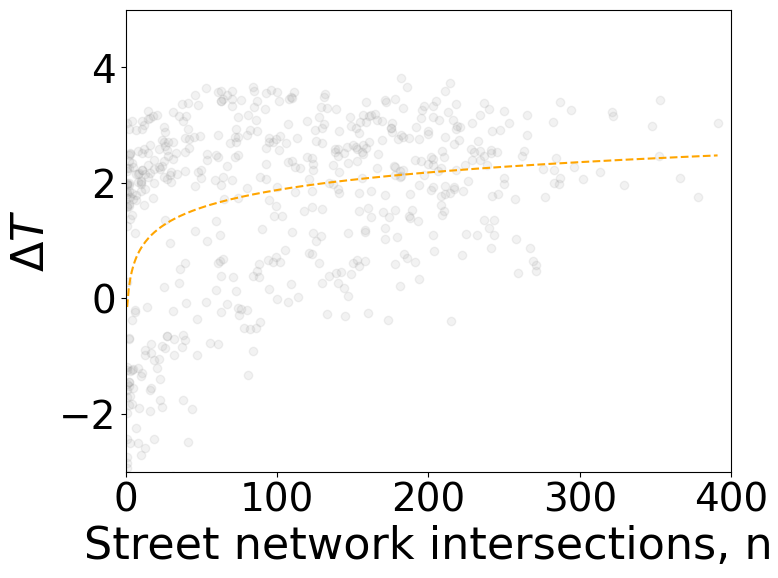

Amman


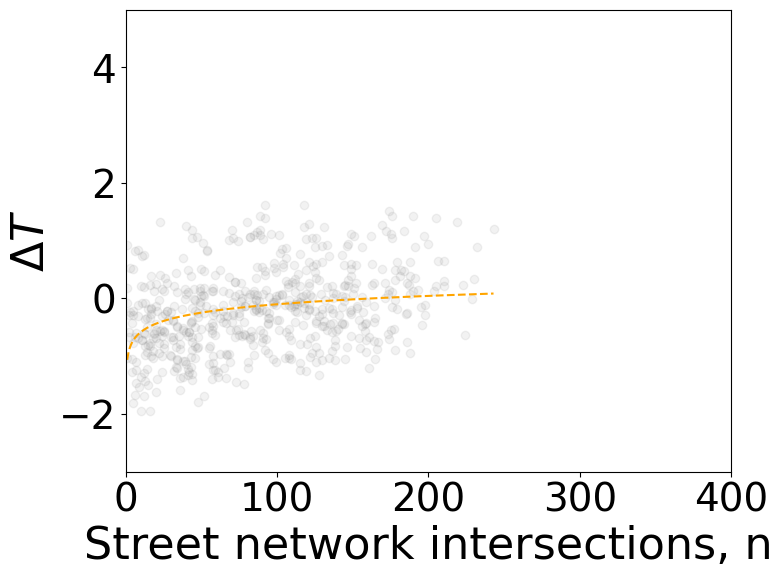

Auckland


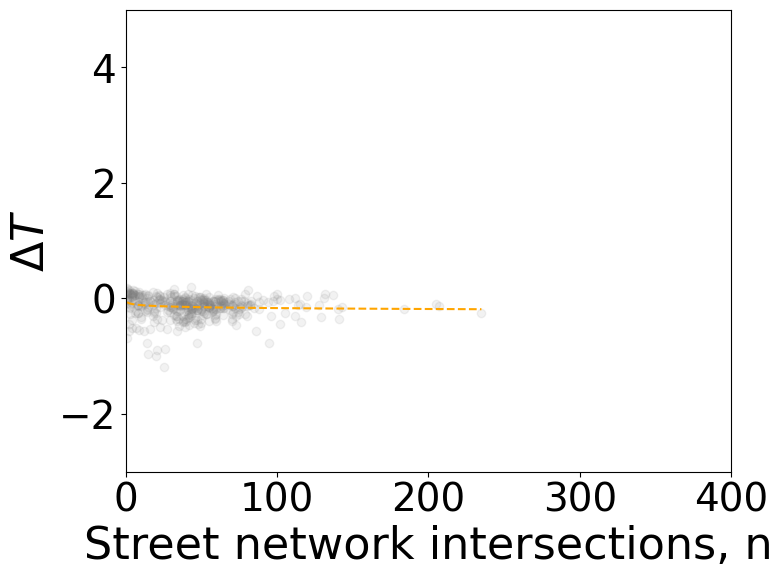

Bogota


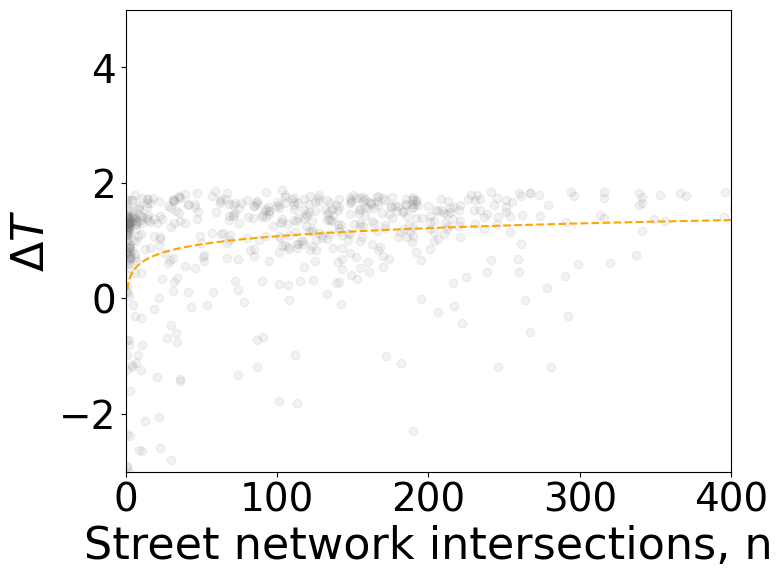

Buenos_Aires


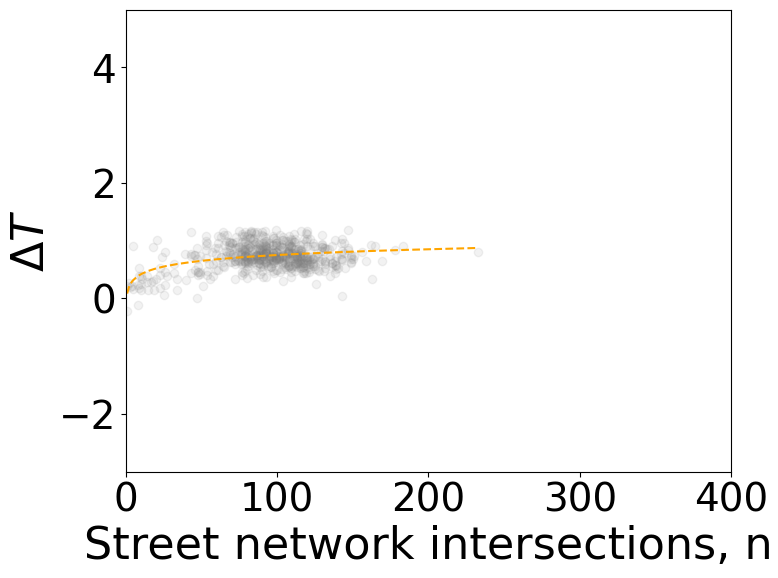

Cairo


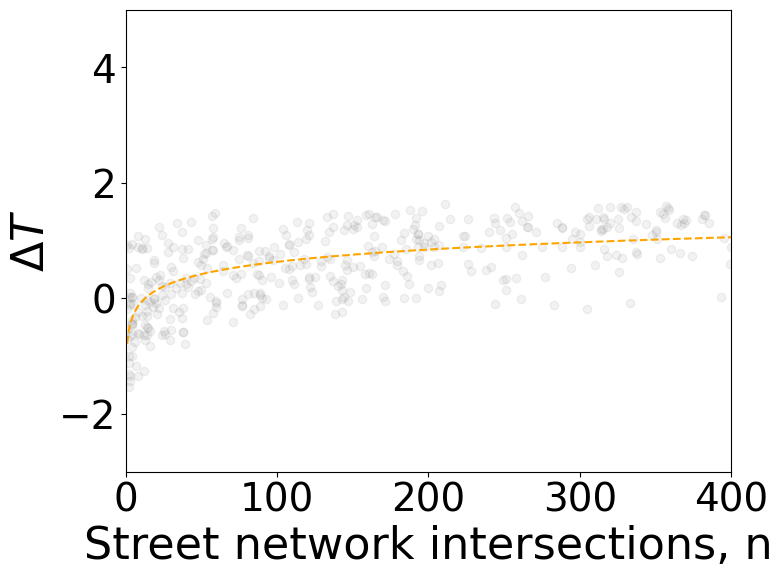

Cape_Town


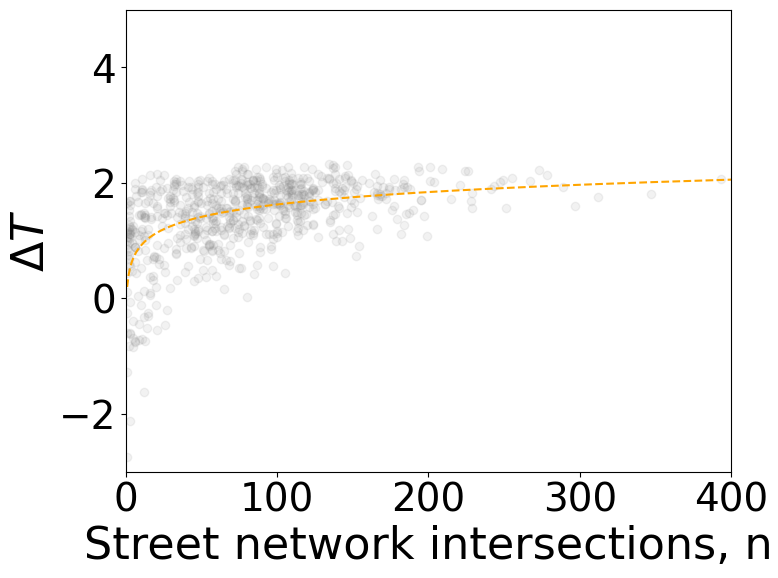

Chennai


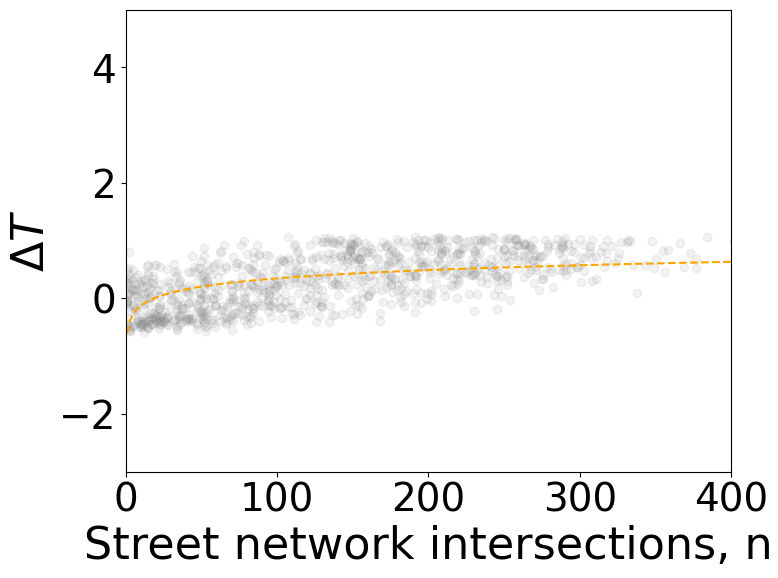

Curitiba


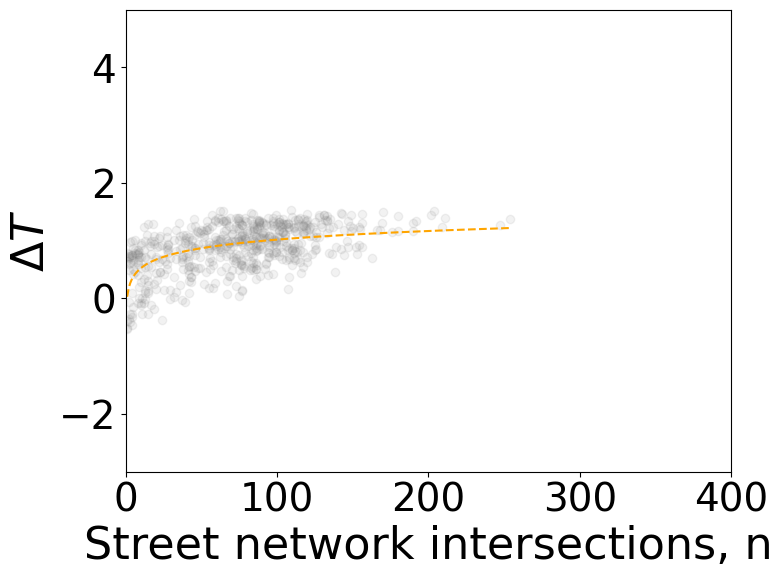

Dakar


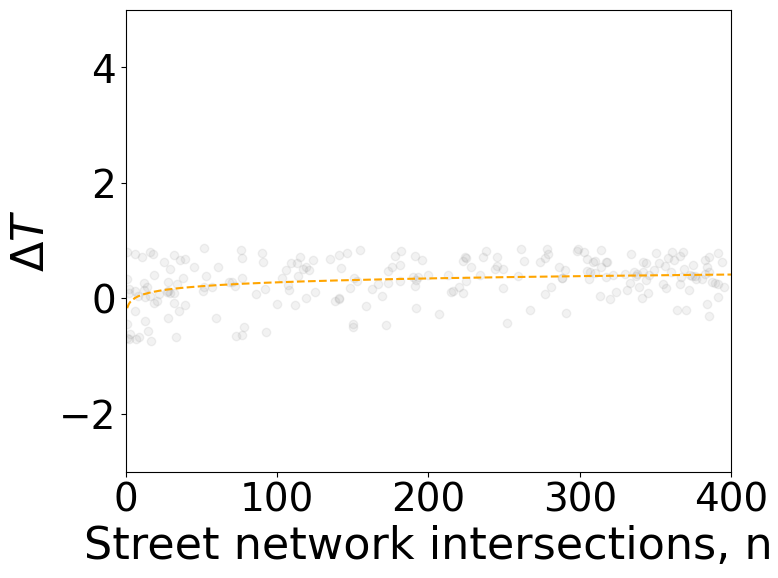

Dhaka


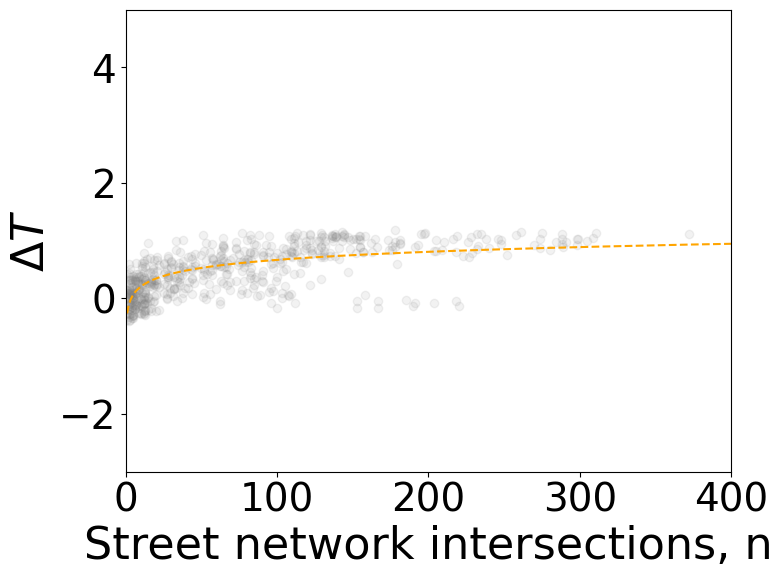

Dubai


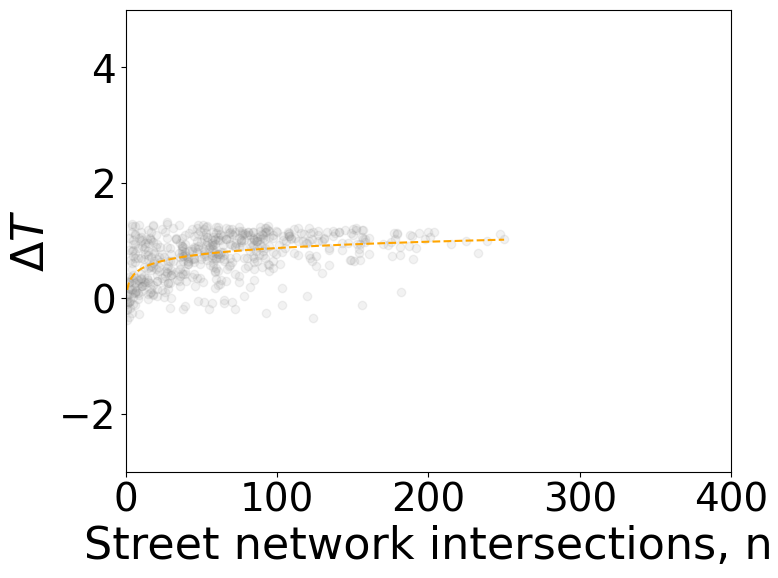

Ho_Chi_Minh


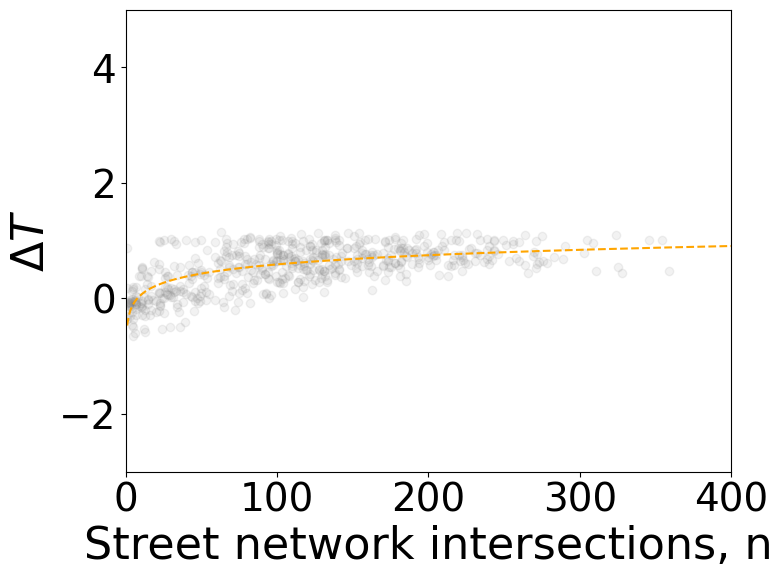

Hong_Kong


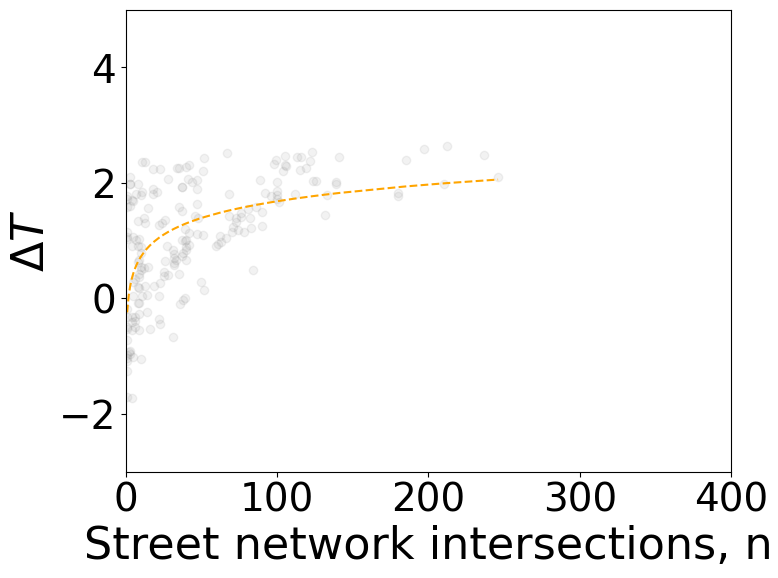

Houston


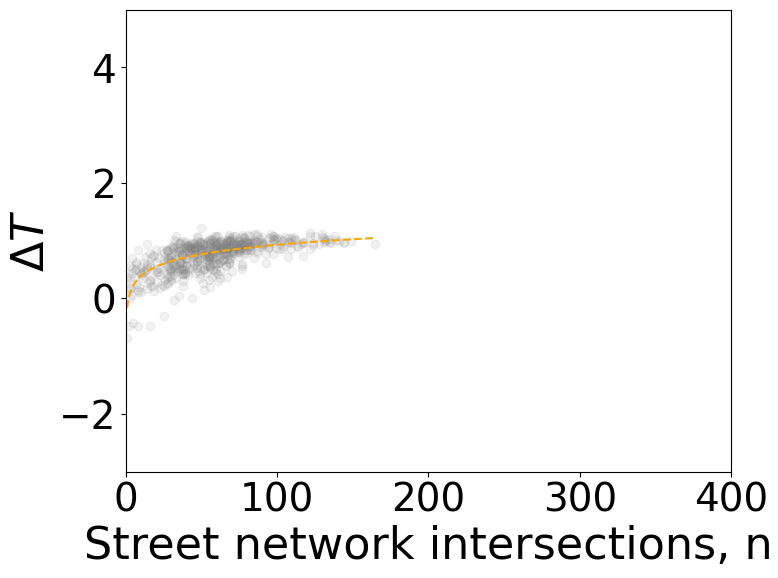

Islamabad


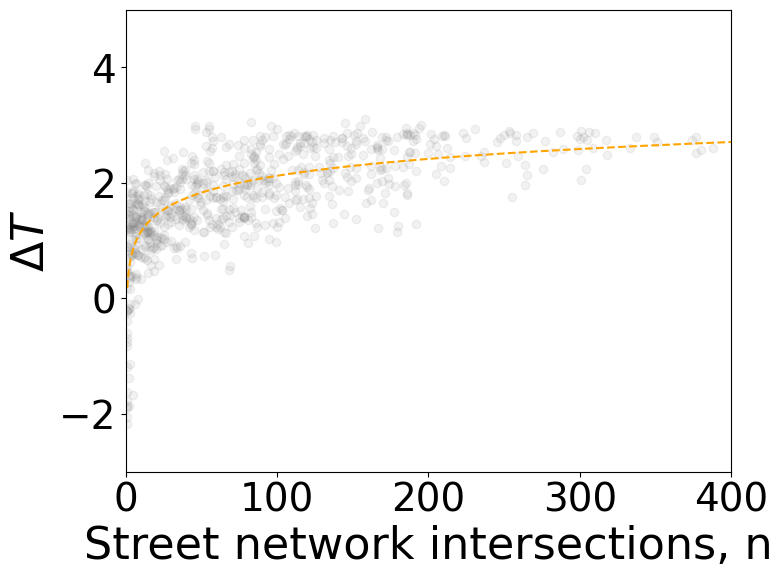

Istanbul


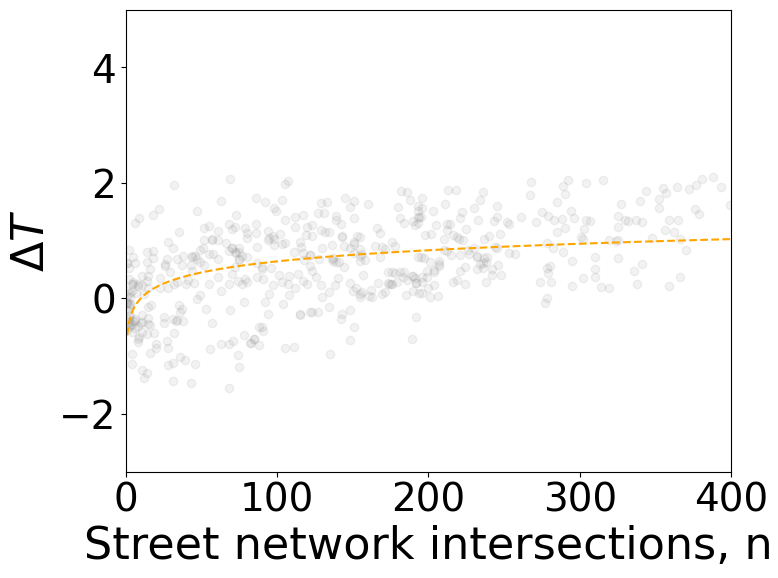

Jakarta


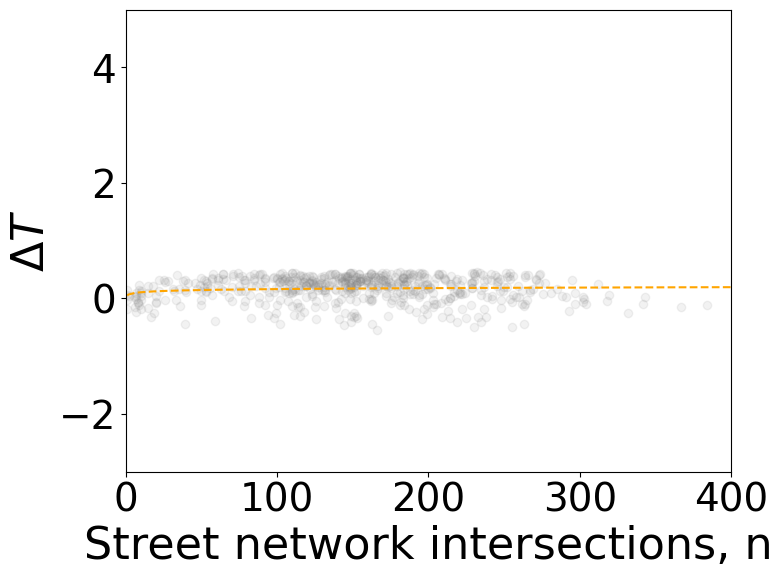

Karachi


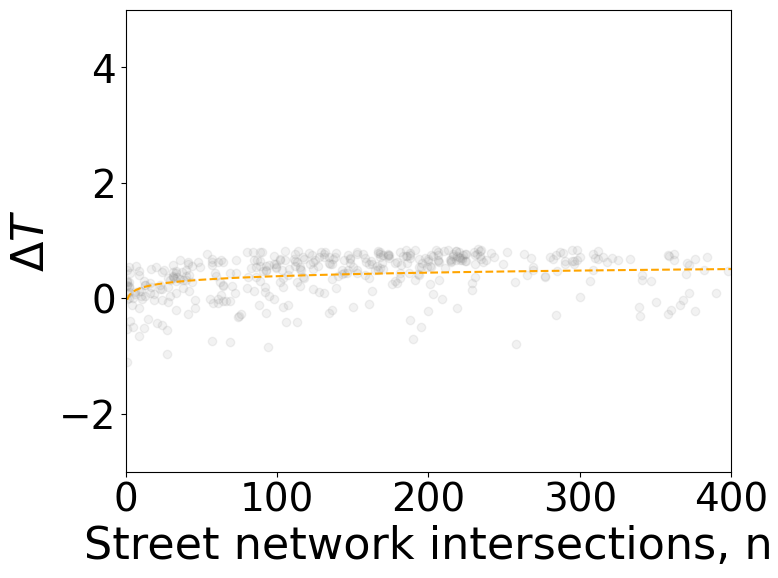

Lagos


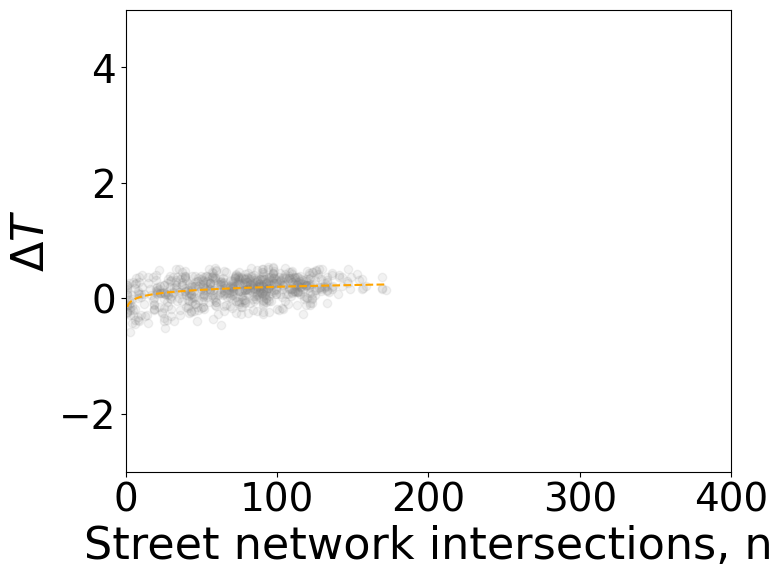

Lima


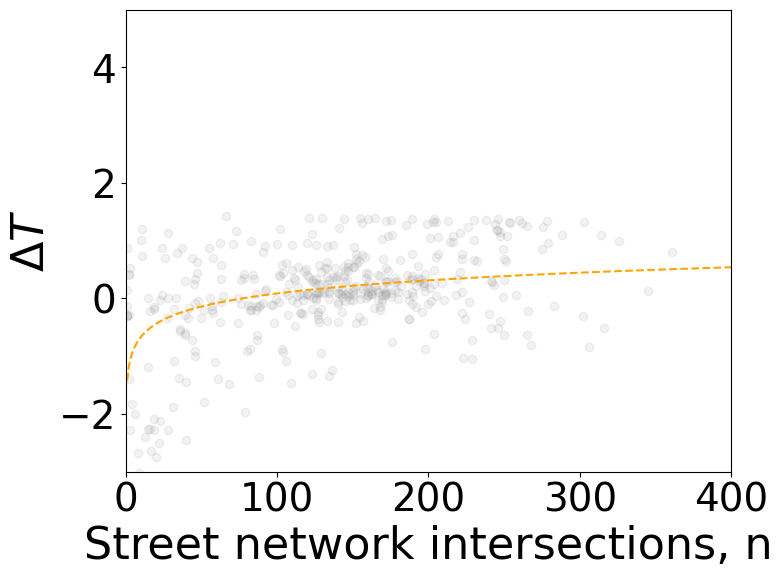

Los_Angeles


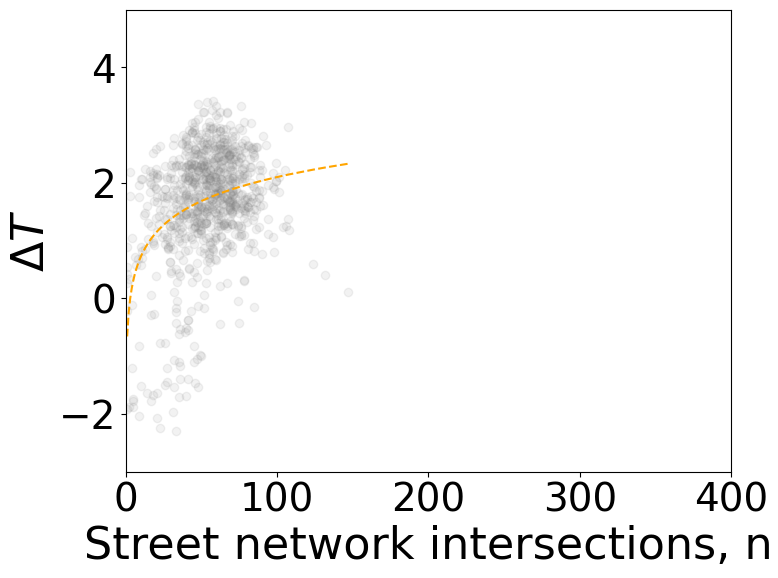

Marrakesh


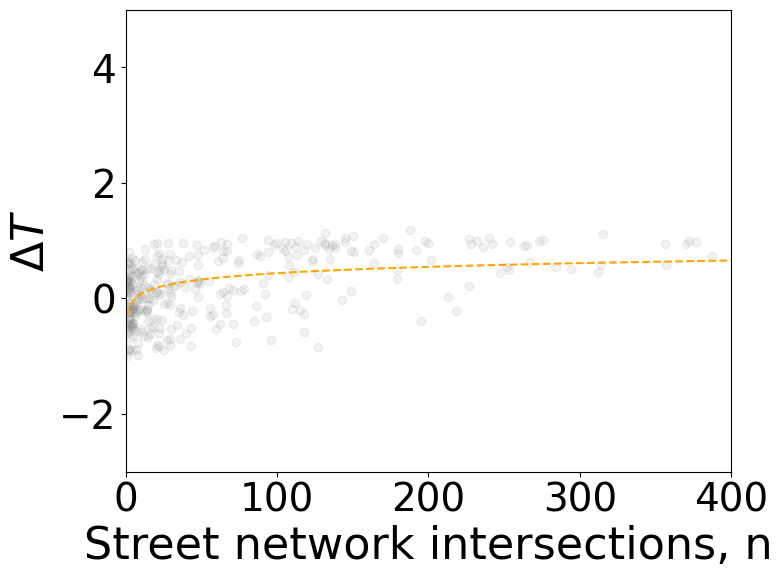

Medina


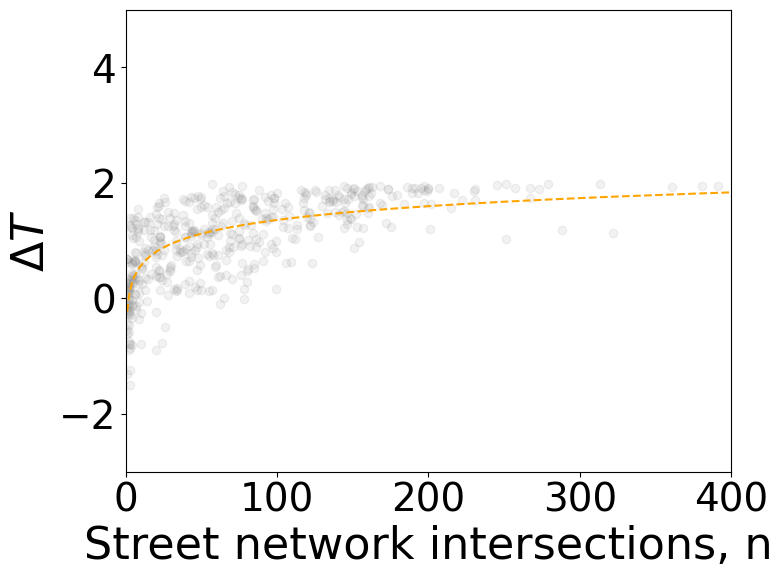

Melbourne


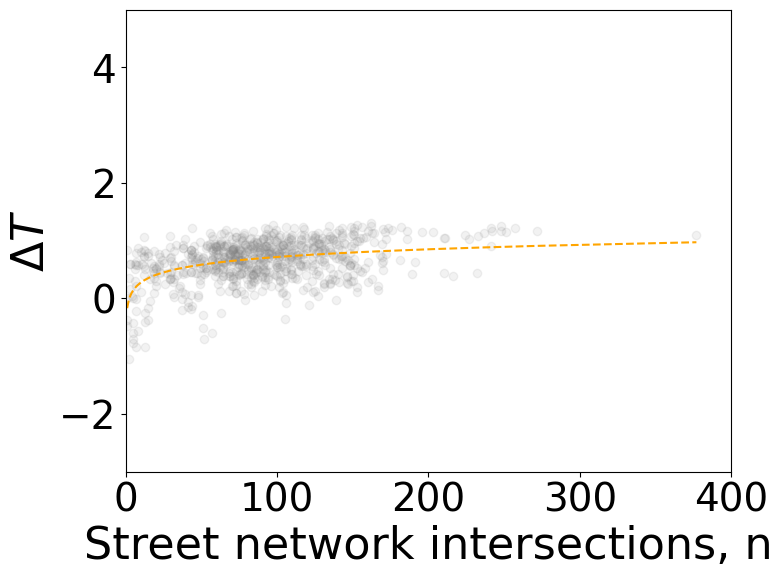

Mexico_City


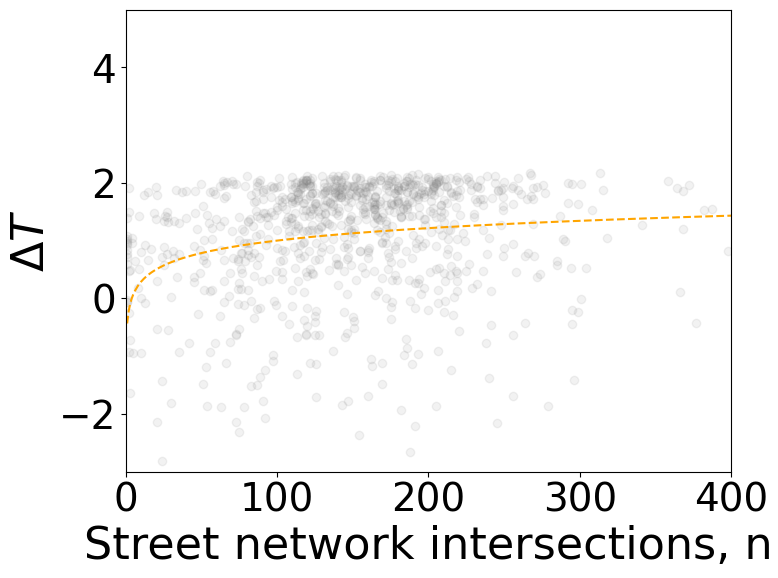

Mogadishu


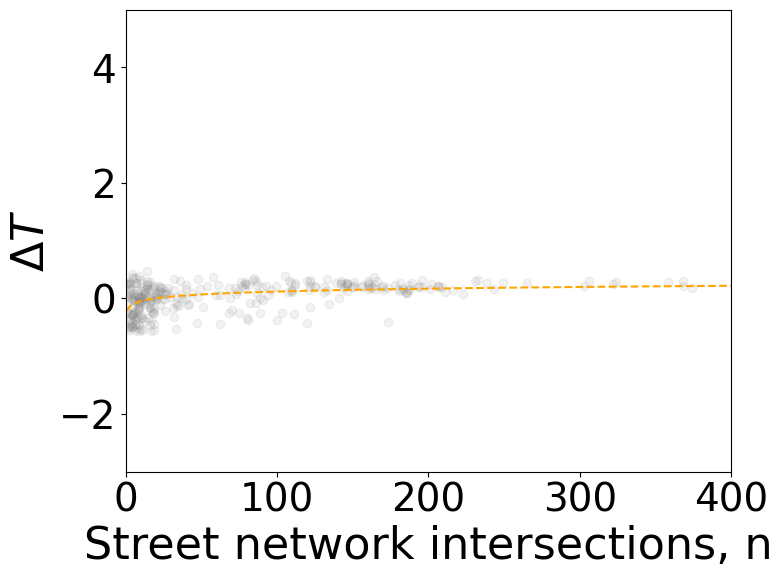

Moscow


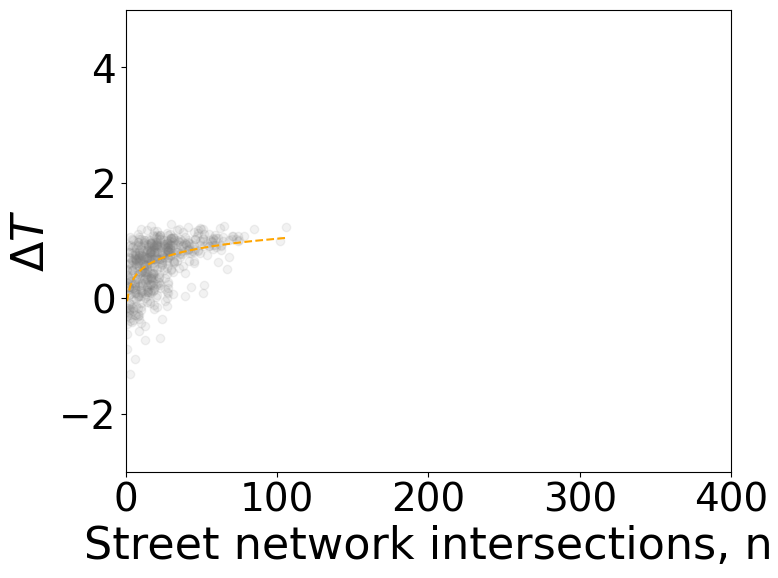

Nairobi


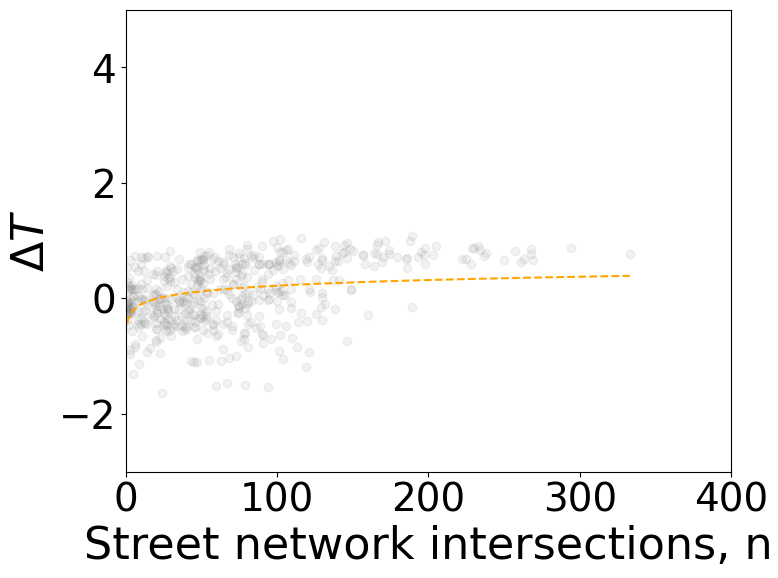

Nanjing


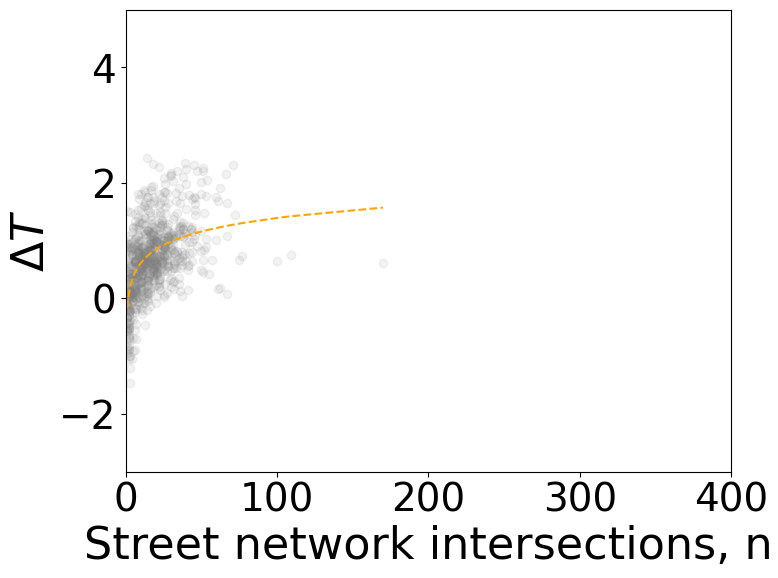

New_York


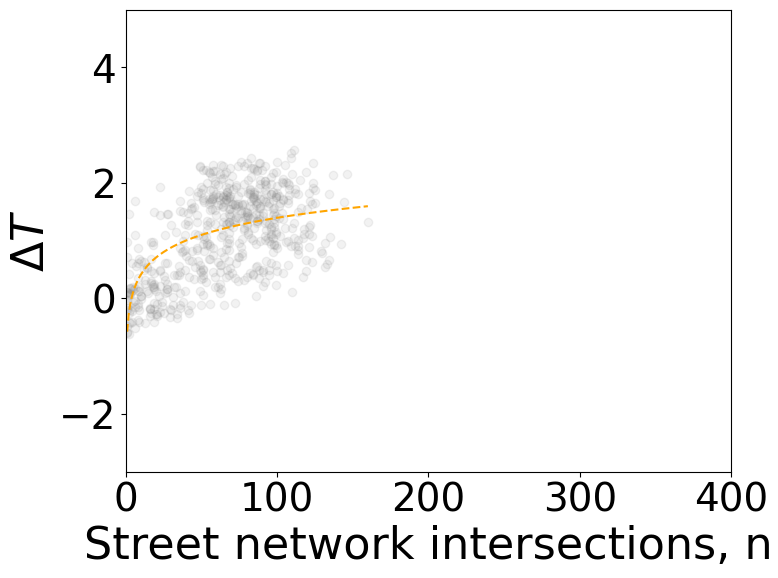

Phoenix


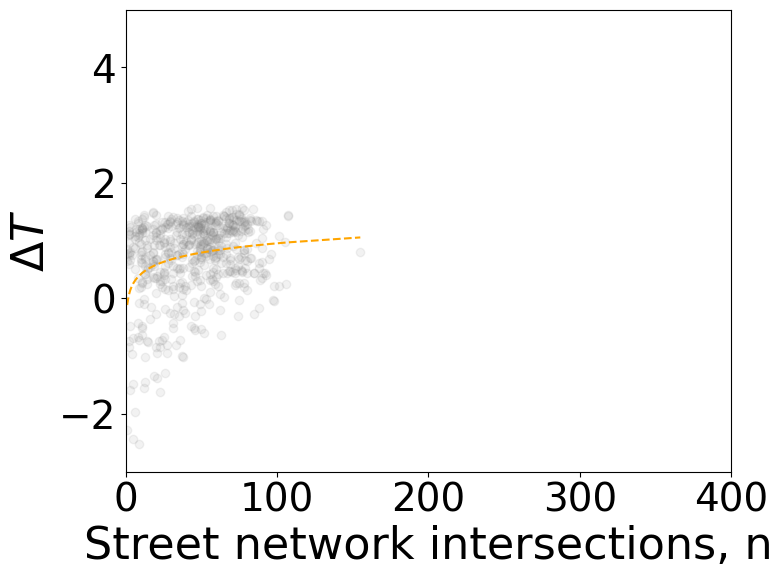

Rabat


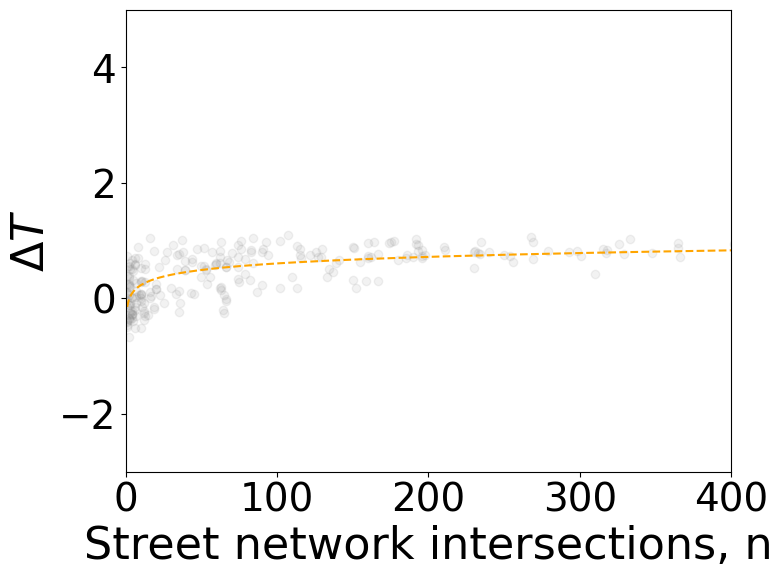

Salvador


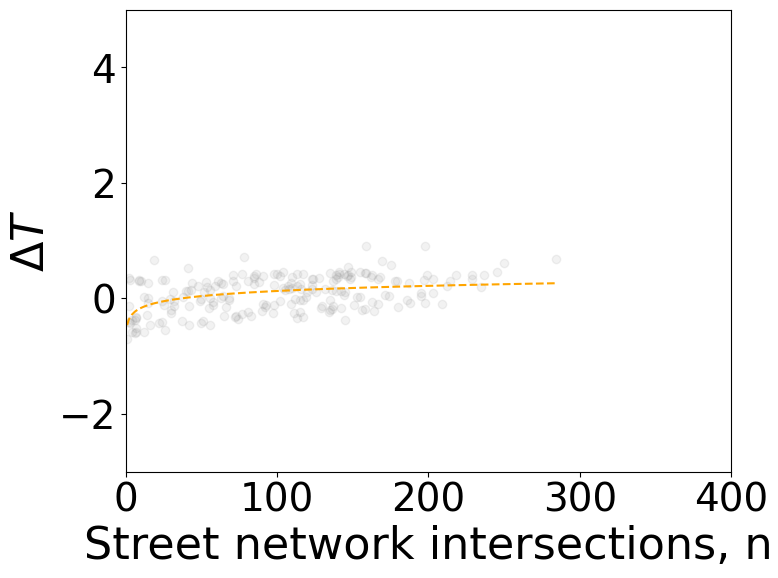

Santiago


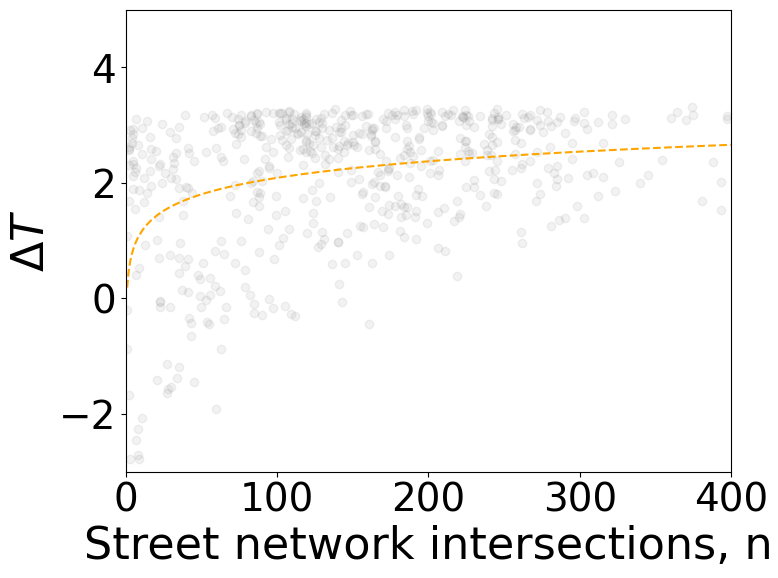

Singapore


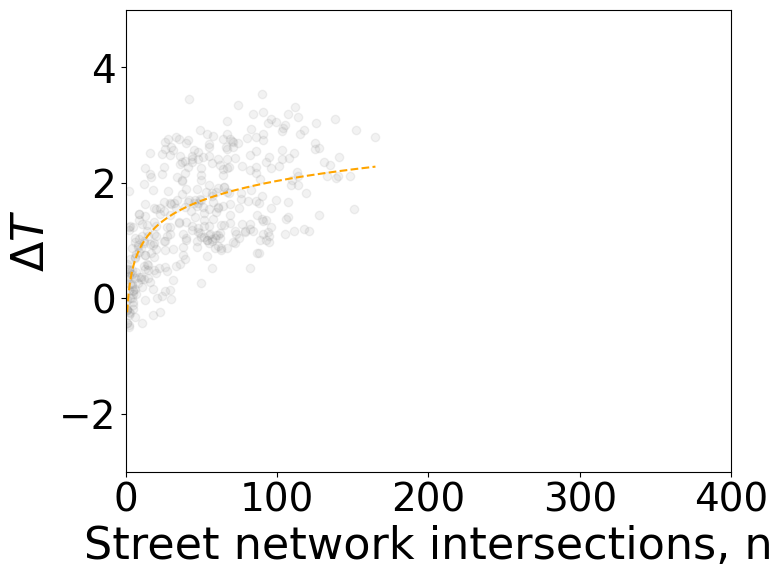

Sydney


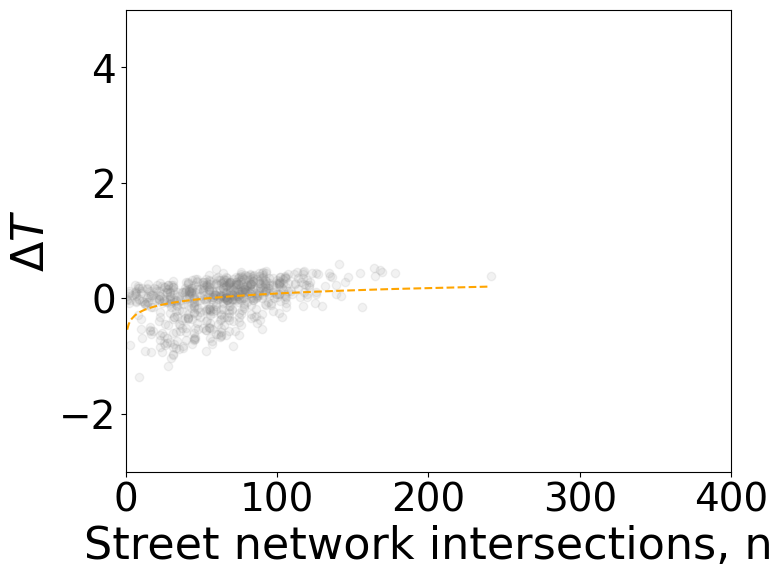

Teheran


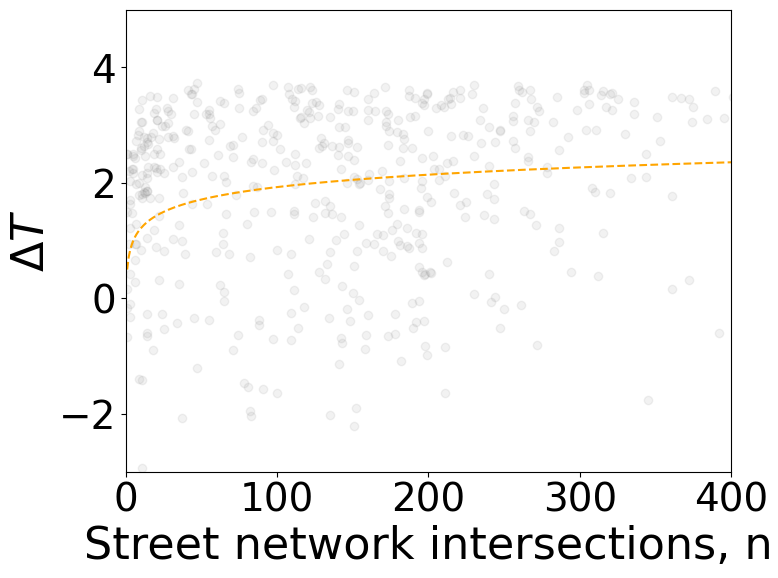

Tokyo


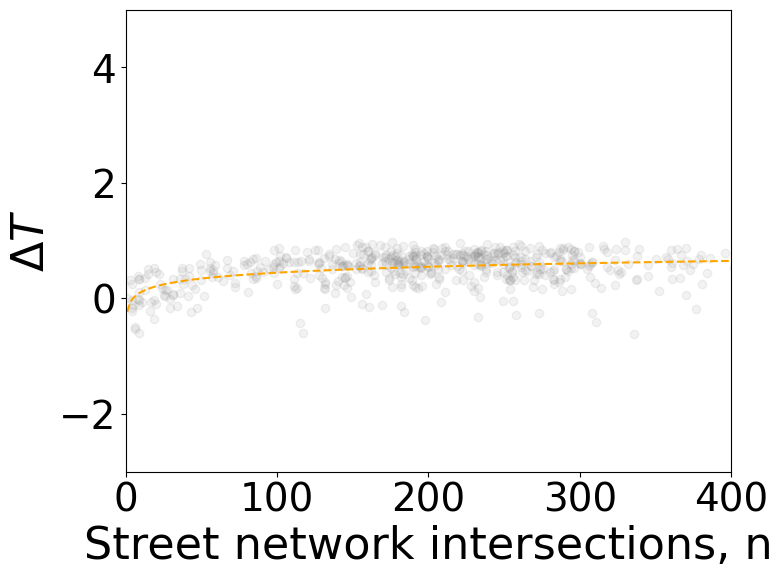

Toronto


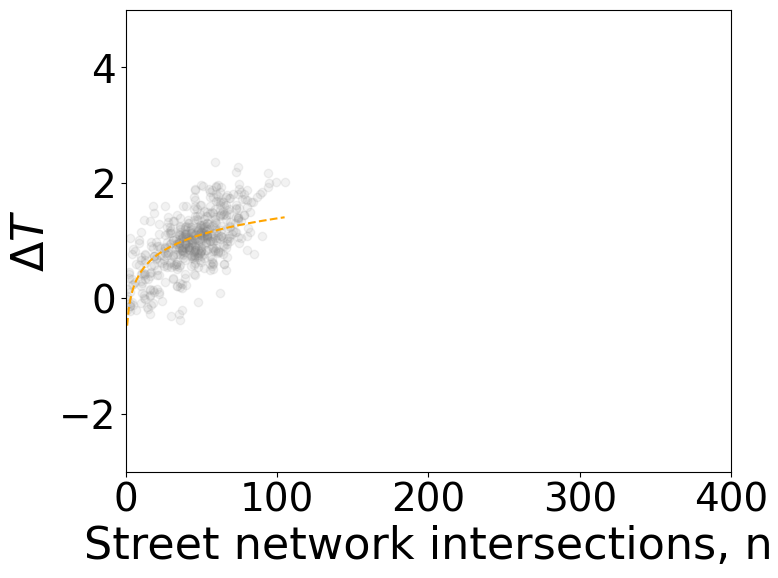

Tschwane


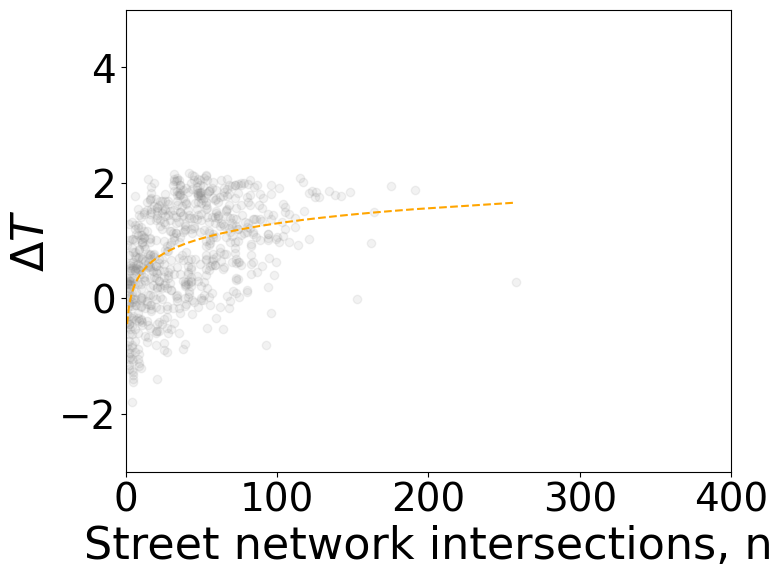

0.3277669295508475
0.5341630842872089
City: Barcelona
  Linear Fit -> a: -0.65, b: 0.34, R^2: 0.25
City: Montpellier
  Linear Fit -> a: -0.15, b: 0.27, R^2: 0.48
City: Rome
  Linear Fit -> a: -0.35, b: 0.35, R^2: 0.47
City: Naples
  Linear Fit -> a: -0.41, b: 0.27, R^2: 0.13
City: Porto
  Linear Fit -> a: -0.20, b: 0.37, R^2: 0.46
City: Sevilla
  Linear Fit -> a: -0.27, b: 0.24, R^2: 0.33
City: Alicante
  Linear Fit -> a: -0.30, b: 0.20, R^2: 0.39
City: Valencia
  Linear Fit -> a: -0.37, b: 0.23, R^2: 0.33
City: Bologna
  Linear Fit -> a: -0.24, b: 0.38, R^2: 0.52
City: Padua
  Linear Fit -> a: -0.67, b: 0.43, R^2: 0.59
City: Turin
  Linear Fit -> a: -1.44, b: 0.57, R^2: 0.48
City: Madrid
  Linear Fit -> a: -0.17, b: 0.27, R^2: 0.30
City: Murcia
  Linear Fit -> a: -0.05, b: 0.24, R^2: 0.53
City: Genoa
  Linear Fit -> a: -0.48, b: 0.67, R^2: 0.48
City: Milan
  Linear Fit -> a: -0.39, b: 0.35, R^2: 0.46
City: Lisbon
  Linear Fit -> a: -0.18, b: 0.11, R^2: 0.07
City: Palma_de_Mallorca
  L

In [32]:
# NORMAL FIT WITHOUT WEIGHT

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')

def linear(x, a, b):
    return a + b * x

R_linear = []
RMSEs_linear = []

coefficients_T = {}
coefficients_show = {}

for city in cities:
    
    logpopulation = np.array(pop_T_NETWORK_dic[city]['lognode'])
    population = np.array(pop_T_NETWORK_dic[city]['node'])
    temperature = np.array(pop_T_NETWORK_dic[city]['deltaT'])
    
    # Fit linear model
    reg = LinearRegression().fit(logpopulation.reshape(-1, 1), temperature)
    a_linear, b_linear = reg.intercept_, reg.coef_[0]
    temperature_pred_linear = reg.predict(logpopulation.reshape(-1, 1))
    
    # Calculate residuals and metrics for linear model
    residuals_linear = temperature - temperature_pred_linear
    r2_linear = r2_score(temperature, temperature_pred_linear)
    rmse_linear = np.sqrt(mean_squared_error(temperature, temperature_pred_linear))
    R_linear.append(r2_linear)
    RMSEs_linear.append(rmse_linear)
    
    # Store coefficients
    coefficients_T[city] = [a_linear, b_linear, r2_linear]
    coefficients_show[city] = {
        'linear': [a_linear, b_linear, r2_linear]
    }

    fig, ax = plt.subplots(figsize=(8, 6)) #(9, 7.5)

    ax.scatter(population, temperature, alpha=0.1, color='grey', edgecolor='grey')
    ax.plot(np.sort(population), linear(np.sort(logpopulation), a_linear, b_linear), color='orange', linestyle='--', label='Log Linear Fit')
    # ax1.set_xscale('log')
    # ax1.set_yscale('log')
    ax.set_xlabel(r'Street network intersections, n', size=32) #ax.set_xlabel(r'$Urban feature, y$', size=32)
    ax.set_ylabel(r'$\Delta T$', size=32) #ax.set_ylabel(r'Urban climate variable, $\Delta x$', size=32)
    ax.set_ylim(-3, 5)  
    # ax.set_xlim(0, 3500)
    # ax.set_xlim(0, 150)
    # plt.xticks([5000,15000,25000])
    plt.yticks([-2,0,2,4])
    plt.tick_params(axis='y', labelsize=28) 
    ax.set_xlim(0, 400)
    plt.tick_params(axis='x', labelsize=28)

    plt.tight_layout(pad=1.5)
    plt.show()

print(np.mean(R_linear))
print(np.mean(RMSEs_linear))

cluster_colors = {1:'red', 2:'green', 3:'#0077b6', 4:'purple'}      

for city, coeffs in coefficients_show.items():
    print(f"City: {city}")
    print(f"  Linear Fit -> a: {coeffs['linear'][0]:.2f}, b: {coeffs['linear'][1]:.2f}, R^2: {coeffs['linear'][2]:.2f}")

In [55]:
# GENERATE COEFFICIENTS vs grid cell size l

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')

coefficients = [coefficients_T]
sizes = [1000] #,1000,1500,2000

coefficients_dic_combined = {}

for coeffs, s in zip(coefficients,sizes):
    for city, values in coeffs.items():
        if city not in coefficients_dic_combined:
            coefficients_dic_combined[city] = []
        
        # Append values with grid cell size
        coefficients_dic_combined[city].append(values + [s])

coefficients_dic = {}

for city, values in coefficients_dic_combined.items():
    # Create a DataFrame for the current city and store it in the dictionary
    coefficients_dic[city] = pd.DataFrame(values, columns=['intersection', 'slope', 'R2', 'l'])

for city in cities:
    coefficients_dic[city].to_csv(city+'_coefficients_logp_deltaT_'+T_type+'_'+size+'.csv', index=False)  

In [47]:
# REAL DATA

for city in cities:

    pop_T_NETWORK_dic[city]['logpopu'] = np.log(pop_T_NETWORK_dic[city]['popu']) 
    pop_T_NETWORK_dic[city]['lognode'] = np.log(pop_T_NETWORK_dic[city]['node']) 

## STREET NETWORK

In [48]:
os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL\dataframes_2') 

coefficients_T_dic = {}
coefficients_PM_dic = {}

for city in cities:
    
    coefficients_T_dic[city] = pd.read_csv(city+'_coefficients_logn_deltaT_'+T_type+'_'+size+'.csv')  
    coefficients_PM_dic[city] = pd.read_csv(city+'_coefficients_logn_PM'+PM+'_'+size+'.csv') 

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')

In [49]:
BETAs_node = []
ALPHAs_node = []
R2s_node = []

for city in cities:
    BETAs_node.append(coefficients_PM_dic[city]['slope'][0])
    ALPHAs_node.append(coefficients_PM_dic[city]['intersection'][0])
    R2s_node.append(coefficients_PM_dic[city]['R2'][0])

In [50]:
BETAs_node_T = []
ALPHAs_node_T = []
R2s_node_T = []

for city in cities:
    BETAs_node_T.append(coefficients_T_dic[city]['slope'][0])
    ALPHAs_node_T.append(coefficients_T_dic[city]['intersection'][0])
    R2s_node_T.append(coefficients_T_dic[city]['R2'][0])

In [51]:
std_residuals_dic = {}
std_RESIDUALS_node = []
std_logn_dic = {}

for city in cities:
    
    T_predicted = coefficients_PM_dic[city]['intersection'][0] + coefficients_PM_dic[city]['slope'][0] * pop_T_NETWORK_dic[city]['lognode']
    residuals = pop_T_NETWORK_dic[city]['PM'+PM] - T_predicted
    
    std_residuals_dic[city] = np.std(residuals)
    std_RESIDUALS_node.append(np.std(residuals))
    
    std_logn_dic[city] = np.sqrt(coefficients_PM_dic[city]['slope'][0]**2*pop_T_NETWORK_dic[city]['lognode'].std()**2 + std_residuals_dic[city]**2)
    # print(city)
    # print(coefficients_dic[city]['slope'][0]*pop_T_NETWORK_dic[city]['lognode'].std())
    # print(np.sqrt(np.mean(BETAs_node)**2*pop_T_NETWORK_dic[city]['lognode'].std()**2 + np.mean(std_residuals_node)**2 ))
    # print(std_logn_dic[city])
    # print(pop_T_NETWORK_dic[city]['T'].std())

In [52]:
ratios_residual = []
ratios_no_residual = []

for city in cities:
    ratios_residual.append(std_logn_dic[city]/pop_T_NETWORK_dic[city]['PM'+PM].std())
    ratios_no_residual.append(pop_T_NETWORK_dic[city]['lognode'].std()/pop_T_NETWORK_dic[city]['PM'+PM].std())

In [53]:
std_residuals_dic_T = {}
std_RESIDUALS_node_T = []
# std_logn_dic = {}

for city in cities:
    
    T_predicted = coefficients_T_dic[city]['intersection'][0] + coefficients_T_dic[city]['slope'][0] * pop_T_NETWORK_dic[city]['lognode']
    residuals = pop_T_NETWORK_dic[city]['T'] - T_predicted
    
    std_residuals_dic_T[city] = np.std(residuals)
    std_RESIDUALS_node_T.append(np.std(residuals))

In [54]:
# -----------------------------
# 3. Collecting BETAs, ALPHAs, R2s per Cluster for PM and T data
# -----------------------------

# Initialize dictionaries to hold BETAs, ALPHAs, R2s for each cluster
BETAs_PM = {cluster_id: [] for cluster_id in clusters}
BETAs_T = {cluster_id: [] for cluster_id in clusters}
ALPHAs_PM = {cluster_id: [] for cluster_id in clusters}
ALPHAs_T = {cluster_id: [] for cluster_id in clusters}
R2s_PM = {cluster_id: [] for cluster_id in clusters}
R2s_T = {cluster_id: [] for cluster_id in clusters}

# Populate BETAs, ALPHAs, R2s for both PM and T data
for cluster_id, city_list in clusters.items():
    for city in city_list:
        coef_PM = coefficients_PM_dic.get(city)  # For PM data
        coef_T = coefficients_T_dic.get(city)    # For T data
        
        # For PM data
        if coef_PM is not None and not coef_PM.empty:
            slope_PM = coef_PM['slope'].iloc[0]
            intercept_PM = coef_PM['intersection'].iloc[0]
            R2_PM = coef_PM['R2'].iloc[0]
            if pd.notna(slope_PM) and pd.notna(intercept_PM) and pd.notna(R2_PM):
                BETAs_PM[cluster_id].append(slope_PM)
                ALPHAs_PM[cluster_id].append(intercept_PM)
                R2s_PM[cluster_id].append(R2_PM)
            else:
                print(f"Warning: Missing PM coefficients for {city} in Cluster {cluster_id}.")
        else:
            print(f"Warning: No PM coefficients data for {city} in Cluster {cluster_id}.")

        # For T data
        if coef_T is not None and not coef_T.empty:
            slope_T = coef_T['slope'].iloc[0]
            intercept_T = coef_T['intersection'].iloc[0]
            R2_T = coef_T['R2'].iloc[0]
            if pd.notna(slope_T) and pd.notna(intercept_T) and pd.notna(R2_T):
                BETAs_T[cluster_id].append(slope_T)
                ALPHAs_T[cluster_id].append(intercept_T)
                R2s_T[cluster_id].append(R2_T)
            else:
                print(f"Warning: Missing T coefficients for {city} in Cluster {cluster_id}.")
        else:
            print(f"Warning: No T coefficients data for {city} in Cluster {cluster_id}.")

# -----------------------------
# 4. Calculating Mean and Standard Deviation of BETAs and ALPHAs per Cluster for PM and T
# -----------------------------

mean_BETAs_PM = {}
std_BETAs_PM = {}
mean_BETAs_T = {}
std_BETAs_T = {}
mean_ALPHAs_PM = {}
std_ALPHAs_PM = {}
mean_ALPHAs_T = {}
std_ALPHAs_T = {}

for cluster_id in clusters:
    # For PM data
    if BETAs_PM[cluster_id]:
        mean_BETAs_PM[cluster_id] = np.mean(BETAs_PM[cluster_id])
        std_BETAs_PM[cluster_id] = np.std(BETAs_PM[cluster_id])
    else:
        mean_BETAs_PM[cluster_id] = np.nan
        std_BETAs_PM[cluster_id] = np.nan
        print(f"Warning: No BETAs_PM available for Cluster {cluster_id}.")

    if ALPHAs_PM[cluster_id]:
        mean_ALPHAs_PM[cluster_id] = np.mean(ALPHAs_PM[cluster_id])
        std_ALPHAs_PM[cluster_id] = np.std(ALPHAs_PM[cluster_id])
    else:
        mean_ALPHAs_PM[cluster_id] = np.nan
        std_ALPHAs_PM[cluster_id] = np.nan
        print(f"Warning: No ALPHAs_PM available for Cluster {cluster_id}.")

    # For T data
    if BETAs_T[cluster_id]:
        mean_BETAs_T[cluster_id] = np.mean(BETAs_T[cluster_id])
        std_BETAs_T[cluster_id] = np.std(BETAs_T[cluster_id])
    else:
        mean_BETAs_T[cluster_id] = np.nan
        std_BETAs_T[cluster_id] = np.nan
        print(f"Warning: No BETAs_T available for Cluster {cluster_id}.")

    if ALPHAs_T[cluster_id]:
        mean_ALPHAs_T[cluster_id] = np.mean(ALPHAs_T[cluster_id])
        std_ALPHAs_T[cluster_id] = np.std(ALPHAs_T[cluster_id])
    else:
        mean_ALPHAs_T[cluster_id] = np.nan
        std_ALPHAs_T[cluster_id] = np.nan
        print(f"Warning: No ALPHAs_T available for Cluster {cluster_id}.")

# -----------------------------
# 5. Calculating Residuals per Cluster for PM and T data
# -----------------------------

# Initialize dictionaries to hold residuals' standard deviations per cluster
std_residuals_PM = {cluster_id: [] for cluster_id in clusters}
std_residuals_T = {cluster_id: [] for cluster_id in clusters}

for cluster_id, city_list in clusters.items():
    for city in city_list:
        # Residuals for PM data
        city_data_PM = pop_T_NETWORK_dic.get(city)
        if isinstance(city_data_PM, pd.DataFrame):
            lognode = city_data_PM['lognode'].iloc[0]
            PMs = city_data_PM['PM'+PM].values  # Ensure PM is a NumPy array
            if not pd.isna(mean_ALPHAs_PM.get(cluster_id)) and not pd.isna(mean_BETAs_PM.get(cluster_id)):
                PM_predicted = mean_ALPHAs_PM[cluster_id] + mean_BETAs_PM[cluster_id] * lognode
                residuals_PM = PMs - PM_predicted
                residual_std_PM = np.std(residuals_PM)
                std_residuals_PM[cluster_id].append(residual_std_PM)
            else:
                print(f"Warning: Mean PM coefficients not available for Cluster {cluster_id}.")
        else:
            print(f"Warning: {city}'s PM data is not a DataFrame.")

        # Residuals for T data
        city_data_T = pop_T_NETWORK_dic.get(city)
        if isinstance(city_data_T, pd.DataFrame):
            if 'lognode' and 'T' in city_data_T.columns:
                lognode = city_data_T['lognode'].iloc[0]
                T = city_data_T['T'].values  # Ensure T is a NumPy array
                if not pd.isna(mean_ALPHAs_T.get(cluster_id)) and not pd.isna(mean_BETAs_T.get(cluster_id)):
                    T_predicted = mean_ALPHAs_T[cluster_id] + mean_BETAs_T[cluster_id] * lognode
                    residuals_T = T - T_predicted
                    residual_std_T = np.std(residuals_T)
                    std_residuals_T[cluster_id].append(residual_std_T)
                else:
                    print(f"Warning: Mean T coefficients not available for Cluster {cluster_id}.")
            else:
                print(f"Warning: 'lognode' or 'T' columns missing for {city}.")
        else:
            print(f"Warning: {city}'s T data is not a DataFrame.")

# -----------------------------
# 6. (Optional) Displaying Results
# -----------------------------

# Example: Printing mean and std BETAs and ALPHAs for both PM and T data
print("\nMean and Standard Deviation of BETAs_PM per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Beta_PM = {mean_BETAs_PM[cluster_id]:.4f}, Std Beta_PM = {std_BETAs_PM[cluster_id]:.4f}")

print("\nMean and Standard Deviation of BETAs_T per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Beta_T = {mean_BETAs_T[cluster_id]:.4f}, Std Beta_T = {std_BETAs_T[cluster_id]:.4f}")

print("\nMean and Standard Deviation of ALPHAs_PM per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Alpha_PM = {mean_ALPHAs_PM[cluster_id]:.4f}, Std Alpha_PM = {std_ALPHAs_PM[cluster_id]:.4f}")

print("\nMean and Standard Deviation of ALPHAs_T per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Alpha_T = {mean_ALPHAs_T[cluster_id]:.4f}, Std Alpha_T = {std_ALPHAs_T[cluster_id]:.4f}")

print("\nMean and Standard Deviation of residuals per Cluster:")
for cluster_id in clusters:
    # PM
    if std_residuals_PM[cluster_id]:
        mean_std_resid_PM = np.mean(std_residuals_PM[cluster_id])
        std_std_resid_PM = np.std(std_residuals_PM[cluster_id])
        print(f"Cluster {cluster_id} - PM Residuals: "
              f"mean of std = {mean_std_resid_PM:.4f}, std of std = {std_std_resid_PM:.4f}")
    else:
        print(f"Cluster {cluster_id} - PM Residuals: no data.")

    # T
    if std_residuals_T[cluster_id]:
        mean_std_resid_T = np.mean(std_residuals_T[cluster_id])
        std_std_resid_T = np.std(std_residuals_T[cluster_id])
        print(f"Cluster {cluster_id} - T Residuals: "
              f"mean of std = {mean_std_resid_T:.4f}, std of std = {std_std_resid_T:.4f}")
    else:
        print(f"Cluster {cluster_id} - T Residuals: no data.")


NameError: name 'clusters' is not defined

## POPULATION

In [106]:

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL\dataframes_2')

coefficients_p_PM_dic = {}
coefficients_p_T_dic = {}

for city in cities:

    coefficients_p_T_dic[city] = pd.read_csv(city+'_coefficients_logp_deltaT_'+T_type+'_'+size+'.csv')  
    coefficients_p_PM_dic[city] = pd.read_csv(city+'_coefficients_logp_PM'+PM+'_'+size+'.csv') 

os.chdir(r'C:\Users\mduran\Desktop\PhD- Patterns and Dynamics in Urban Networks\1- DATA POLLUTION - Scaling laws, pdfs\RESULTS_GLOBAL')

In [63]:

BETAs_popu = []
ALPHAs_popu = []
R2s_popu = []

for city in cities:
    BETAs_popu.append(coefficients_p_PM_dic[city]['slope'][0])
    ALPHAs_popu.append(coefficients_p_PM_dic[city]['intersection'][0])
    R2s_popu.append(coefficients_p_PM_dic[city]['R2'][0])

In [64]:

BETAs_popu_T = []
ALPHAs_popu_T = []
R2s_popu_T = []

for city in cities:
    BETAs_popu_T.append(coefficients_p_T_dic[city]['slope'][0])
    ALPHAs_popu_T.append(coefficients_p_T_dic[city]['intersection'][0])
    R2s_popu_T.append(coefficients_p_T_dic[city]['R2'][0])

In [65]:

std_residuals_dic = {}
std_RESIDUALS_popu = []
std_logp_dic = {}

for city in cities:
    
    T_predicted = coefficients_p_PM_dic[city]['intersection'][0] + coefficients_p_PM_dic[city]['slope'][0] * pop_T_NETWORK_dic[city]['logpopu']
    residuals = pop_T_NETWORK_dic[city]['T'] - T_predicted
    
    std_residuals_dic[city] = np.std(residuals)
    std_RESIDUALS_popu.append(np.std(residuals))
    
    std_logp_dic[city] = np.sqrt(coefficients_p_PM_dic[city]['slope'][0]**2*pop_T_NETWORK_dic[city]['logpopu'].std()**2 + std_residuals_dic[city]**2)
    # print(city)
    # print(coefficients_dic[city]['slope'][0]*pop_T_NETWORK_dic[city]['lognode'].std())
    # print(np.sqrt(np.mean(BETAs_node)**2*pop_T_NETWORK_dic[city]['lognode'].std()**2 + np.mean(std_residuals_node)**2 ))
    # print(std_logn_dic[city])
    # print(pop_T_NETWORK_dic[city]['T'].std())

In [66]:

ratios_residual = []
ratios_no_residual = []

for city in cities:
    ratios_residual.append(std_logp_dic[city]/pop_T_NETWORK_dic[city]['T'].std())
    ratios_no_residual.append(pop_T_NETWORK_dic[city]['logpopu'].std()/pop_T_NETWORK_dic[city]['T'].std())

In [67]:
# -----------------------------
# 3. Collecting BETAs, ALPHAs, R2s per Cluster for PM and T data
# -----------------------------

# Initialize dictionaries to hold BETAs, ALPHAs, R2s for each cluster
BETAs_p_PM = {cluster_id: [] for cluster_id in clusters}
BETAs_p_T = {cluster_id: [] for cluster_id in clusters}
ALPHAs_p_PM = {cluster_id: [] for cluster_id in clusters}
ALPHAs_p_T = {cluster_id: [] for cluster_id in clusters}
R2s_p_PM = {cluster_id: [] for cluster_id in clusters}
R2s_p_T = {cluster_id: [] for cluster_id in clusters}

# Populate BETAs, ALPHAs, R2s for both PM and T data
for cluster_id, city_list in clusters.items():
    for city in city_list:
        coef_PM = coefficients_p_PM_dic.get(city)  # For PM data
        coef_T = coefficients_p_T_dic.get(city)    # For T data
        
        # For PM data
        if coef_PM is not None and not coef_PM.empty:
            slope_p_PM = coef_PM['slope'].iloc[0]
            intercept_p_PM = coef_PM['intersection'].iloc[0]
            R2_p_PM = coef_PM['R2'].iloc[0]
            if pd.notna(slope_p_PM) and pd.notna(intercept_p_PM) and pd.notna(R2_p_PM):
                BETAs_p_PM[cluster_id].append(slope_p_PM)
                ALPHAs_p_PM[cluster_id].append(intercept_p_PM)
                R2s_p_PM[cluster_id].append(R2_p_PM)
            else:
                print(f"Warning: Missing PM coefficients for {city} in Cluster {cluster_id}.")
        else:
            print(f"Warning: No PM coefficients data for {city} in Cluster {cluster_id}.")

        # For T data
        if coef_T is not None and not coef_T.empty:
            slope_p_T = coef_T['slope'].iloc[0]
            intercept_p_T = coef_T['intersection'].iloc[0]
            R2_p_T = coef_T['R2'].iloc[0]
            if pd.notna(slope_p_T) and pd.notna(intercept_p_T) and pd.notna(R2_p_T):
                BETAs_p_T[cluster_id].append(slope_p_T)
                ALPHAs_p_T[cluster_id].append(intercept_p_T)
                R2s_p_T[cluster_id].append(R2_p_T)
            else:
                print(f"Warning: Missing T coefficients for {city} in Cluster {cluster_id}.")
        else:
            print(f"Warning: No T coefficients data for {city} in Cluster {cluster_id}.")

# -----------------------------
# 4. Calculating Mean and Standard Deviation of BETAs and ALPHAs per Cluster for PM and T
# -----------------------------

mean_BETAs_p_PM = {}
std_BETAs_p_PM = {}
mean_BETAs_p_T = {}
std_BETAs_p_T = {}
mean_ALPHAs_p_PM = {}
std_ALPHAs_p_PM = {}
mean_ALPHAs_p_T = {}
std_ALPHAs_p_T = {}

for cluster_id in clusters:
    # For PM data
    if BETAs_p_PM[cluster_id]:
        mean_BETAs_p_PM[cluster_id] = np.mean(BETAs_p_PM[cluster_id])
        std_BETAs_p_PM[cluster_id] = np.std(BETAs_p_PM[cluster_id])
    else:
        mean_BETAs_p_PM[cluster_id] = np.nan
        std_BETAs_p_PM[cluster_id] = np.nan
        print(f"Warning: No BETAs_PM available for Cluster {cluster_id}.")

    if ALPHAs_p_PM[cluster_id]:
        mean_ALPHAs_p_PM[cluster_id] = np.mean(ALPHAs_p_PM[cluster_id])
        std_ALPHAs_p_PM[cluster_id] = np.std(ALPHAs_p_PM[cluster_id])
    else:
        mean_ALPHAs_p_PM[cluster_id] = np.nan
        std_ALPHAs_p_PM[cluster_id] = np.nan
        print(f"Warning: No ALPHAs_PM available for Cluster {cluster_id}.")

    # For T data
    if BETAs_p_T[cluster_id]:
        mean_BETAs_p_T[cluster_id] = np.mean(BETAs_p_T[cluster_id])
        std_BETAs_p_T[cluster_id] = np.std(BETAs_p_T[cluster_id])
    else:
        mean_BETAs_p_T[cluster_id] = np.nan
        std_BETAs_p_T[cluster_id] = np.nan
        print(f"Warning: No BETAs_T available for Cluster {cluster_id}.")

    if ALPHAs_p_T[cluster_id]:
        mean_ALPHAs_p_T[cluster_id] = np.mean(ALPHAs_p_T[cluster_id])
        std_ALPHAs_p_T[cluster_id] = np.std(ALPHAs_p_T[cluster_id])
    else:
        mean_ALPHAs_p_T[cluster_id] = np.nan
        std_ALPHAs_p_T[cluster_id] = np.nan
        print(f"Warning: No ALPHAs_T available for Cluster {cluster_id}.")

# -----------------------------
# 5. Calculating Residuals per Cluster for PM and T data
# -----------------------------

# Initialize dictionaries to hold residuals' standard deviations per cluster
std_residuals_p_PM = {cluster_id: [] for cluster_id in clusters}
std_residuals_p_T = {cluster_id: [] for cluster_id in clusters}

for cluster_id, city_list in clusters.items():
    for city in city_list:
        # Residuals for PM data
        city_data_PM = pop_T_NETWORK_dic.get(city)
        if isinstance(city_data_PM, pd.DataFrame):
            if 'lognode' and 'PM' in city_data_PM.columns:
                lognode = city_data_PM['lognode'].iloc[0]
                PM = city_data_PM['PM'].values  # Ensure PM is a NumPy array
                if not pd.isna(mean_ALPHAs_p_PM.get(cluster_id)) and not pd.isna(mean_BETAs_p_PM.get(cluster_id)):
                    PM_predicted = mean_ALPHAs_p_PM[cluster_id] + mean_BETAs_p_PM[cluster_id] * lognode
                    residuals_p_PM = PM - PM_predicted
                    residual_std_p_PM = np.std(residuals_p_PM)
                    std_residuals_p_PM[cluster_id].append(residual_std_p_PM)

        # Residuals for T data
        city_data_T = pop_T_NETWORK_dic.get(city)
        if isinstance(city_data_T, pd.DataFrame):
            if 'lognode' and 'T' in city_data_T.columns:
                lognode = city_data_T['lognode'].iloc[0]
                T = city_data_T['T'].values  # Ensure T is a NumPy array
                if not pd.isna(mean_ALPHAs_p_T.get(cluster_id)) and not pd.isna(mean_BETAs_p_T.get(cluster_id)):
                    T_predicted = mean_ALPHAs_p_T[cluster_id] + mean_BETAs_p_T[cluster_id] * lognode
                    residuals_p_T = T - T_predicted
                    residual_std_p_T = np.std(residuals_p_T)
                    std_residuals_p_T[cluster_id].append(residual_std_p_T)


# -----------------------------
# 6. Results
# -----------------------------

# Example: Printing mean and std BETAs and ALPHAs for both PM and T data
print("\nMean and Standard Deviation of BETAs_PM per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Beta_PM = {mean_BETAs_p_PM[cluster_id]:.4f}, Std Beta_PM = {std_BETAs_p_PM[cluster_id]:.4f}")

print("\nMean and Standard Deviation of BETAs_T per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Beta_T = {mean_BETAs_p_T[cluster_id]:.4f}, Std Beta_T = {std_BETAs_p_T[cluster_id]:.4f}")

print("\nMean and Standard Deviation of ALPHAs_PM per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Alpha_PM = {mean_ALPHAs_p_PM[cluster_id]:.4f}, Std Alpha_PM = {std_ALPHAs_p_PM[cluster_id]:.4f}")

print("\nMean and Standard Deviation of ALPHAs_T per Cluster:")
for cluster_id in clusters:
    print(f"Cluster {cluster_id}: Mean Alpha_T = {mean_ALPHAs_p_T[cluster_id]:.4f}, Std Alpha_T = {std_ALPHAs_p_T[cluster_id]:.4f}")

print("\nStandard Deviation of Residuals for PM data per Cluster:")
for cluster_id, residuals in std_residuals_p_PM.items():
    if residuals:
        mean_residual_p_PM = np.mean(residuals)
        std_residual_p_PM = np.std(residuals)
        print(f"Cluster {cluster_id}: Mean Residuals = {mean_residual_p_PM:.2f}, Std Residuals = {std_residual_p_PM:.2f}")
    else:
        print(f"Cluster {cluster_id}: No residuals calculated.")


Mean and Standard Deviation of BETAs_PM per Cluster:
Cluster 3: Mean Beta_PM = 1.0079, Std Beta_PM = 2.1085
Cluster 1: Mean Beta_PM = 0.3619, Std Beta_PM = 0.4708
Cluster 2: Mean Beta_PM = 0.9107, Std Beta_PM = 1.3533

Mean and Standard Deviation of BETAs_T per Cluster:
Cluster 3: Mean Beta_T = 0.5942, Std Beta_T = 0.7837
Cluster 1: Mean Beta_T = 0.3393, Std Beta_T = 0.1566
Cluster 2: Mean Beta_T = 0.1550, Std Beta_T = 0.0932

Mean and Standard Deviation of ALPHAs_PM per Cluster:
Cluster 3: Mean Alpha_PM = -6.4187, Std Alpha_PM = 13.8972
Cluster 1: Mean Alpha_PM = -2.0135, Std Alpha_PM = 3.4115
Cluster 2: Mean Alpha_PM = -6.6273, Std Alpha_PM = 10.1896

Mean and Standard Deviation of ALPHAs_T per Cluster:
Cluster 3: Mean Alpha_T = -3.0103, Std Alpha_T = 5.1951
Cluster 1: Mean Alpha_T = -1.6734, Std Alpha_T = 1.0590
Cluster 2: Mean Alpha_T = -0.9025, Std Alpha_T = 0.7112

Standard Deviation of Residuals for PM data per Cluster:
Cluster 3: No residuals calculated.
Cluster 1: No residual

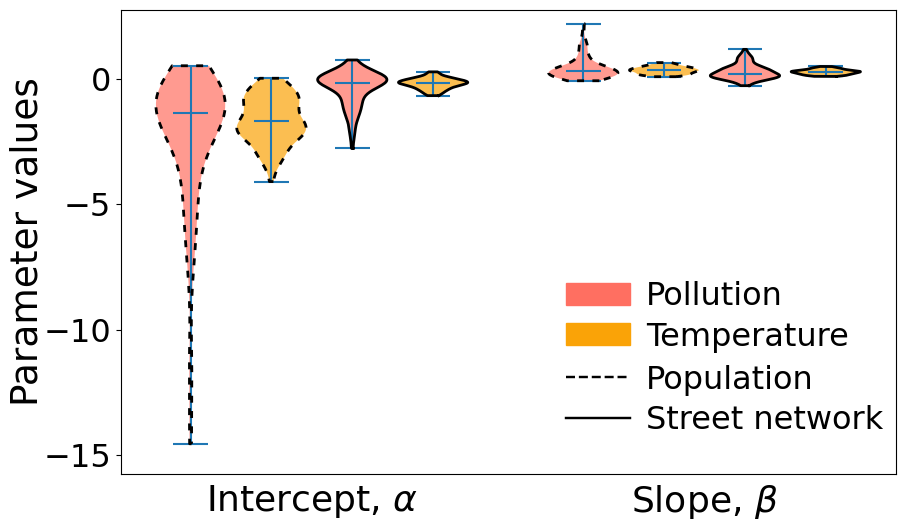

In [68]:
def filter_outliers(data, lower_percentile=5, upper_percentile=95):
    data_array = np.array(data)
    lower_bound = np.percentile(data_array, lower_percentile)
    upper_bound = np.percentile(data_array, upper_percentile)
    return data_array[(data_array >= lower_bound) & (data_array <= upper_bound)].tolist()

# Aplicar el filtro a cada conjunto de datos:
ALPHAs_popu    = filter_outliers(ALPHAs_popu)
BETAs_popu     = filter_outliers(BETAs_popu)
ALPHAs_popu_T  = filter_outliers(ALPHAs_popu_T)
BETAs_popu_T   = filter_outliers(BETAs_popu_T)
ALPHAs_node    = filter_outliers(ALPHAs_node)
BETAs_node     = filter_outliers(BETAs_node)
ALPHAs_node_T  = filter_outliers(ALPHAs_node_T)
BETAs_node_T   = filter_outliers(BETAs_node_T)

data = [
    ALPHAs_popu,    ALPHAs_popu_T,    ALPHAs_node,    ALPHAs_node_T,
    BETAs_popu,     BETAs_popu_T,     BETAs_node,     BETAs_node_T
]

# Define positions for 8 violins
positions = [0.2, 0.55, 0.9, 1.25, 1.9, 2.25, 2.6, 2.95]

# Colors: un color para PM y otro para Temperature, repetido para intercepts y slopes.
violin_colors = ['#ff6f61', '#faa307'] * 4

# --- Create the violin plot ---
fig, ax = plt.subplots(figsize=(10, 8))
parts = ax.violinplot(data, positions=positions, widths=0.3, showmedians=True)

# Personalizar la apariencia de cada violín:
for i, body in enumerate(parts['bodies']):
    body.set_facecolor(violin_colors[i])
    body.set_alpha(0.7)
    
    # Para los coeficientes basados en población (índices 0, 1, 4, 5): contornos de líneas discontinuas.
    if i in [0, 1, 4, 5]:
        body.set_edgecolor('none')
        for path in body.get_paths():
            vertices = path.vertices
            ax.plot(vertices[:, 0], vertices[:, 1],
                    linestyle=(0, (2.5, 3)), color='black', linewidth=2)
    else:
        # Para los coeficientes basados en la red vial (índices 2, 3, 6, 7): contornos de líneas sólidas.
        body.set_edgecolor('none')
        for path in body.get_paths():
            vertices = path.vertices
            ax.plot(vertices[:, 0], vertices[:, 1],
                    linestyle='-', color='black', linewidth=2)

import matplotlib.patches as mpatches
from matplotlib.lines import Line2D

# --- Handles predefinidos ---
legend1_handles = [
    mpatches.Patch(color='#ff6f61', label='Pollution'),
    mpatches.Patch(color='#faa307', label='Temperature')
]
pop_handle = Line2D([0], [0], color='black', lw=1.75, linestyle='--', label='Population')
sn_handle  = Line2D([0], [0], color='black', lw=1.75, linestyle='-',  label='Street network')

# --- Parámetro de posición horizontal en coordenadas de axes ---
x_legend = 0.55

# --- Leyenda 1 (Pollution vs Temperature) ---
legend1 = ax.legend(
    handles=legend1_handles,
    loc='lower left',                      # ancla la esquina inf‑izq de la caja de leyenda
    bbox_to_anchor=(x_legend, 0.22),       # dentro del axes: x=0.98, y=0.22
    bbox_transform=ax.transAxes,
    fontsize=23,
    frameon=False,                         # sin fondo ni borde
    borderpad=0.1,                         # padding interno muy pequeño
    handletextpad=0.5,                     # espacio entre marcador y texto
    labelspacing=0.3,                      # espacio vertical entre entradas
    columnspacing=1                        # espacio horizontal (no usado aquí)
)
# Alineación interna
legend1._legend_box.align = "left"
for txt in legend1.get_texts():
    txt.set_ha('left')
ax.add_artist(legend1)


# --- Leyenda 2 (Population vs Street Network) ---
legend2 = ax.legend(
    handles=[pop_handle, sn_handle],
    loc='lower left',
    bbox_to_anchor=(x_legend, 0.04),       # misma x, pero y=0.05
    bbox_transform=ax.transAxes,
    fontsize=23,
    frameon=False,
    borderpad=0.1,
    handlelength=2,
    handletextpad=0.5,
    labelspacing=0.3,
    columnspacing=1
)
legend2._legend_box.align = "left"
for txt in legend2.get_texts():
    txt.set_ha('left')
    
# --- Configuración de ejes ---
ax.set_ylabel('Parameter values', fontsize=27, labelpad=-2)
ax.set_ylim(-15.75, 2.75)
plt.yticks([-15,-10, -5, 0], fontsize=23)

# Eliminar los labels por defecto en el eje X
ax.set_xticks([])

# Calcular posiciones centrales para los grupos (labels del eje X)
subgroup_center_1 = (0.2 + 0.55) / 2 - 0.025   # Intercept: Population (izquierda)
subgroup_center_2 = (0.9 + 1.25) / 2 + 0.025     # Intercept: Street Network (derecha)
intercept_center = (subgroup_center_1 + subgroup_center_2) / 2

subgroup_center_3 = (1.9 + 2.25) / 2 - 0.025     # Slope: Population (izquierda)
subgroup_center_4 = (2.6 + 2.95) / 2 + 0.025     # Slope: Street Network (derecha)
slope_center = (subgroup_center_3 + subgroup_center_4) / 2

plt.subplots_adjust(bottom=0.3)
ax.text(intercept_center, -0.02, r'Intercept, $\alpha$', ha='center', va='top',
        transform=ax.get_xaxis_transform(), fontsize=26)
ax.text(slope_center, -0.02, r'Slope, $\beta$', ha='center', va='top',
        transform=ax.get_xaxis_transform(), fontsize=26)

plt.savefig('node_population_parameter_comparison_PM' + PM + '_T_' + size + '.svg', format='svg', dpi=600, bbox_inches='tight')

plt.show()


Filtered out Dakar (Cluster 3, PM, pop): alpha = -33.558059103344554
Filtered out Ho_Chi_Minh (Cluster 3, PM, pop): alpha = -22.56949363827552
Filtered out Dhaka (Cluster 3, PM, pop): alpha = -35.740652782365615
Filtered out Medina (Cluster 3, PM, pop): alpha = -80.6845707560329
Filtered out Sofia (Cluster 3, Temp, pop): alpha = -15.969008055440954
Filtered out Medina (Cluster 3, Temp, pop): alpha = -29.999060341432884
Filtered out Buenos_Aires (Cluster 3, PM, node): alpha = 5.002558433196184
Filtered out Dhaka (Cluster 3, PM, node): alpha = -7.490711113748627
Filtered out Lima (Cluster 3, PM, node): alpha = 6.346510742215251


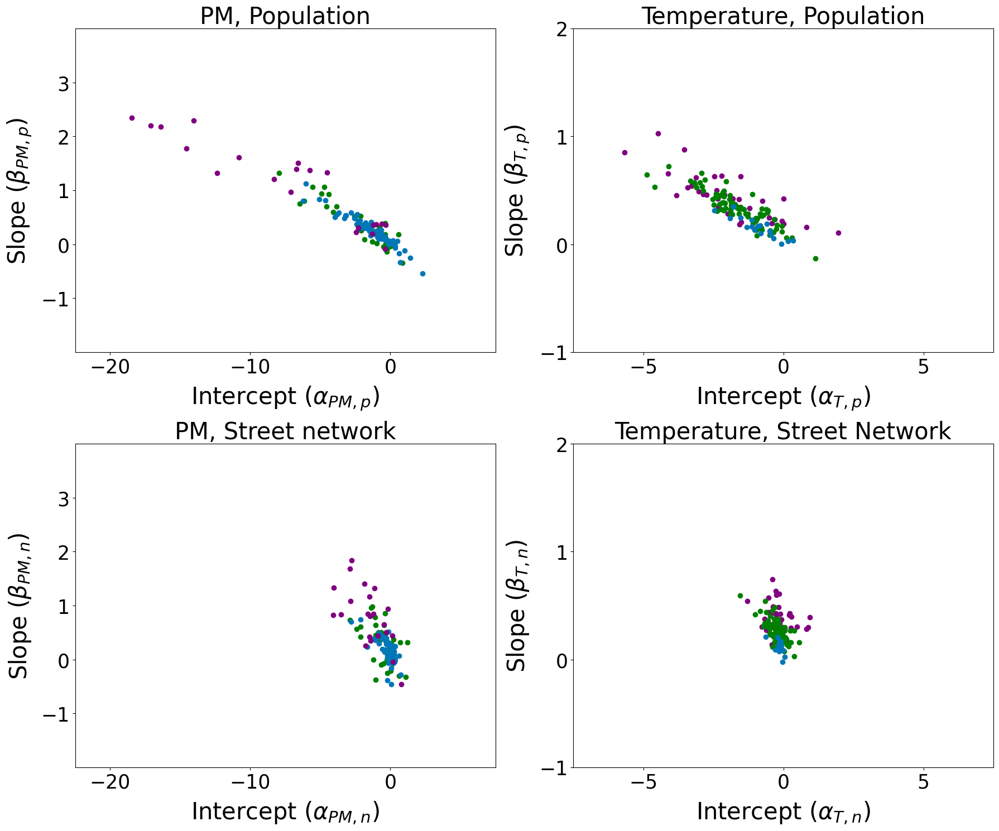

In [68]:
fig, axes = plt.subplots(2, 2, figsize=(18, 15))
tick_params = dict(axis='both', labelsize=25)

# --- Subplot 1: PM, Population (using clusters_PM) ---
ax = axes[0, 0]
for cluster_id, city_list in clusters_PM.items():
    alphas = []
    betas = []
    for city in city_list:
        coef = coefficients_p_PM_dic.get(city)
        if coef is not None and not coef.empty:
            alpha = coef['intersection'].iloc[0]
            beta  = coef['slope'].iloc[0]
            if np.isnan(alpha) or np.isnan(beta):
                print(f"Missing data for {city} (Cluster {cluster_id}, PM, pop).")
            else:
                # Keep only if -20 <= alpha <= 5
                if -20 <= alpha <= 5:
                    alphas.append(alpha)
                    betas.append(beta)
                else:
                    print(f"Filtered out {city} (Cluster {cluster_id}, PM, pop): alpha = {alpha}")
        else:
            print(f"No coefficient data for {city} (Cluster {cluster_id}, PM, pop).")
    ax.scatter(alphas, betas, color=cluster_colors[cluster_id], label=f'Cluster {cluster_id}', alpha=1)
ax.set_xlabel(r'Intercept $(\alpha_{PM,p})$', fontsize=30, labelpad=10)
ax.set_ylabel(r'Slope $(\beta_{PM,p})$', fontsize=30, labelpad=10)
ax.set_xlim(-22.5, 7.5)
ax.set_ylim(-2, 4)
ax.set_xticks([-20, -10, 0])
ax.set_yticks([-1, 0, 1, 2, 3])
ax.tick_params(**tick_params)
ax.set_title('PM, Population', fontsize=30)

# --- Subplot 2: Temperature, Population (using clusters_T) ---
ax = axes[0, 1]
for cluster_id, city_list in clusters_T.items():
    alphas = []
    betas = []
    for city in city_list:
        coef = coefficients_p_T_dic.get(city)
        if coef is not None and not coef.empty:
            alpha = coef['intersection'].iloc[0]
            beta  = coef['slope'].iloc[0]
            if np.isnan(alpha) or np.isnan(beta):
                print(f"Missing data for {city} (Cluster {cluster_id}, Temp, pop).")
            else:
                # Keep only if alpha >= -15
                if alpha >= -15:
                    alphas.append(alpha)
                    betas.append(beta)
                else:
                    print(f"Filtered out {city} (Cluster {cluster_id}, Temp, pop): alpha = {alpha}")
        else:
            print(f"No coefficient data for {city} (Cluster {cluster_id}, Temp, pop).")
    ax.scatter(alphas, betas, color=cluster_colors[cluster_id], label=f'Cluster {cluster_id}', alpha=1)
ax.set_xlabel(r'Intercept $(\alpha_{T,p})$', fontsize=30, labelpad=10)
ax.set_ylabel(r'Slope $(\beta_{T,p})$', fontsize=30, labelpad=10)
ax.set_xlim(-7.5, 7.5)
ax.set_ylim(-1, 2)
ax.set_xticks([-5, 0, 5])
ax.set_yticks([-1, 0, 1, 2])
ax.tick_params(**tick_params)
# ax.legend(fontsize=22)
ax.set_title('Temperature, Population', fontsize=30)

# --- Subplot 3: PM, Node (using clusters_PM) ---
ax = axes[1, 0]
for cluster_id, city_list in clusters_PM.items():
    alphas = []
    betas = []
    for city in city_list:
        coef = coefficients_PM_dic.get(city)
        if coef is not None and not coef.empty:
            alpha = coef['intersection'].iloc[0]
            beta  = coef['slope'].iloc[0]
            if np.isnan(alpha) or np.isnan(beta):
                print(f"Missing data for {city} (Cluster {cluster_id}, PM, node).")
            else:
                # Filter out PM, node: remove if alpha is close to -7.490711113748627 and keep only if -20 <= alpha <= 5
                if (not np.isclose(alpha, -7.490711113748627, atol=1e-8)) and (-20 <= alpha <= 5):
                    alphas.append(alpha)
                    betas.append(beta)
                else:
                    print(f"Filtered out {city} (Cluster {cluster_id}, PM, node): alpha = {alpha}")
        else:
            print(f"No coefficient data for {city} (Cluster {cluster_id}, PM, node).")
    ax.scatter(alphas, betas, color=cluster_colors[cluster_id], label=f'Cluster {cluster_id}', alpha=1)
ax.set_xlabel(r'Intercept $(\alpha_{PM,n})$', fontsize=30, labelpad=10)
ax.set_ylabel(r'Slope $(\beta_{PM,n})$', fontsize=30, labelpad=10)
ax.set_xlim(-22.5, 7.5)
ax.set_ylim(-2, 4)
ax.set_xticks([-20, -10, 0])
ax.set_yticks([-1, 0, 1, 2, 3])
ax.tick_params(**tick_params)
ax.set_title('PM, Street network', fontsize=30)

# --- Subplot 4: Temperature, Node (using clusters_T) ---
ax = axes[1, 1]
for cluster_id, city_list in clusters_T.items():
    alphas = []
    betas = []
    for city in city_list:
        coef = coefficients_T_dic.get(city)
        if coef is not None and not coef.empty:
            alpha = coef['intersection'].iloc[0]
            beta  = coef['slope'].iloc[0]
            if np.isnan(alpha) or np.isnan(beta):
                print(f"Missing data for {city} (Cluster {cluster_id}, Temp, node).")
            else:
                # No additional filtering for Temperature, node coefficients
                alphas.append(alpha)
                betas.append(beta)
        else:
            print(f"No coefficient data for {city} (Cluster {cluster_id}, Temp, node).")
    ax.scatter(alphas, betas, color=cluster_colors[cluster_id], label=f'Cluster {cluster_id}', alpha=1)
ax.set_xlabel(r'Intercept $(\alpha_{T,n})$', fontsize=30, labelpad=10)
ax.set_ylabel(r'Slope $(\beta_{T,n})$', fontsize=30, labelpad=10)
ax.set_xlim(-7.5, 7.5)
ax.set_ylim(-1, 2)
ax.set_xticks([-5, 0, 5])
ax.set_yticks([-1, 0, 1, 2])
ax.tick_params(**tick_params)
ax.set_title('Temperature, Street Network', fontsize=30)

plt.tight_layout()
# plt.savefig('alpha_vs_slope.svg', format='svg', dpi=600, bbox_inches='tight')
plt.show()
